In [1]:
import pyscamp # Uses GPU if available and CUDA was available during the build

# Allows checking if pyscamp was built with CUDA and has GPU support
has_gpu_support = pyscamp.gpu_supported()

# # Self join
# profile, index = mp.selfjoin(a, sublen)
# # AB join using 4 threads
# profile, index = mp.abjoin(a, b, sublen, threads=4)
# # Sum thresh
# corr_sum = mp.abjoin_sum(a, b, sublen, threshold=0.9)

In [1]:
# Imports
from obspy import read, UTCDateTime, Stream
import os
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import time

In [3]:
wf_dir = "/home/gilbert_lab/cami_frs/hawk_data/sac_data_corrected/Jan-Feb2020_sac_daily_250Hz/"
station = "C0202"
tday = UTCDateTime(2020,3,10,0,0,0)

In [90]:
st = read(os.path.join(wf_dir,station,"*%s*" % tday.strftime("%Y%m%d")))
st.decimate(factor=2)
st.filter("lowpass", freq=20)
dataN = st[0].data*1e9
dataE = st[1].data*1e9
dataZ = st[2].data*1e9
fs = st[0].stats.sampling_rate

In [91]:
sublen_sec = 10
sublen_samp = int(sublen_sec * fs)
start = time.time()
mpN, indexN = pyscamp.selfjoin(dataN, sublen_samp, gpus=[0,1], pearson=True)
mpE, indexE = pyscamp.selfjoin(dataE, sublen_samp, gpus=[0,1], pearson=True)
mpZ, indexZ = pyscamp.selfjoin(dataZ, sublen_samp, gpus=[0,1], pearson=True)
end = time.time()
print("Time elapsed: %f" % (end-start))

Time elapsed: 531.609275


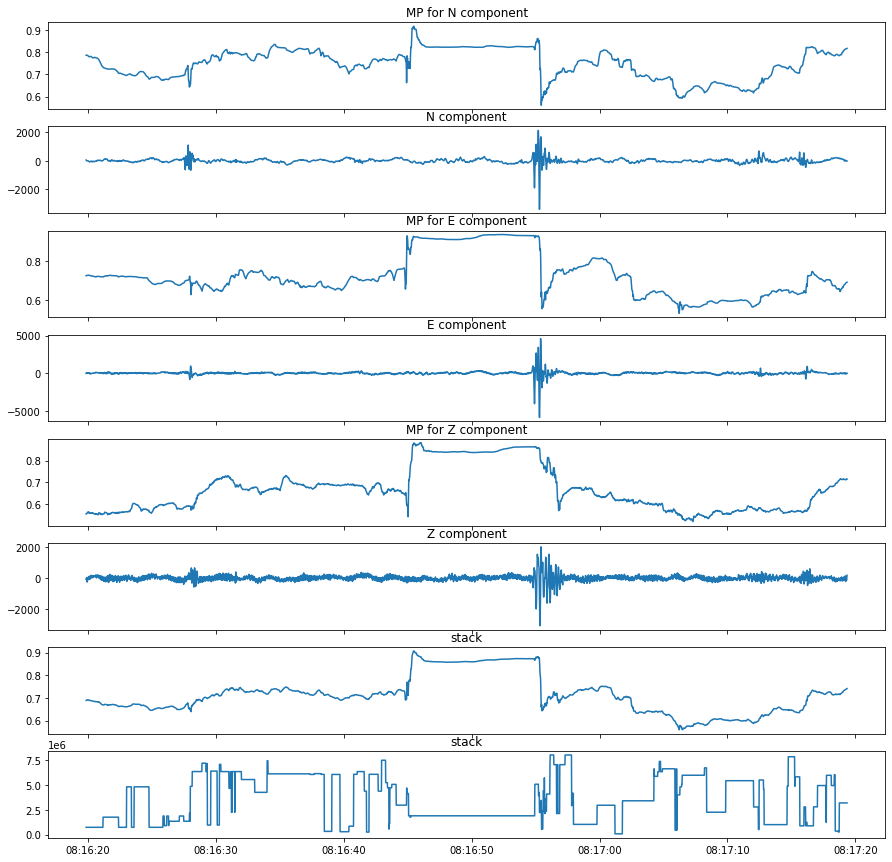

In [96]:
stack = (mpN + mpE + mpZ)/3
tstart = 30050 -30
tend = tstart + 60
istart = tstart*int(fs)
iend = tend*int(fs)
t = st[0].times("matplotlib")
t = t[0:-(sublen_samp-1)]

fig, axs = plt.subplots(8,1,figsize=(15,15), sharex=True)
axs[0].plot_date(t[istart:iend], mpN[istart:iend], marker=None, linestyle="-")
axs[0].set_title("MP for N component")
axs[1].plot_date(t[istart:iend], dataN[istart:iend], marker=None, linestyle="-")
axs[1].set_title("N component")
axs[2].plot_date(t[istart:iend], mpE[istart:iend], marker=None, linestyle="-")
axs[2].set_title("MP for E component")
axs[3].plot_date(t[istart:iend], dataE[istart:iend], marker=None, linestyle="-")
axs[3].set_title("E component")
axs[4].plot_date(t[istart:iend], mpZ[istart:iend], marker=None, linestyle="-")
axs[4].set_title("MP for Z component")
axs[5].plot_date(t[istart:iend], dataZ[istart:iend], marker=None, linestyle="-")
axs[5].set_title("Z component")
axs[6].plot_date(t[istart:iend], stack[istart:iend], marker=None, linestyle="-")
axs[6].set_title("stack")
axs[7].plot_date(t[istart:iend], indexN[istart:iend], marker=None, linestyle="-")
axs[7].set_title("stack")
plt.show()

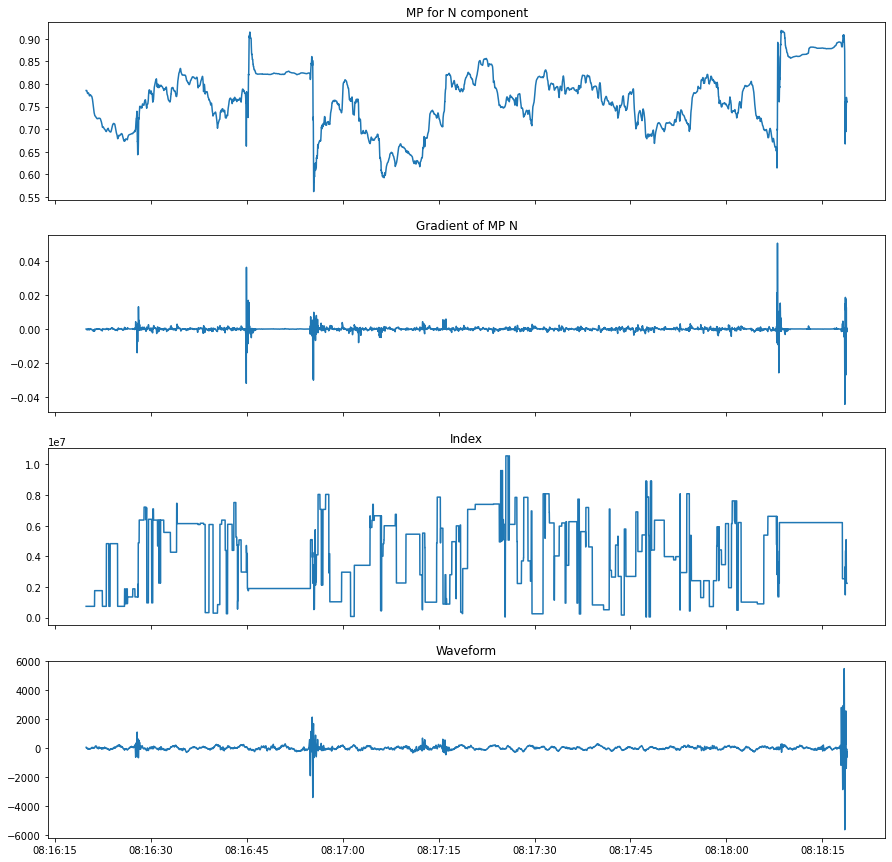

In [104]:
stack = (mpN + mpE + mpZ)/3
tstart = 30050 -30
tend = tstart + 120
istart = tstart*int(fs)
iend = tend*int(fs)
t = st[0].times("matplotlib")
t = t[0:-(sublen_samp-1)]

gradN = np.gradient(mpN)

fig, axs = plt.subplots(4,1,figsize=(15,15), sharex=True)
axs[0].plot_date(t[istart:iend], mpN[istart:iend], marker=None, linestyle="-")
axs[0].set_title("MP for N component")
gradN = np.gradient(mpN)
axs[1].plot_date(t[istart:iend], gradN[istart:iend], marker=None, linestyle="-")
axs[1].set_title("Gradient of MP N")
axs[2].plot_date(t[istart:iend], indexN[istart:iend], marker=None, linestyle="-")
axs[2].set_title("Index")
axs[3].plot_date(t[istart:iend], dataN[istart:iend], marker=None, linestyle="-")
axs[3].set_title("Waveform")
plt.show()

In [107]:
# For 3 days
# st = Stream()
# st.append(read(os.path.join(wf_dir,station,"*DPZ*20200309*"))[0])
# st.append(read(os.path.join(wf_dir,station,"*DPZ*20200310*"))[0])
# st.append(read(os.path.join(wf_dir,station,"*DPZ*20200311*"))[0])
# st.merge(method=1, fill_value='interpolate')
# st.decimate(factor=2)
# st.filter("lowpass", freq=60)
# dataZ_3days = st[0].data*1e9
# fs = st[0].stats.sampling_rate
# sublen_sec = 10
# sublen_samp = int(sublen_sec * fs)
# start = time.time()
# mpZ_3days, indexZ_3days = pyscamp.selfjoin(dataZ_3days, sublen_samp, gpus=[0,1,2,3], 
#                                            pearson=True, precision="single")
# end = time.time()
# print("Time elapsed: %f" % (end-start))

st = Stream()
st.append(read(os.path.join(wf_dir,station,"*DP1*20200309*"))[0])
st.append(read(os.path.join(wf_dir,station,"*DP1*20200310*"))[0])
st.append(read(os.path.join(wf_dir,station,"*DP1*20200311*"))[0])
st.merge(method=1, fill_value='interpolate')
st.decimate(factor=2)
st.filter("lowpass", freq=60)
data1_3days = st[0].data*1e9
fs = st[0].stats.sampling_rate
sublen_sec = 10
sublen_samp = int(sublen_sec * fs)
start = time.time()
mp1_3days, index1_3days = pyscamp.selfjoin(data1_3days, sublen_samp, gpus=[0,1,2,3], 
                                           pearson=True, precision="single")
end = time.time()
print("Time elapsed: %f" % (end-start))

st = Stream()
st.append(read(os.path.join(wf_dir,station,"*DP2*20200309*"))[0])
st.append(read(os.path.join(wf_dir,station,"*DP2*20200310*"))[0])
st.append(read(os.path.join(wf_dir,station,"*DP2*20200311*"))[0])
st.merge(method=1, fill_value='interpolate')
st.decimate(factor=2)
st.filter("lowpass", freq=60)
data2_3days = st[0].data*1e9
fs = st[0].stats.sampling_rate
sublen_sec = 10
sublen_samp = int(sublen_sec * fs)
start = time.time()
mp2_3days, index2_3days = pyscamp.selfjoin(data2_3days, sublen_samp, gpus=[0,1,2,3], 
                                           pearson=True, precision="single")
end = time.time()
print("Time elapsed: %f" % (end-start))

Time elapsed: 665.846113
Time elapsed: 662.193022


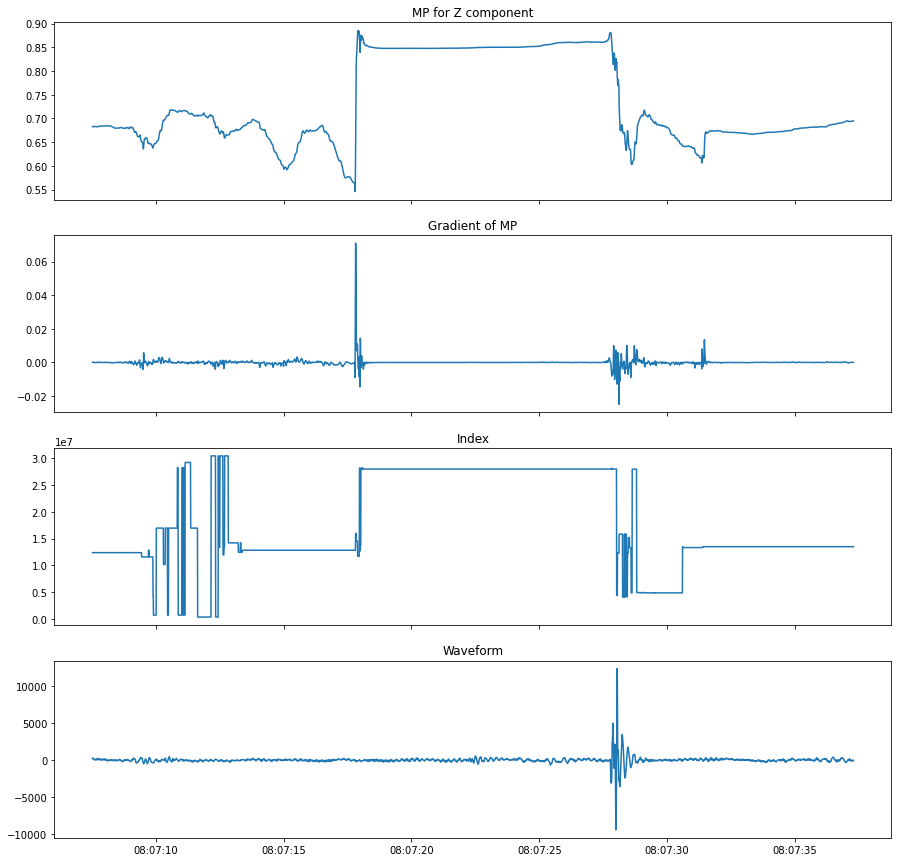

In [108]:
mpstack = (mp2_3days + mp1_3days + mpZ_3days) / 3

tstart = 3600*24 + 30050 + 110
tend = tstart + 30
istart = tstart*int(fs)
iend = tend*int(fs)
t = st[0].times("matplotlib")
t = t[0:-(sublen_samp-1)]

gradZ = np.gradient(mpstack)

fig, axs = plt.subplots(4,1,figsize=(15,15), sharex=True)
axs[0].plot_date(t[istart:iend], mpstack[istart:iend], marker=None, linestyle="-")
axs[0].set_title("MP for Z component")
axs[1].plot_date(t[istart:iend], gradZ[istart:iend], marker=None, linestyle="-")
axs[1].set_title("Gradient of MP")
axs[2].plot_date(t[istart:iend], indexZ_3days[istart:iend], marker=None, linestyle="-")
axs[2].set_title("Index")
axs[3].plot_date(t[istart:iend], dataZ_3days[istart:iend], marker=None, linestyle="-")
axs[3].set_title("Waveform")
plt.show()

2020-01-27T00:00:00.000000Z


In [30]:
import numpy as np
from obspy import Catalog
from obspy.core.event.base import Comment
from obspy.core.event.event import Event
from obspy.core.event.origin import Origin
from scipy.signal import find_peaks
import os
import time
import matplotlib.dates as mdates
from obspy import UTCDateTime

proc_start = time.time()
mp_dir = "/home/genevieve.savard/SCAMP/cami"
fname = "20200217_20200223_C0909.mp"
print("Starting detection extraction for file %s" % fname)
day1 = fname.split("_")[0]
daylast = fname.split("_")[1]
station = fname.split("_")[2].split(".")[0]

proc_start = time.time()

# Get matrix profile and time vector
mp_dir = "/home/genevieve.savard/SCAMP/cami"
mprof = np.loadtxt(os.path.join(mp_dir,"matrix_profiles", fname))
prefix = fname.split(".")[0]
t_plt = np.loadtxt(os.path.join(mp_dir,"matrix_profiles",prefix + ".time"))

# Detection
sublen_sec = 10
fs = 125.0
sublen_samp = int(sublen_sec * fs)
peaks, properties = find_peaks(mprof, height=(0.7,1),  width=(None, int(sublen_samp*1.2)), prominence=0.3 )

# Create catalogue
latwell = 50.45031  # coordinates of geophysics well
lonwell = -112.12087  # coordinates of geophysics well

cat = Catalog()
cat.description = [Comment(text="MP detection using 3 components of station %s, from %s to %s, window length of %d seconds." % (station, day1, daylast, sublen_sec)),
                  Comment(text="Peak detection params: height=(0.7,1), width=(None, int(sublen_samp*1.2)), prominence=0.3")]
print("Number of detections found: %d" % len(peaks))

for idx in range(0,len(peaks)):
    comm1 = Comment(text="Peak height %f" % properties["peak_heights"][idx])
    comm2 = Comment("Prominence = %f" % properties["prominences"][idx])
    comm3 = Comment("Width = %f" % properties["widths"][idx])

    otime = UTCDateTime(mdates.num2date(t_plt[peaks[idx]]))

    origin = Origin(time=otime, latitude=latwell, longitude=lonwell, evaluation_status="preliminary")
    event = Event(origins=[origin], comments=[comm1, comm2, comm3])
    cat += event
cat_fname = os.path.join(mp_dir, "detections", "scamp_detections_%s.xml" % prefix)
cat.write(cat_fname, format="QUAKEML")
print("Catalogue written to: %s" % cat_fname)
proc_end = time.time()
print("Detection and catalog building finished in %f seconds" % (proc_end - proc_start))

Starting detection extraction for file 20200217_20200223_C0909.mp
Number of detections found: 15
Catalogue written to: /home/genevieve.savard/SCAMP/cami/detections/scamp_detections_20200217_20200223_C0909.xml
Detection and catalog building finished in 497.692706 seconds


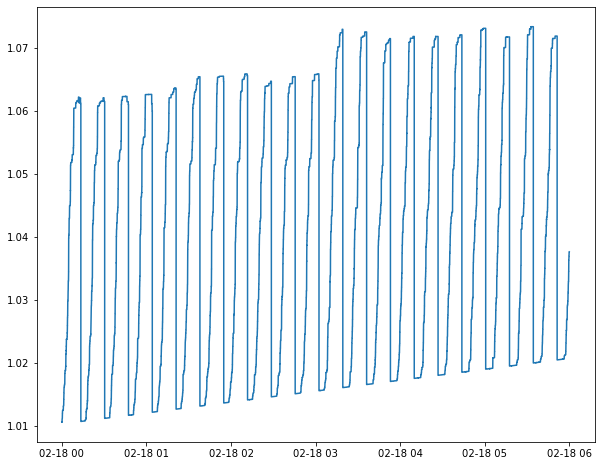

In [38]:
ips = 3600*125*24
ipe = ips + 3600*125*6
fig, axs = plt.subplots(1,1,figsize=(10,8), sharex=True)
axs.plot_date(t_plt[ips:ipe], mprof[ips:ipe], marker=None, linestyle="-")

Peak height = 0.973005
Prominence = 0.473802
Width = 1374.195199
Width height = 0.736104


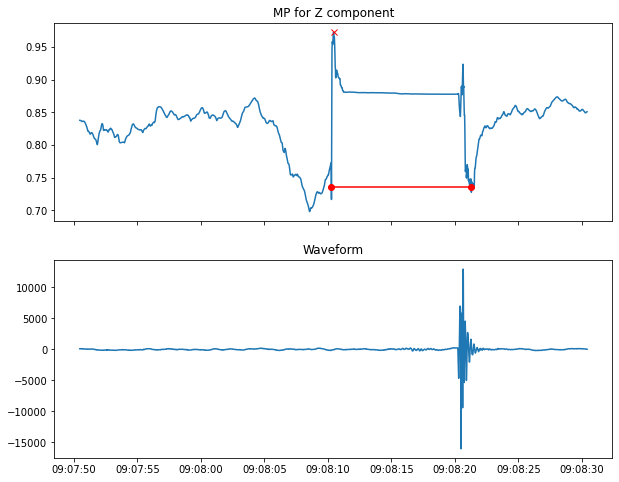

Peak height = 0.946563
Prominence = 0.321399
Width = 1307.858616
Width height = 0.785863


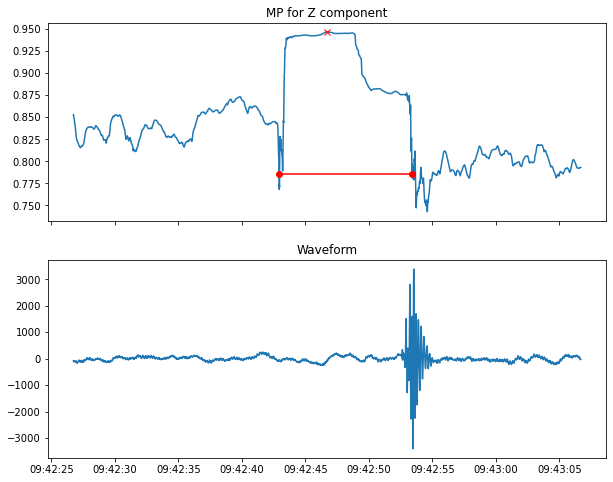

Peak height = 0.969652
Prominence = 0.346527
Width = 1279.838794
Width height = 0.796388


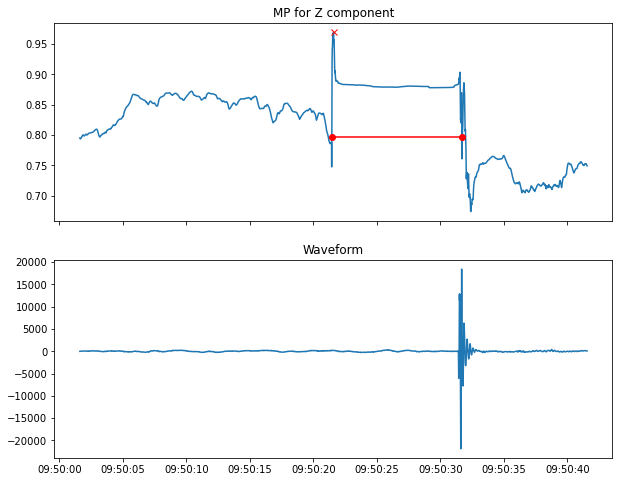

Peak height = 0.929256
Prominence = 0.311081
Width = 100.432822
Width height = 0.773716


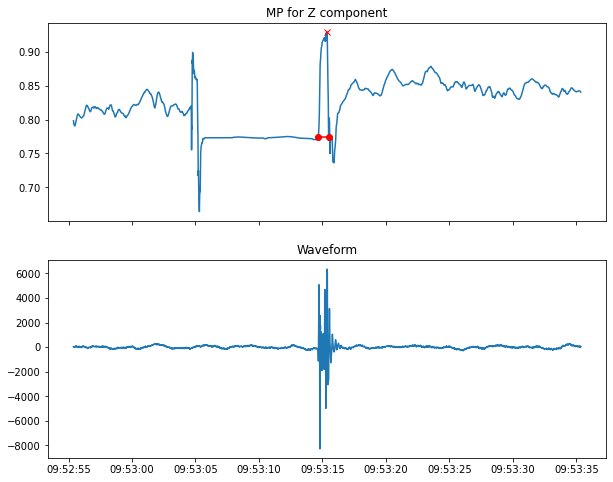

Peak height = 0.944781
Prominence = 0.346566
Width = 75.509703
Width height = 0.771497


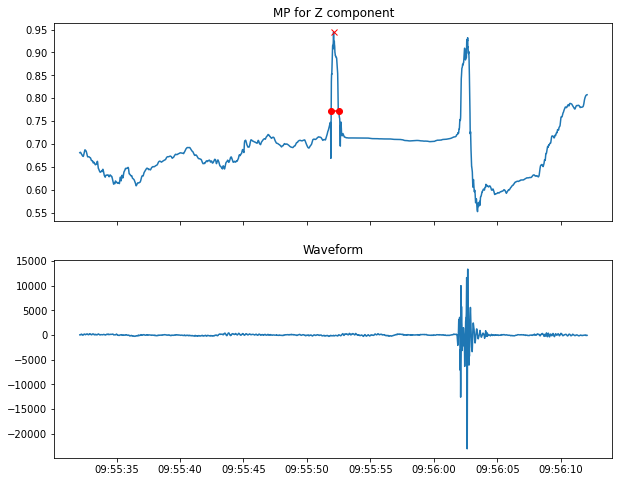

Peak height = 0.942529
Prominence = 0.388942
Width = 1375.524419
Width height = 0.748058


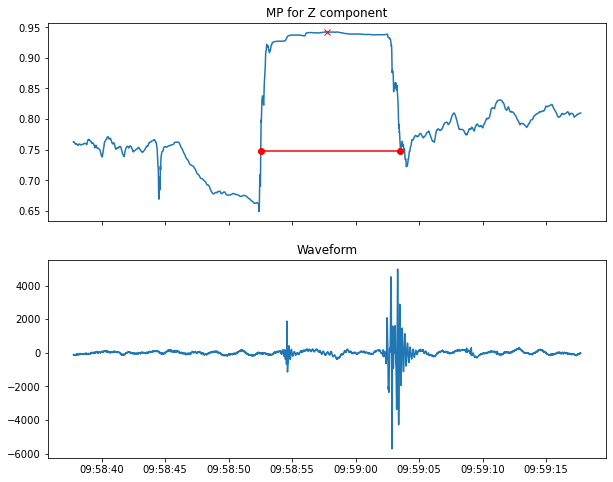

Peak height = 0.885283
Prominence = 0.331686
Width = 1288.321443
Width height = 0.719440


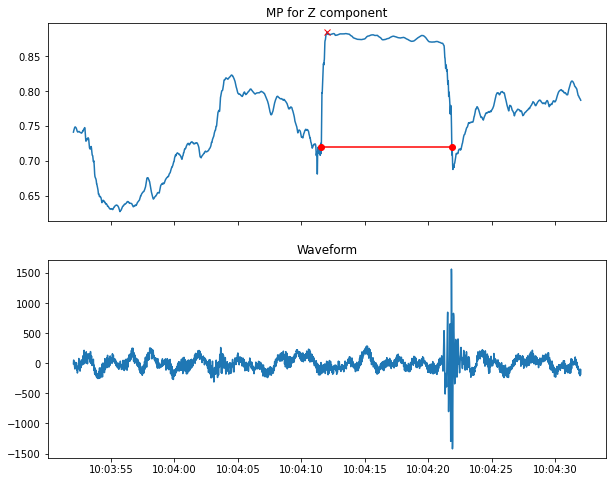

Peak height = 0.951327
Prominence = 0.338415
Width = 195.931097
Width height = 0.782120


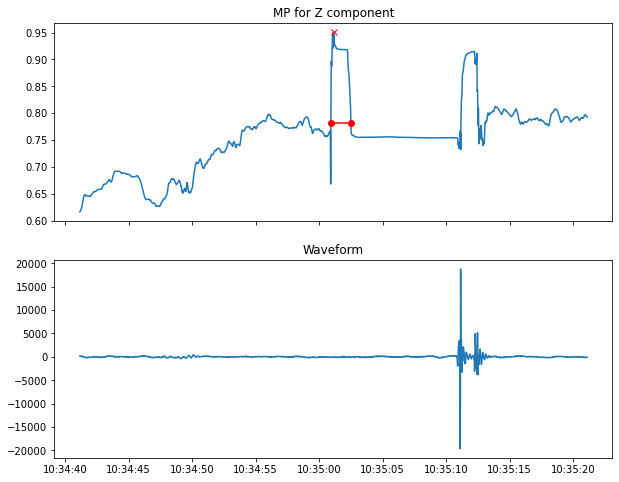

Peak height = 0.954889
Prominence = 0.374505
Width = 1406.386565
Width height = 0.767636


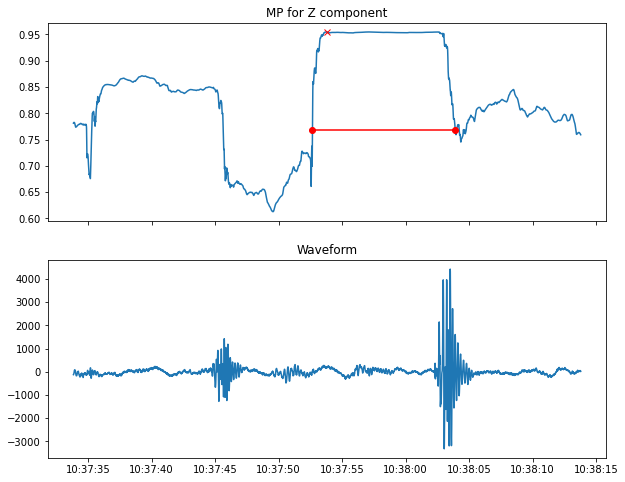

Peak height = 0.896456
Prominence = 0.305905
Width = 1354.029537
Width height = 0.743503


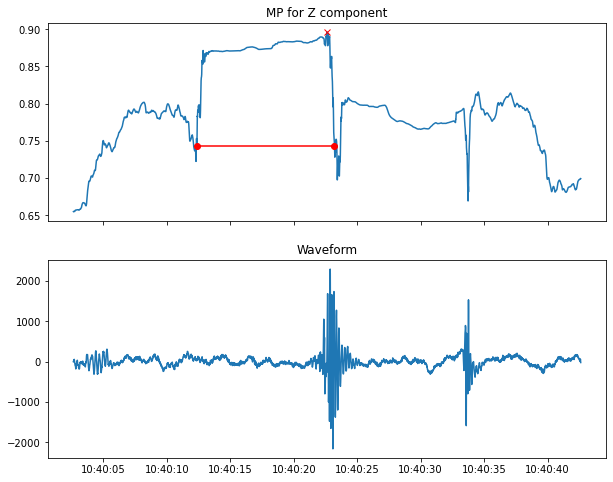

Peak height = 0.955464
Prominence = 0.389747
Width = 1305.635319
Width height = 0.760590


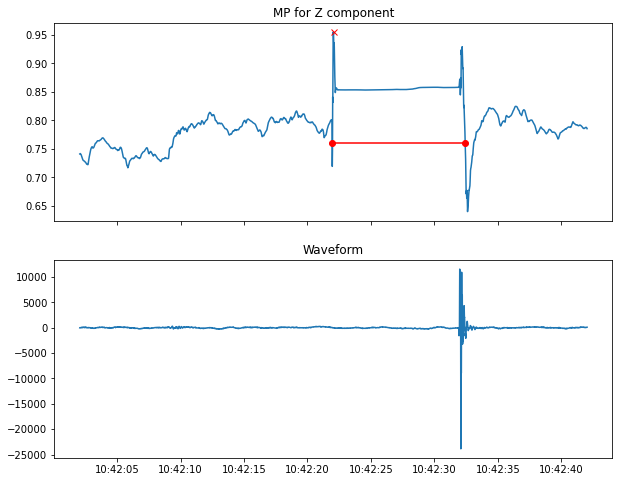

Peak height = 0.948489
Prominence = 0.308563
Width = 1291.285791
Width height = 0.794207


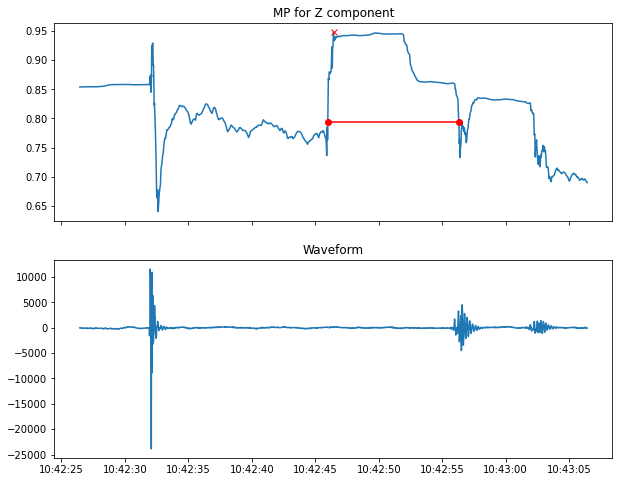

Peak height = 0.923580
Prominence = 0.321326
Width = 1335.427740
Width height = 0.762917


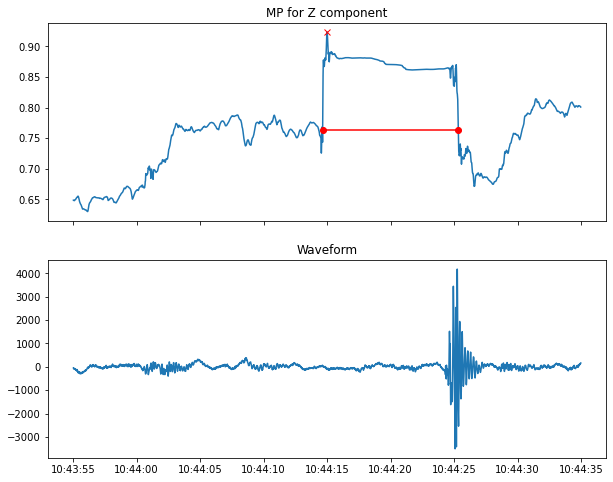

Peak height = 0.964759
Prominence = 0.412373
Width = 1304.917684
Width height = 0.758572


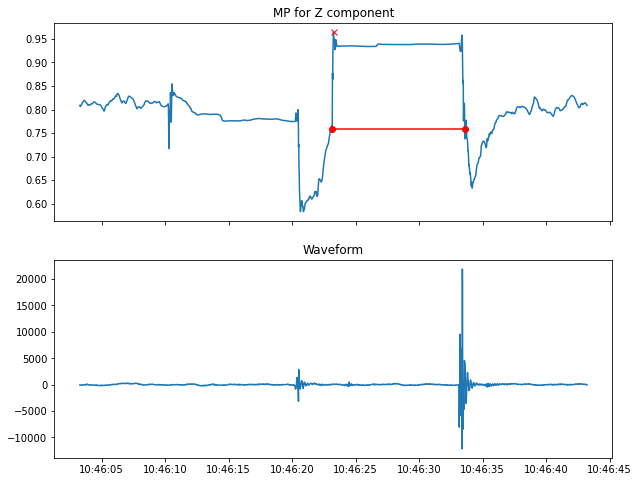

Peak height = 0.916455
Prominence = 0.311708
Width = 1359.036623
Width height = 0.760601


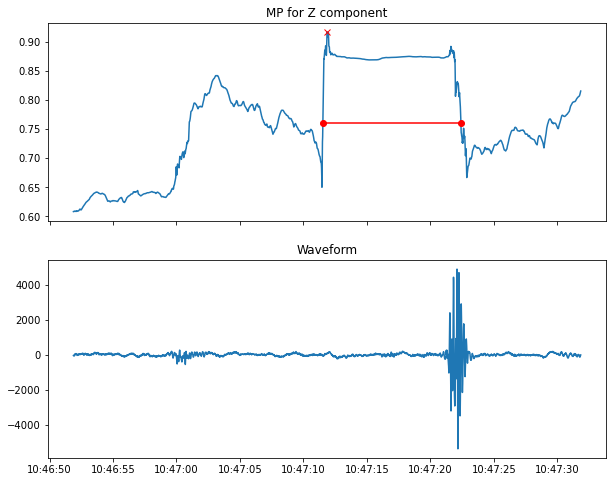

Peak height = 0.897294
Prominence = 0.320583
Width = 1300.662058
Width height = 0.737003


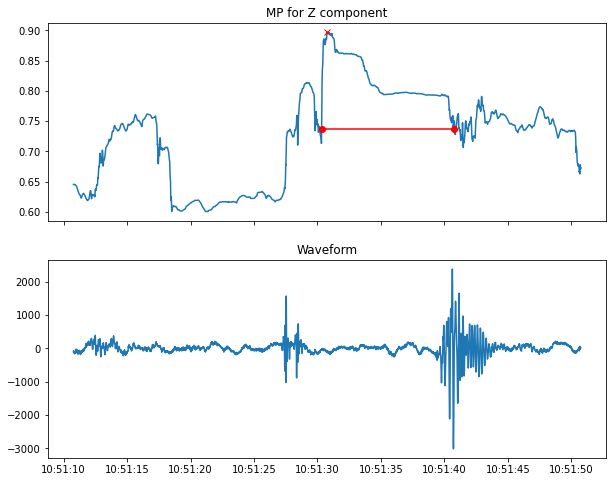

Peak height = 0.924513
Prominence = 0.354967
Width = 1264.681011
Width height = 0.747029


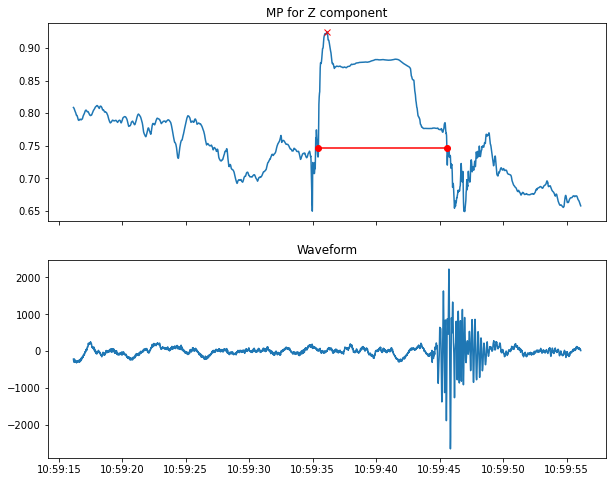

Peak height = 0.786676
Prominence = 0.302510
Width = 1312.954246
Width height = 0.635421


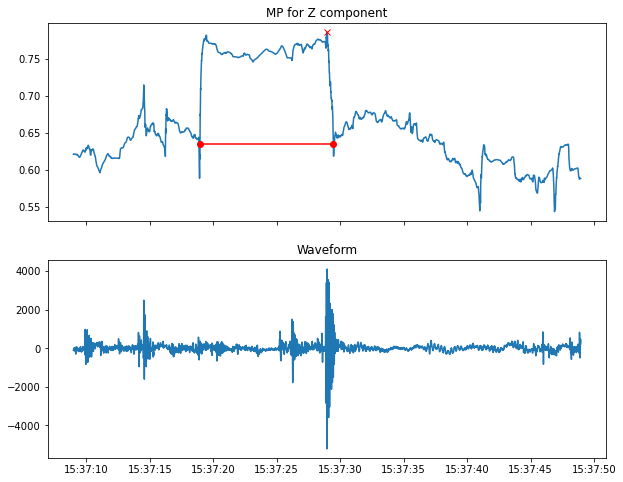

Peak height = 0.798025
Prominence = 0.447570
Width = 1279.655717
Width height = 0.574239


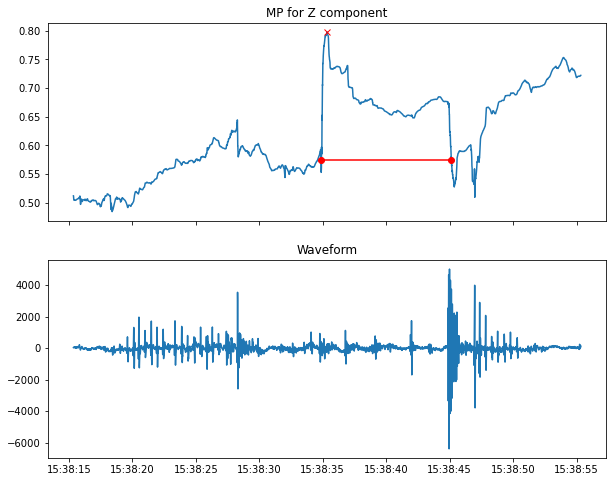

Peak height = 0.745167
Prominence = 0.390858
Width = 1312.657008
Width height = 0.549738


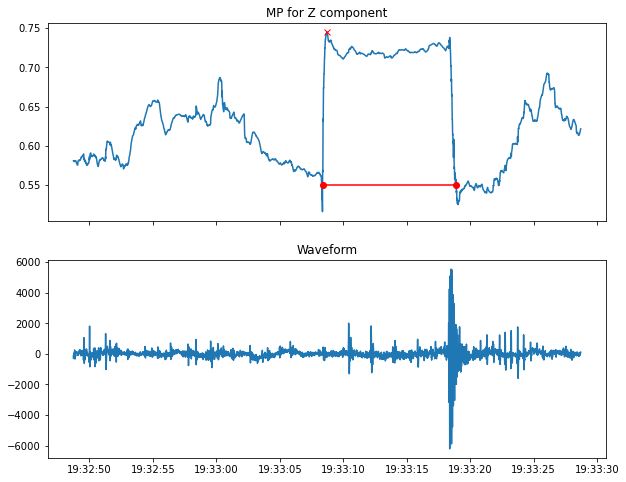

Peak height = 0.847366
Prominence = 0.309917
Width = 1190.857969
Width height = 0.692407


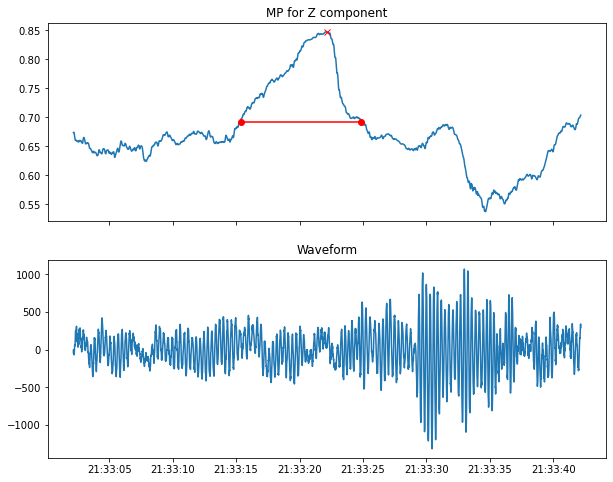

Peak height = 0.806248
Prominence = 0.360595
Width = 635.270062
Width height = 0.625951


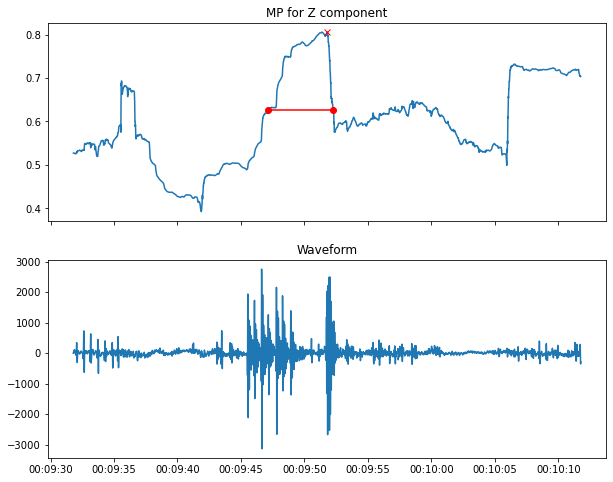

Peak height = 0.847279
Prominence = 0.376745
Width = 1367.258564
Width height = 0.658907


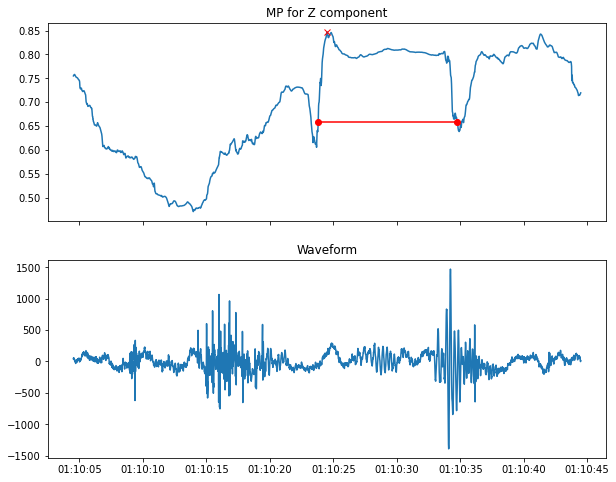

Peak height = 0.902872
Prominence = 0.473482
Width = 1347.353870
Width height = 0.666130


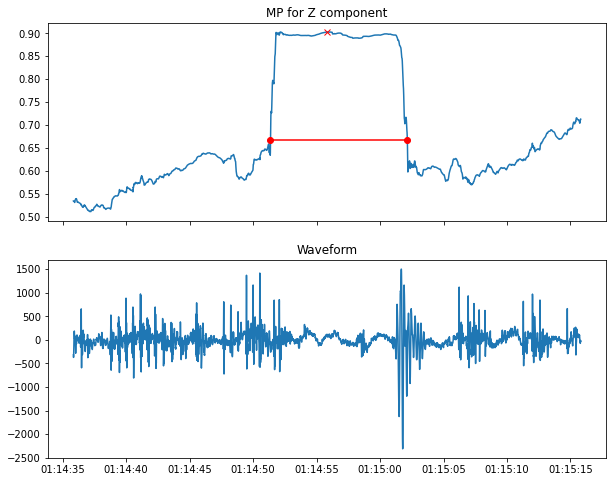

Peak height = 0.795242
Prominence = 0.377001
Width = 1295.019620
Width height = 0.606742


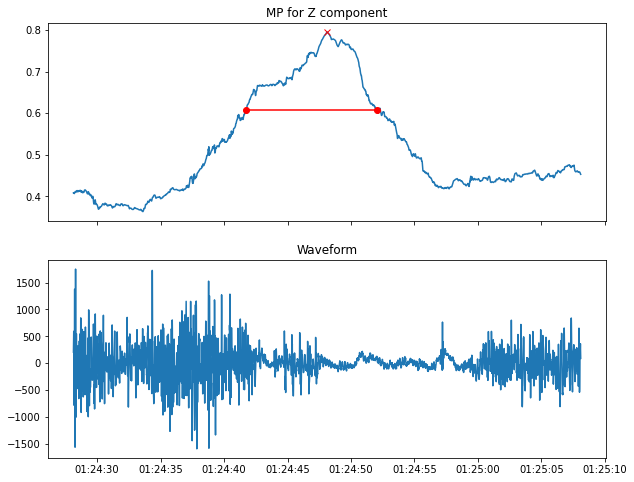

Peak height = 0.788469
Prominence = 0.363456
Width = 1287.697118
Width height = 0.606741


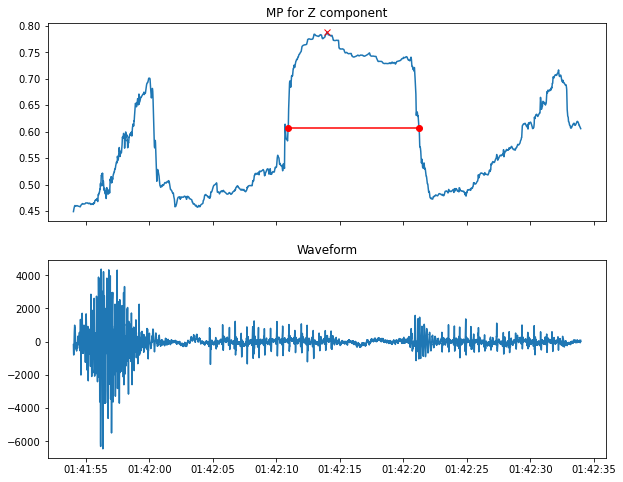

Peak height = 0.971737
Prominence = 0.424227
Width = 1337.606608
Width height = 0.759623


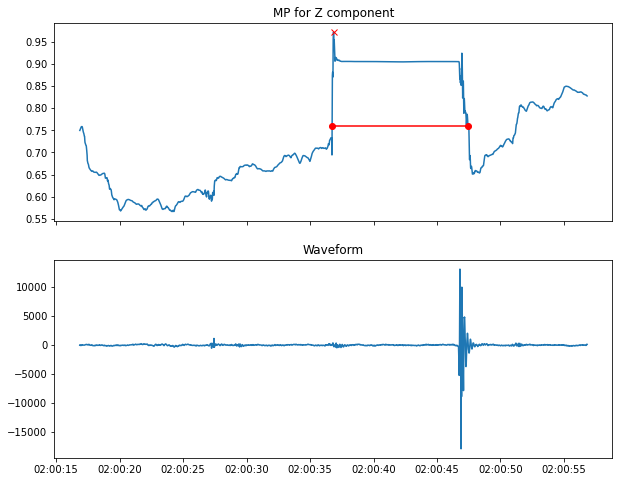

Peak height = 0.909577
Prominence = 0.301009
Width = 1333.947948
Width height = 0.759073


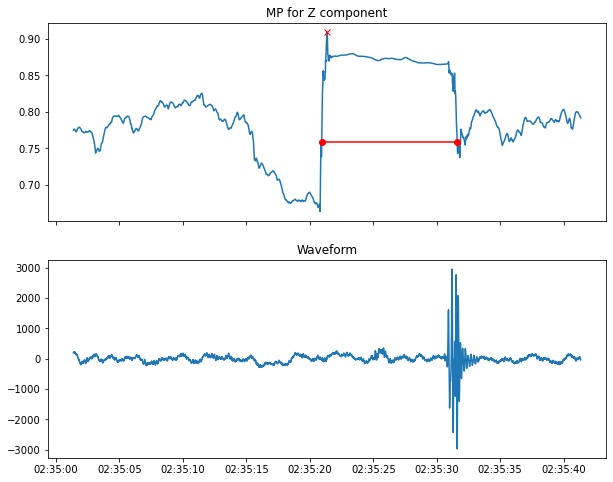

Peak height = 0.871417
Prominence = 0.304856
Width = 1292.881802
Width height = 0.718989


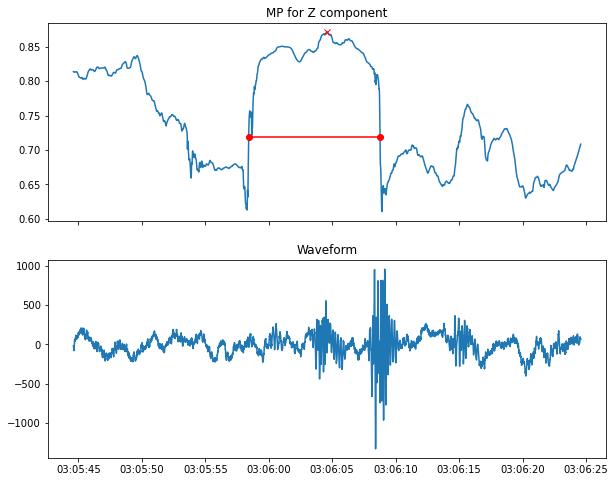

Peak height = 0.942736
Prominence = 0.377668
Width = 1275.167512
Width height = 0.753902


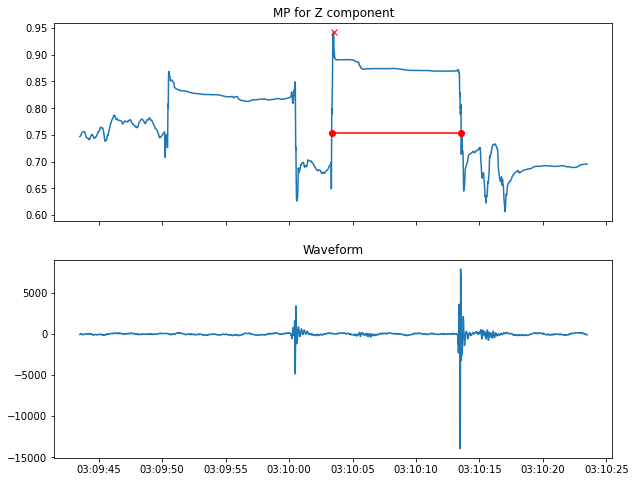

Peak height = 0.928593
Prominence = 0.347052
Width = 1343.968888
Width height = 0.755067


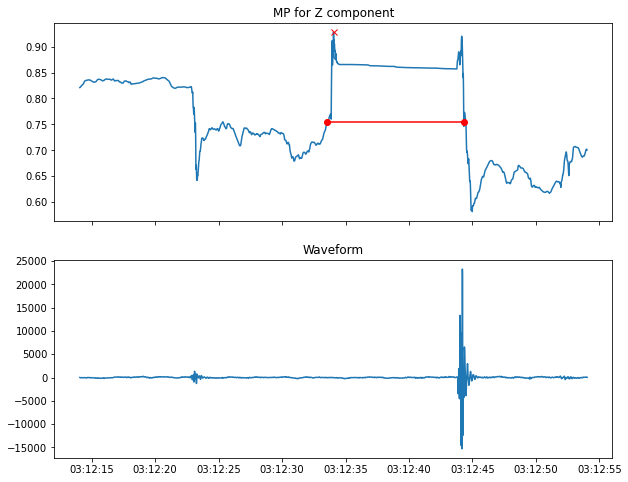

Peak height = 0.932367
Prominence = 0.386507
Width = 1261.871368
Width height = 0.739114


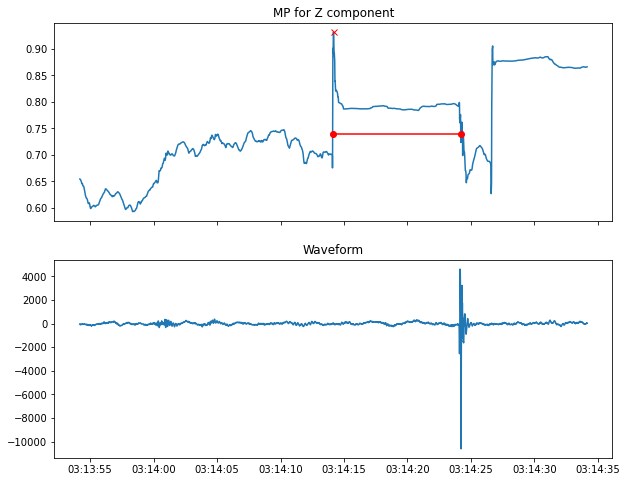

Peak height = 0.924513
Prominence = 0.401433
Width = 1259.497893
Width height = 0.723796


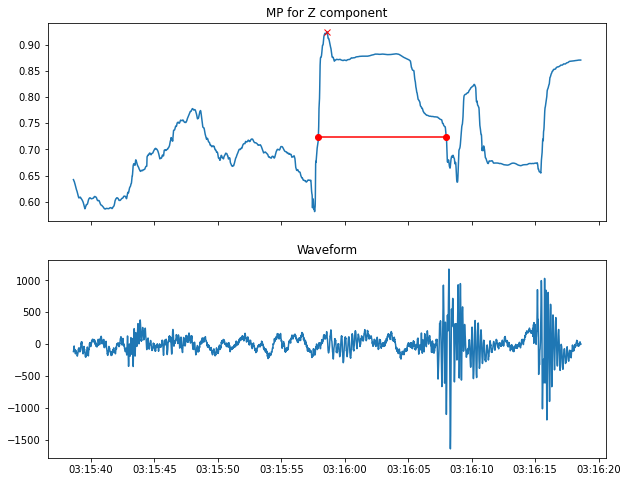

Peak height = 0.971033
Prominence = 0.477649
Width = 1381.385659
Width height = 0.732208


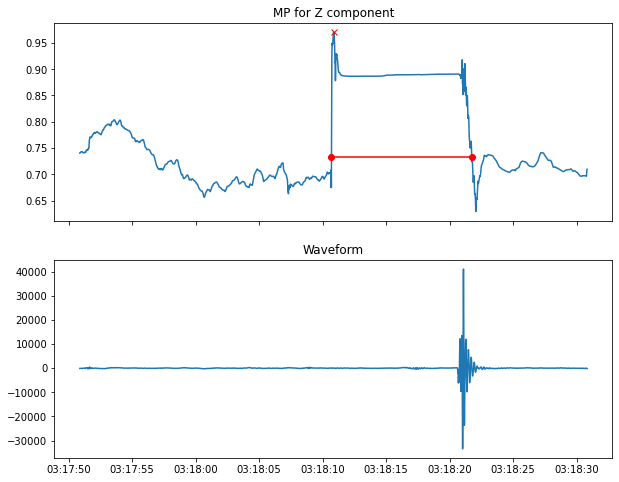

Peak height = 0.884986
Prominence = 0.361650
Width = 1262.171012
Width height = 0.704161


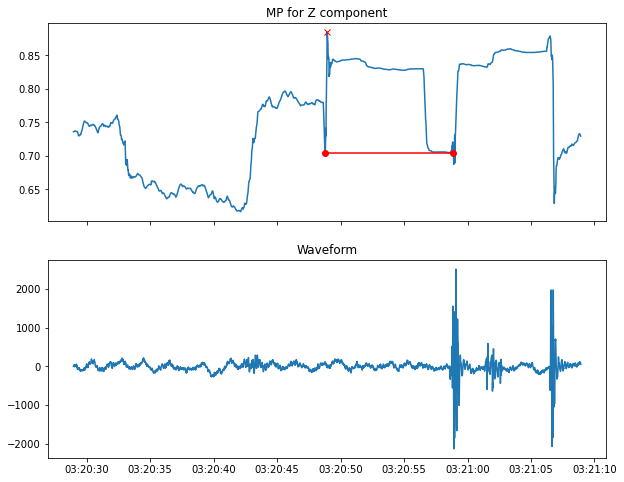

Peak height = 0.938270
Prominence = 0.423419
Width = 1312.501659
Width height = 0.726561


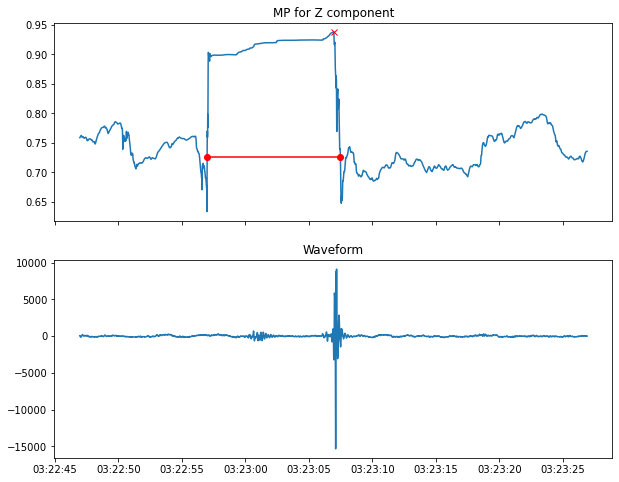

Peak height = 0.864681
Prominence = 0.312728
Width = 1374.796909
Width height = 0.708318


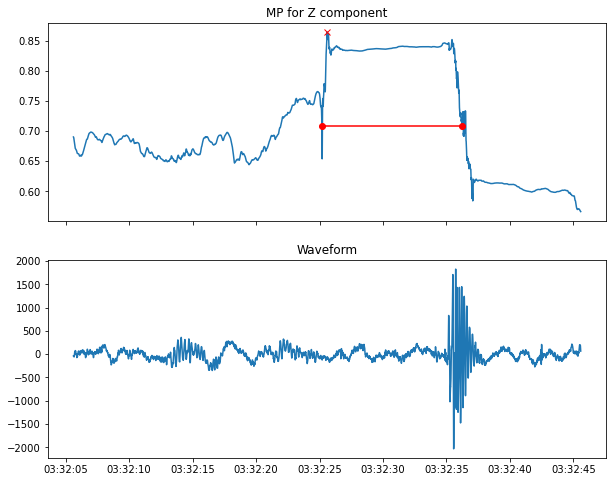

Peak height = 0.943530
Prominence = 0.391860
Width = 159.795947
Width height = 0.747600


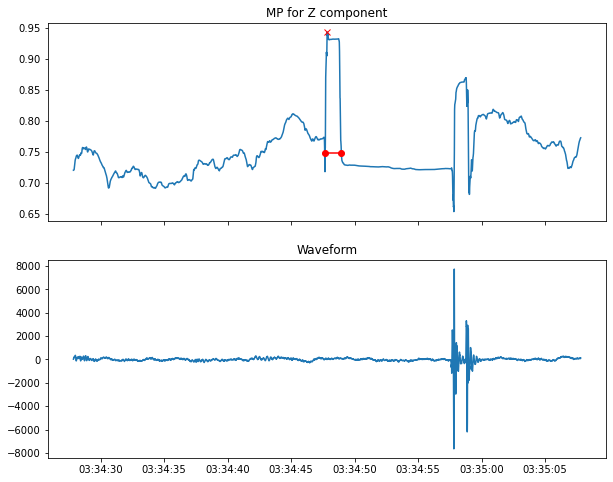

Peak height = 0.900317
Prominence = 0.325992
Width = 1317.635208
Width height = 0.737321


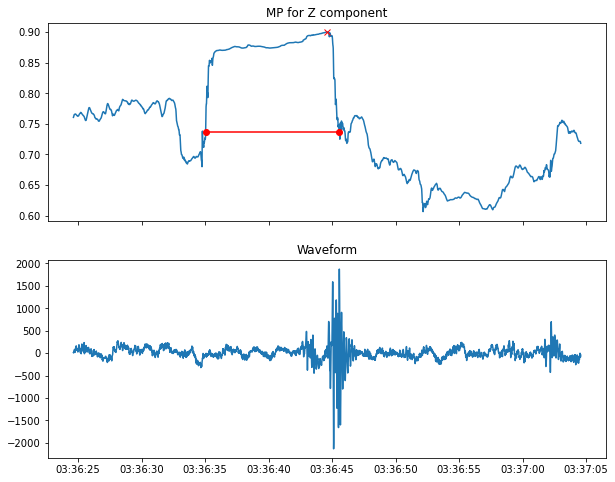

Peak height = 0.956004
Prominence = 0.415763
Width = 1461.505309
Width height = 0.748122


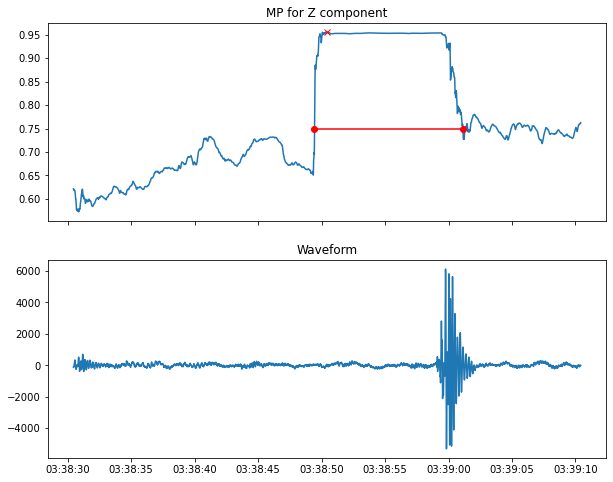

Peak height = 0.926911
Prominence = 0.363474
Width = 1401.859945
Width height = 0.745174


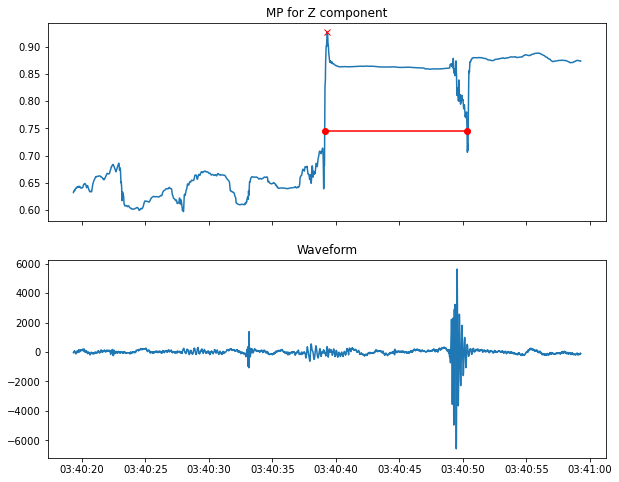

Peak height = 0.954652
Prominence = 0.387732
Width = 1287.640741
Width height = 0.760786


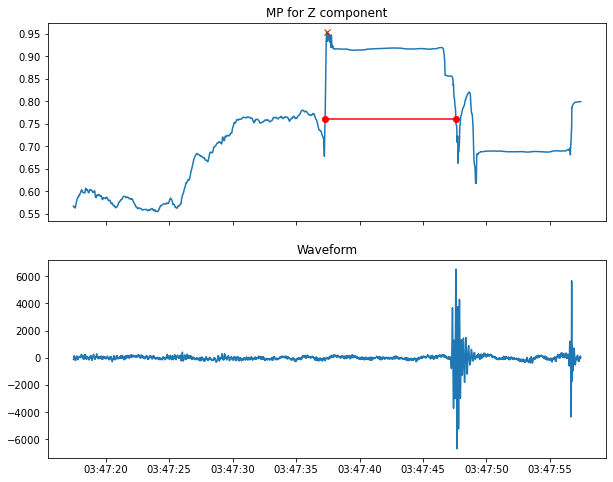

Peak height = 0.963406
Prominence = 0.447752
Width = 1382.346398
Width height = 0.739530


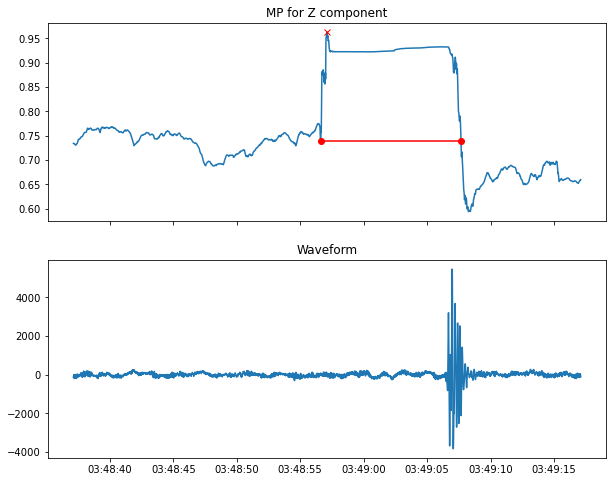

Peak height = 0.958600
Prominence = 0.444244
Width = 1424.506956
Width height = 0.736478


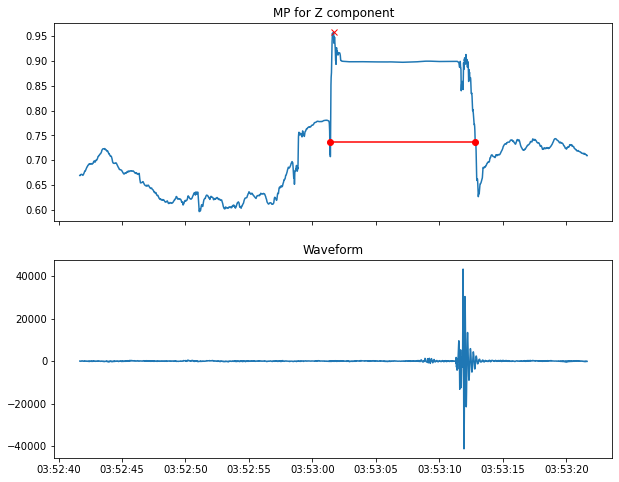

Peak height = 0.907056
Prominence = 0.385569
Width = 1303.068761
Width height = 0.714272


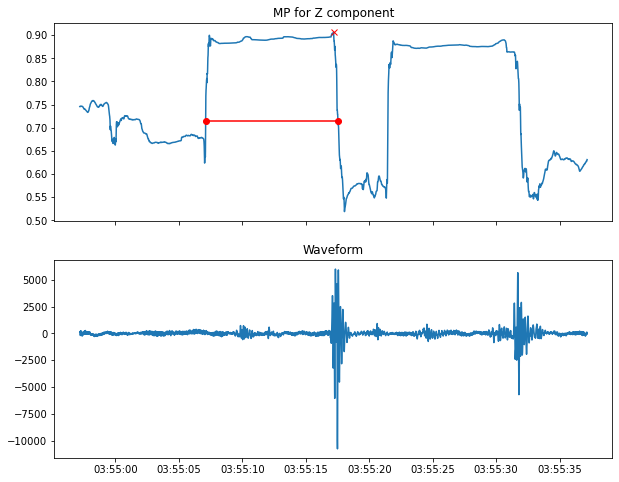

Peak height = 0.889935
Prominence = 0.347048
Width = 1306.623127
Width height = 0.716411


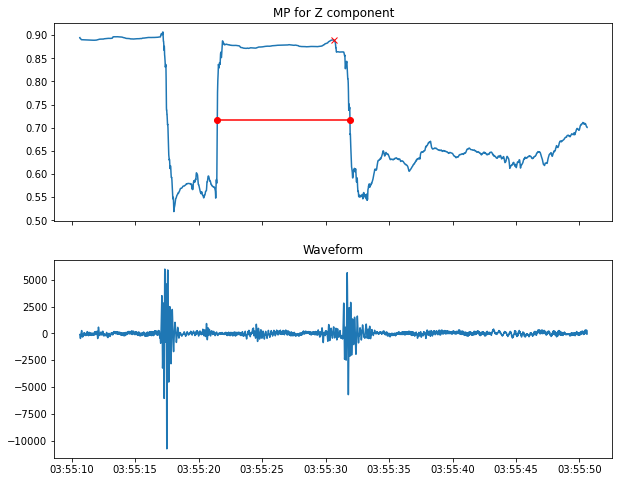

Peak height = 0.855348
Prominence = 0.311737
Width = 1295.803261
Width height = 0.699479


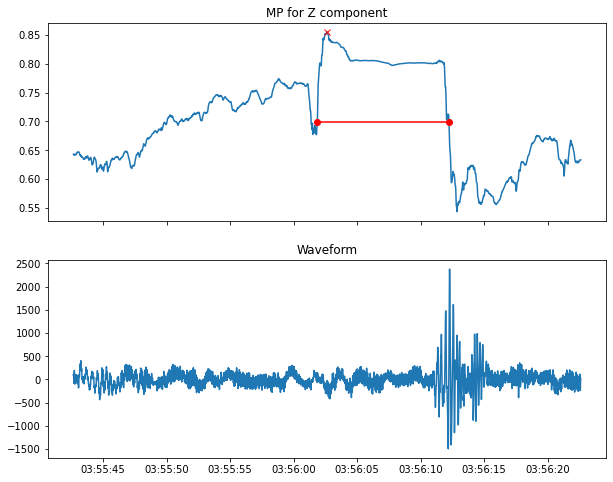

Peak height = 0.863566
Prominence = 0.320412
Width = 1427.686607
Width height = 0.703360


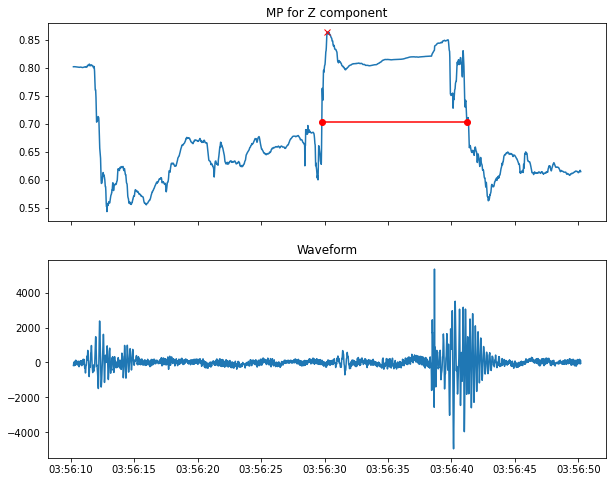

Peak height = 0.911375
Prominence = 0.392604
Width = 1360.772798
Width height = 0.715073


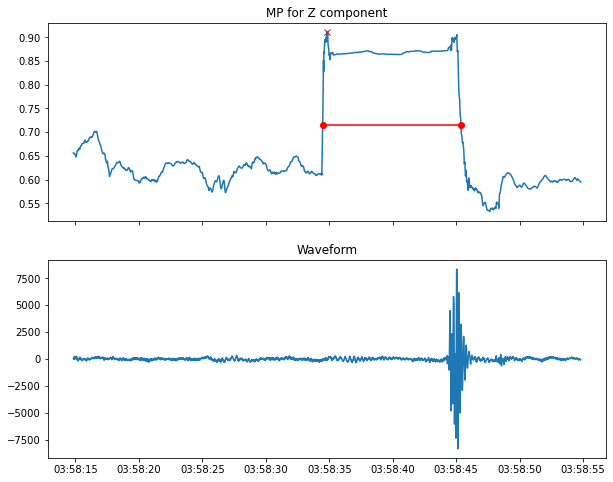

Peak height = 0.910895
Prominence = 0.420514
Width = 1376.196611
Width height = 0.700638


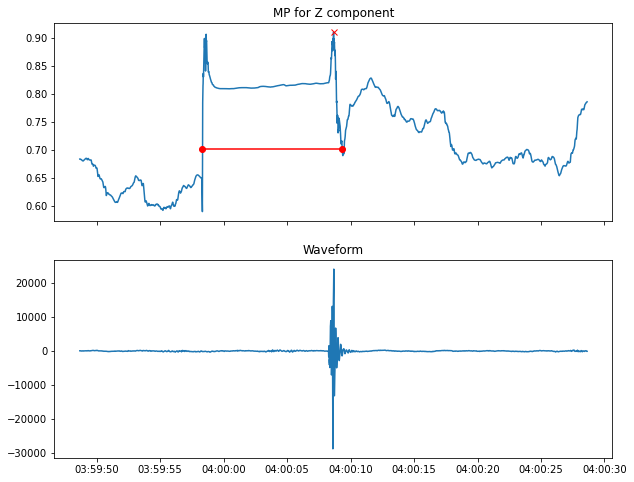

Peak height = 0.899472
Prominence = 0.404937
Width = 1419.793085
Width height = 0.697003


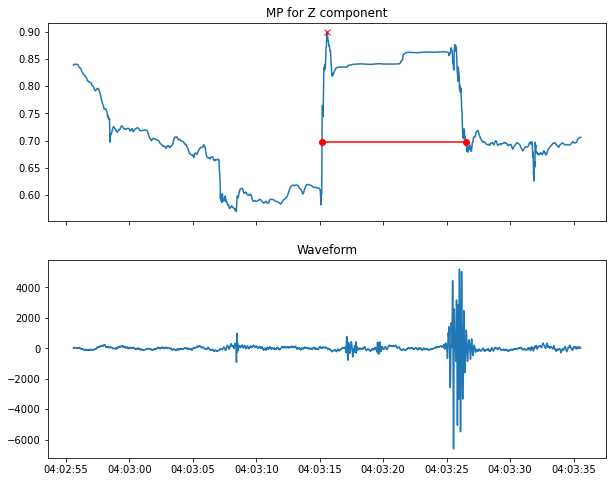

Peak height = 0.838246
Prominence = 0.352271
Width = 1273.992225
Width height = 0.662111


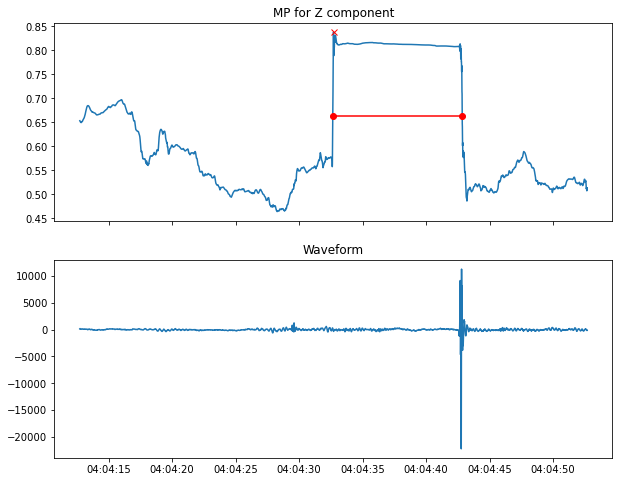

Peak height = 0.874942
Prominence = 0.343434
Width = 930.473424
Width height = 0.703225


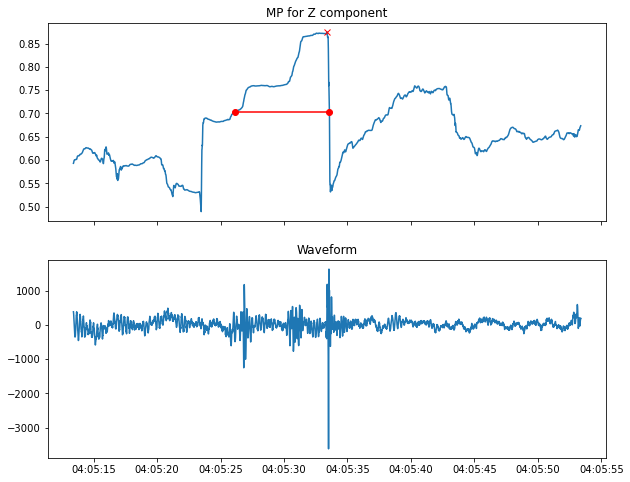

Peak height = 0.920953
Prominence = 0.351514
Width = 1268.665564
Width height = 0.745196


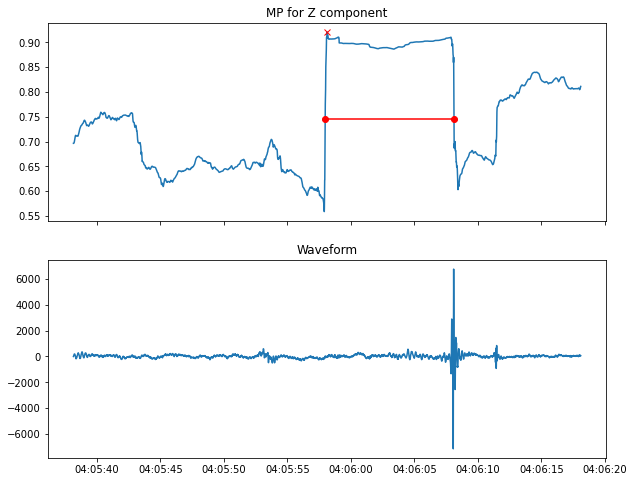

Peak height = 0.941651
Prominence = 0.424201
Width = 1289.614622
Width height = 0.729550


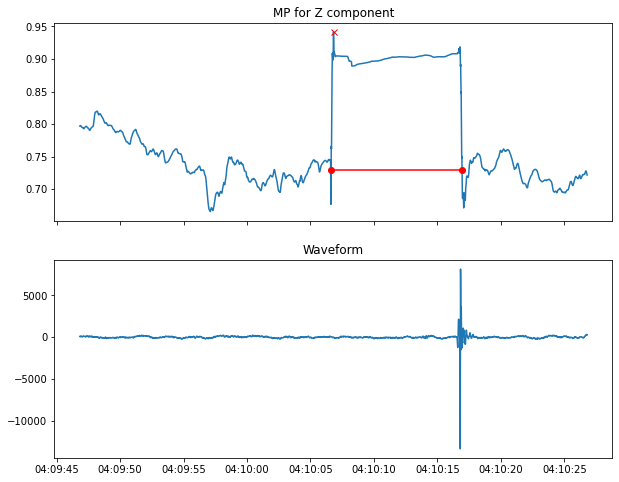

Peak height = 0.870949
Prominence = 0.325270
Width = 1416.591928
Width height = 0.708314


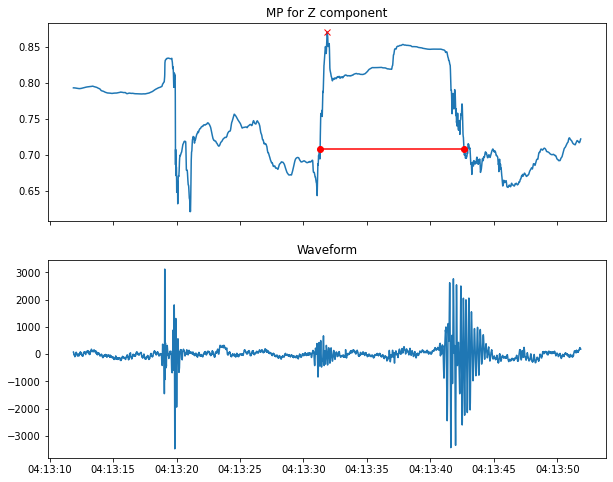

Peak height = 0.862807
Prominence = 0.322421
Width = 1253.311756
Width height = 0.701596


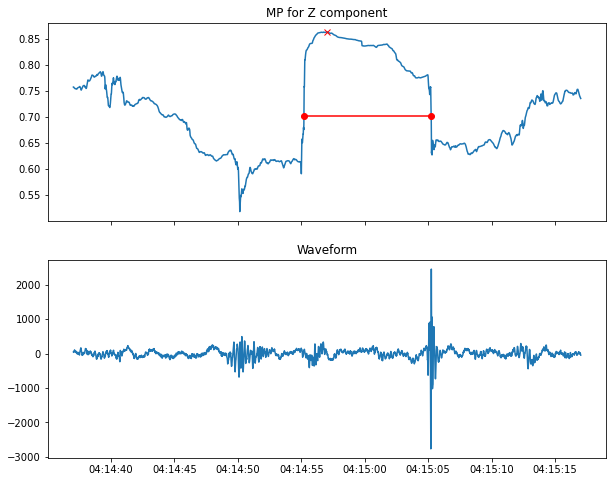

Peak height = 0.923846
Prominence = 0.382354
Width = 1272.599576
Width height = 0.732669


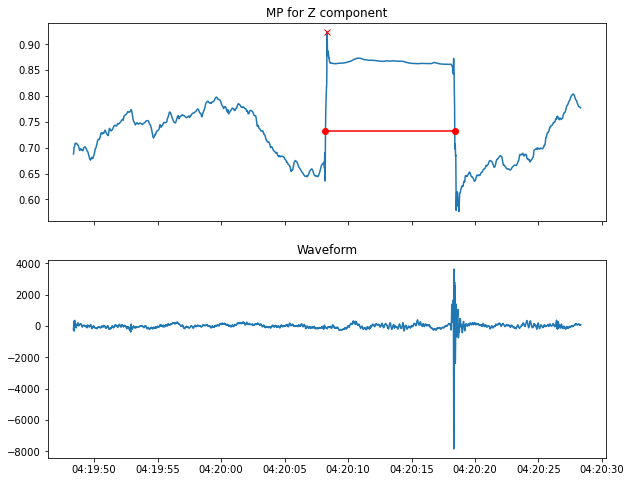

Peak height = 0.943167
Prominence = 0.405918
Width = 1264.701671
Width height = 0.740208


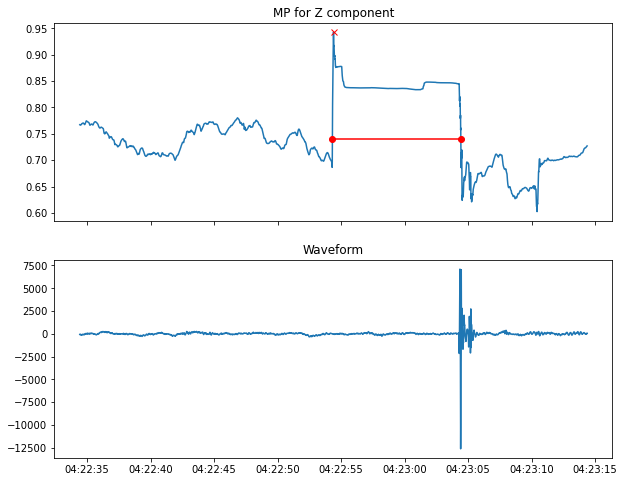

Peak height = 0.907848
Prominence = 0.327014
Width = 1276.491197
Width height = 0.744341


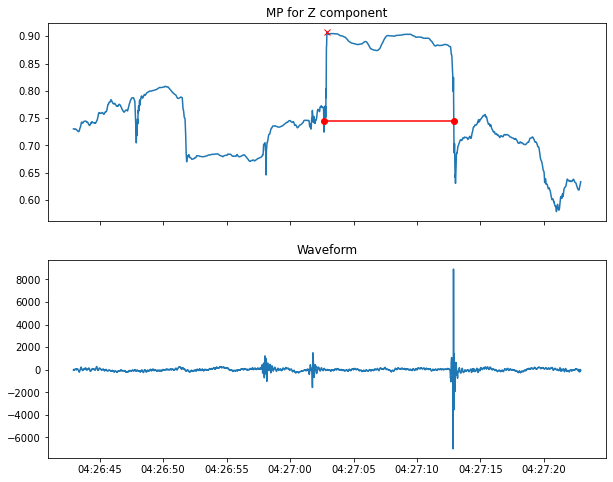

Peak height = 0.955306
Prominence = 0.449385
Width = 1286.294983
Width height = 0.730614


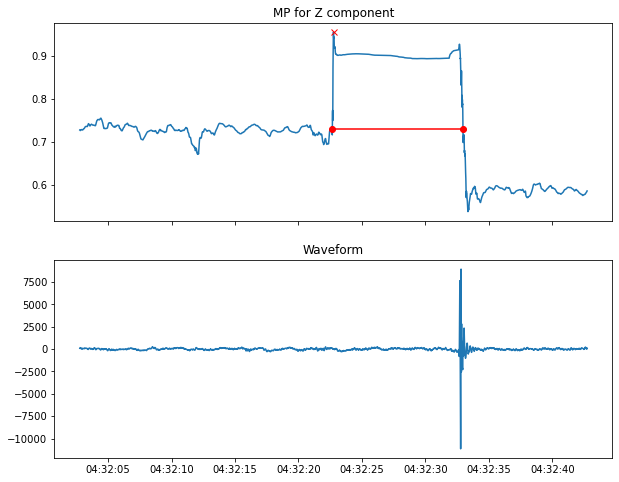

Peak height = 0.933800
Prominence = 0.339519
Width = 1270.296346
Width height = 0.764041


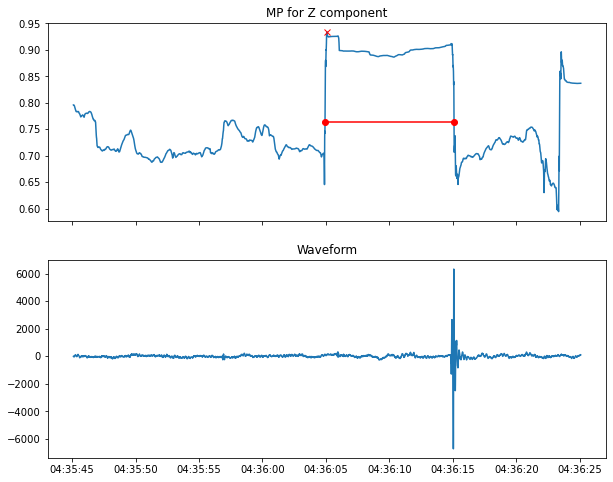

Peak height = 0.940340
Prominence = 0.409712
Width = 1284.141785
Width height = 0.735484


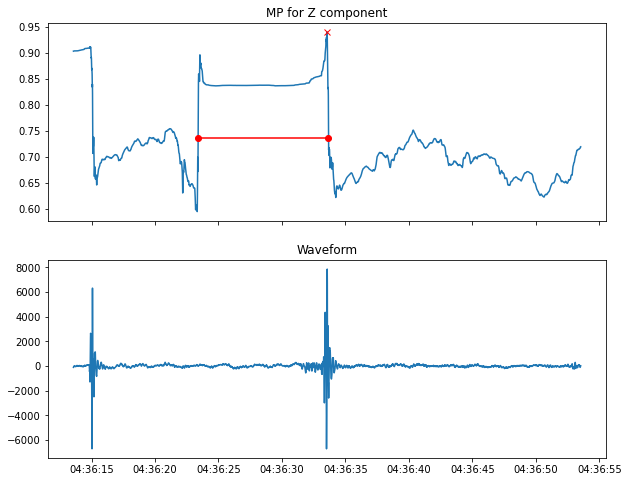

Peak height = 0.913125
Prominence = 0.394127
Width = 1434.919646
Width height = 0.716061


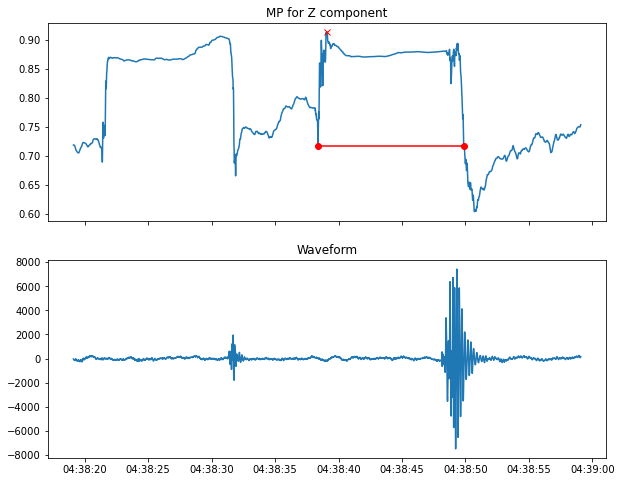

Peak height = 0.880813
Prominence = 0.359187
Width = 1375.622314
Width height = 0.701219


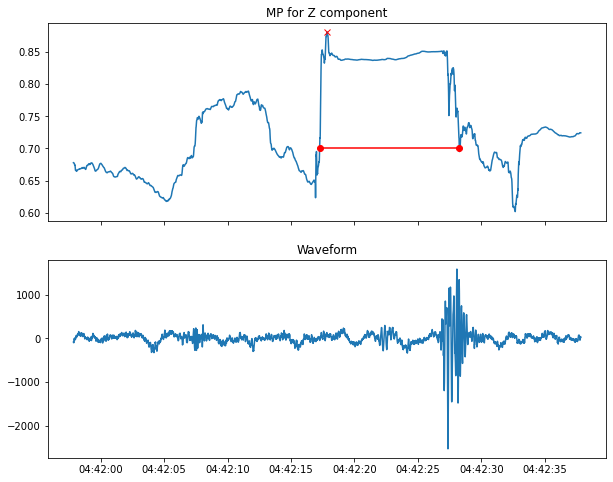

Peak height = 0.914792
Prominence = 0.314794
Width = 1431.284827
Width height = 0.757395


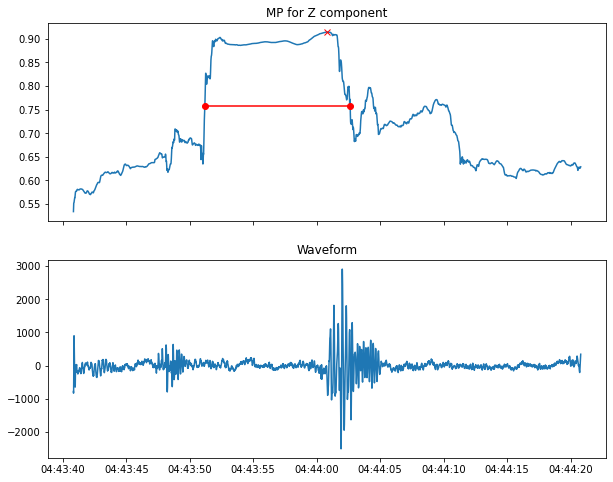

Peak height = 0.940010
Prominence = 0.411087
Width = 1288.357075
Width height = 0.734467


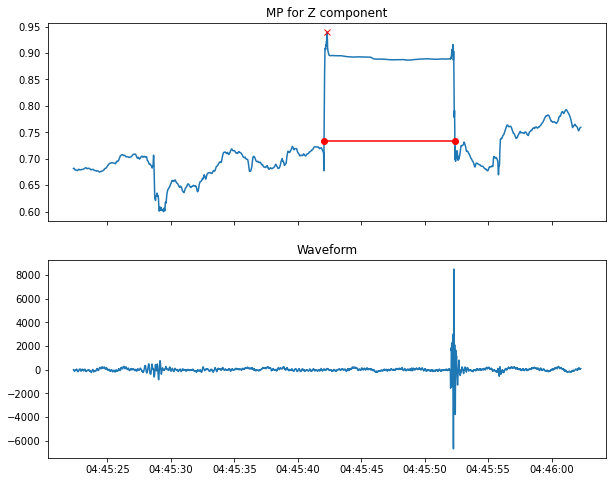

Peak height = 0.966023
Prominence = 0.457300
Width = 1362.480032
Width height = 0.737373


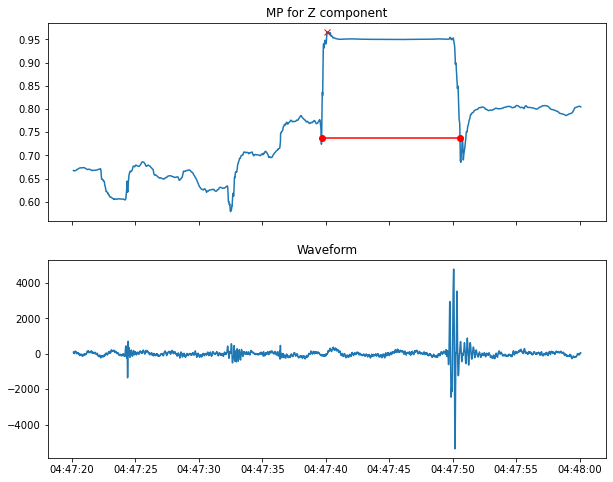

Peak height = 0.880781
Prominence = 0.340928
Width = 1476.782888
Width height = 0.710317


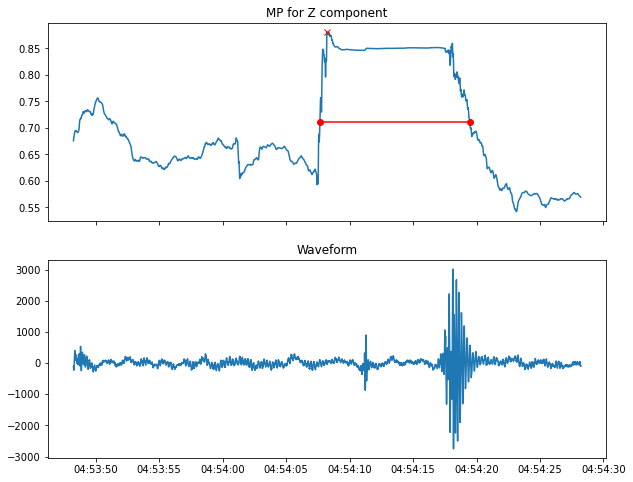

Peak height = 0.929180
Prominence = 0.331570
Width = 1307.818612
Width height = 0.763395


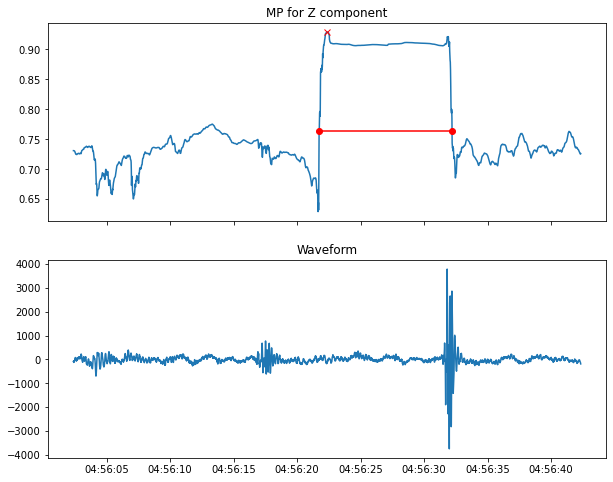

Peak height = 0.937487
Prominence = 0.407410
Width = 1277.344959
Width height = 0.733782


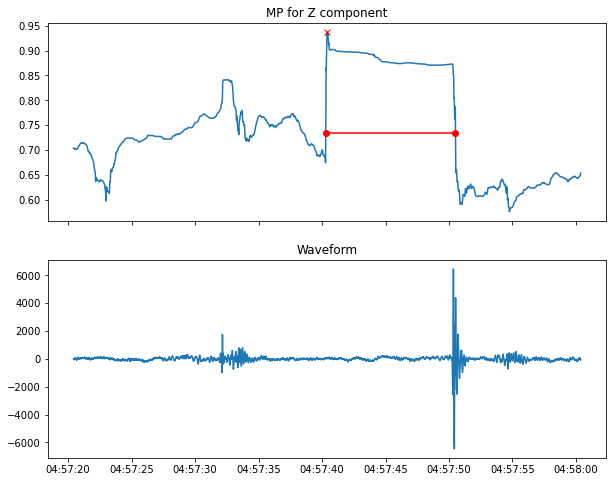

Peak height = 0.904528
Prominence = 0.342491
Width = 1289.861915
Width height = 0.733283


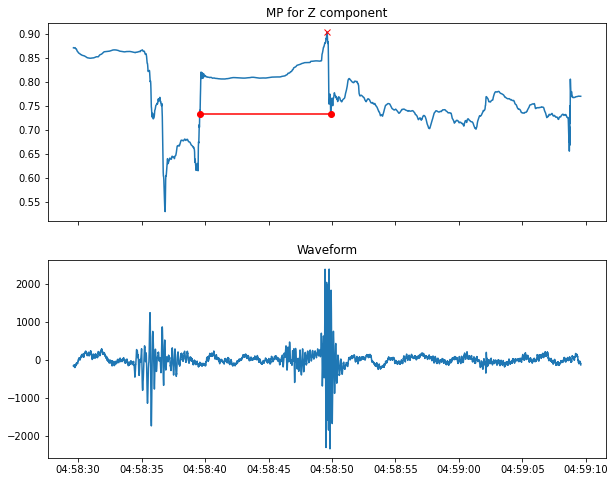

Peak height = 0.991197
Prominence = 0.664413
Width = 1475.362268
Width height = 0.658990


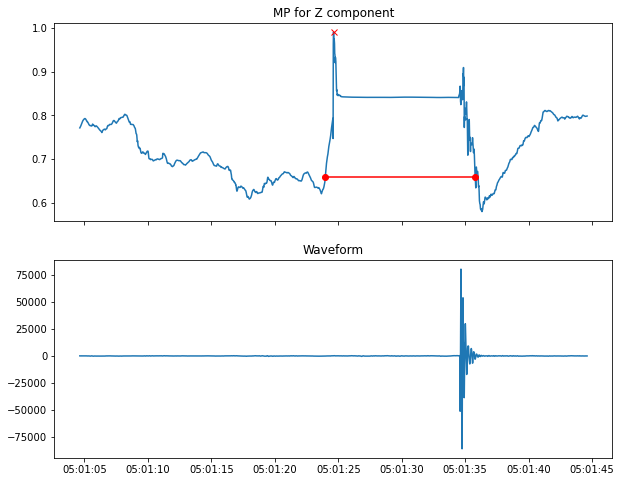

Peak height = 0.934431
Prominence = 0.354272
Width = 1309.809531
Width height = 0.757295


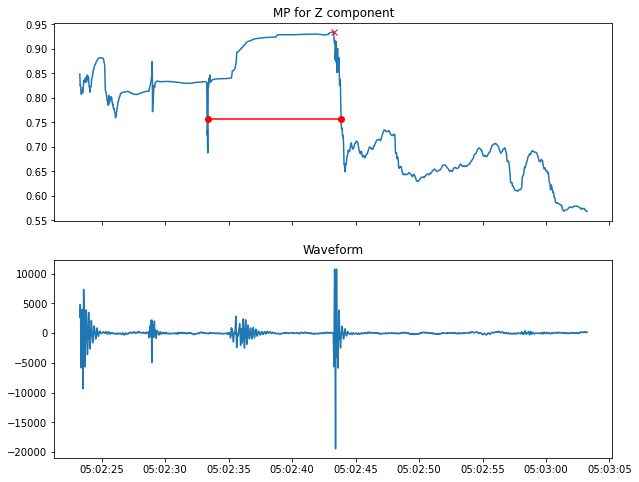

Peak height = 0.909811
Prominence = 0.392929
Width = 1281.155291
Width height = 0.713346


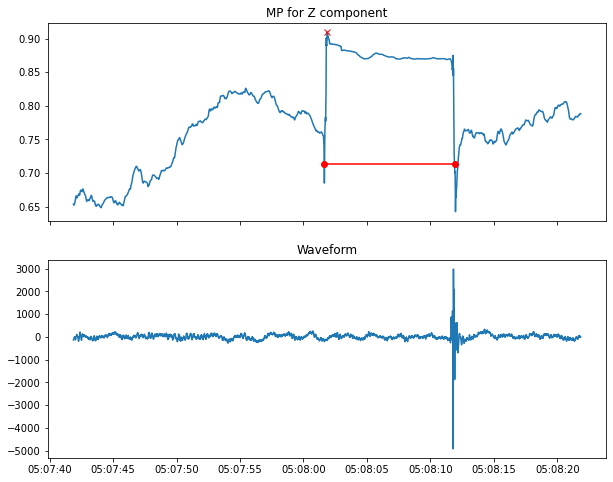

Peak height = 0.864031
Prominence = 0.303256
Width = 1311.816204
Width height = 0.712403


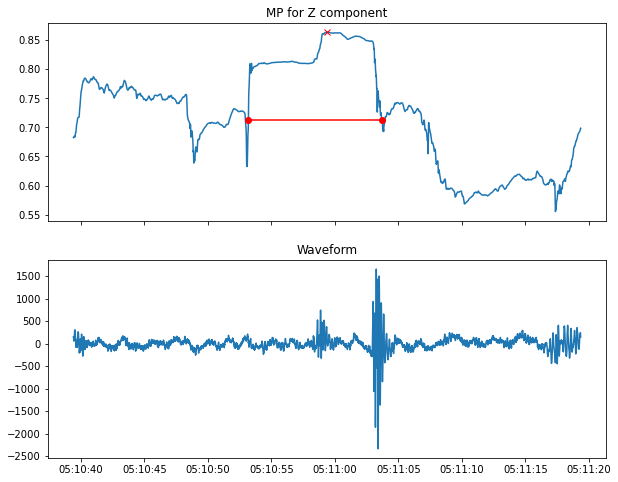

Peak height = 0.943289
Prominence = 0.403853
Width = 1327.927574
Width height = 0.741363


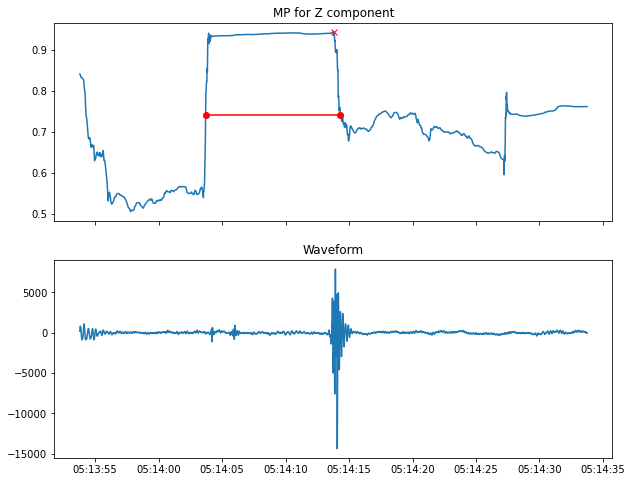

Peak height = 0.951222
Prominence = 0.435591
Width = 1301.558918
Width height = 0.733426


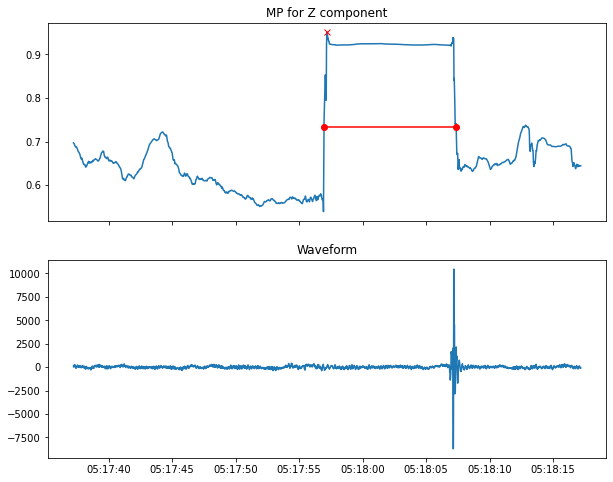

Peak height = 0.900779
Prominence = 0.382972
Width = 1271.757221
Width height = 0.709293


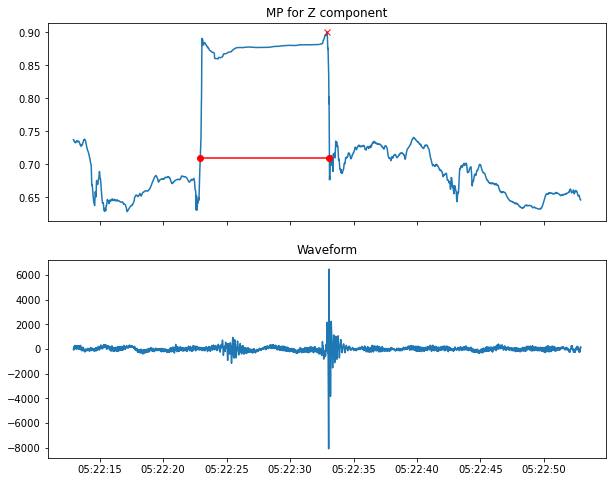

Peak height = 0.930542
Prominence = 0.408597
Width = 1368.397633
Width height = 0.726244


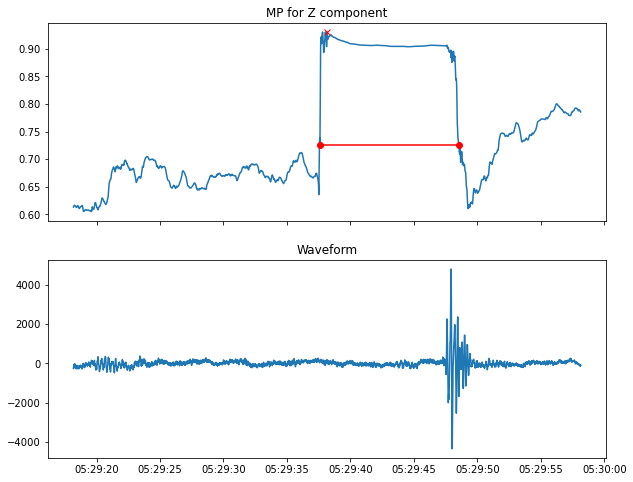

Peak height = 0.924012
Prominence = 0.319493
Width = 75.280187
Width height = 0.764266


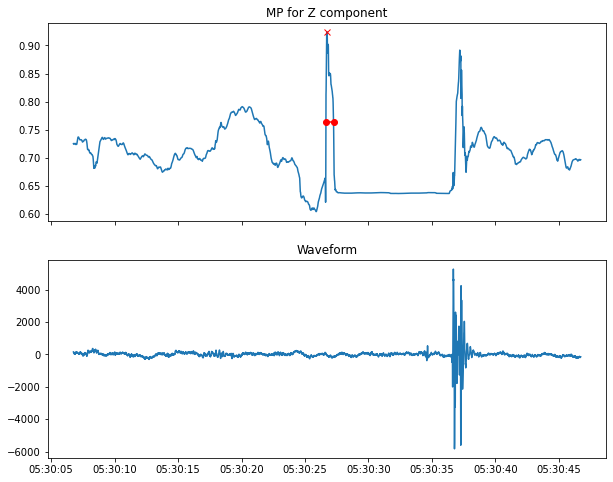

Peak height = 0.895002
Prominence = 0.338895
Width = 1000.587944
Width height = 0.725554


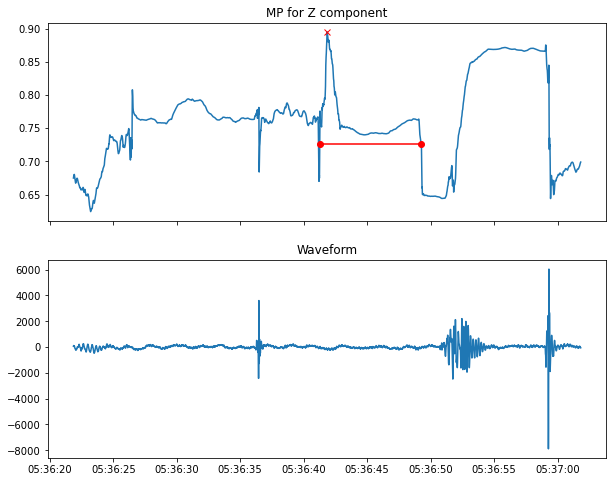

Peak height = 0.938492
Prominence = 0.394334
Width = 1272.981942
Width height = 0.741325


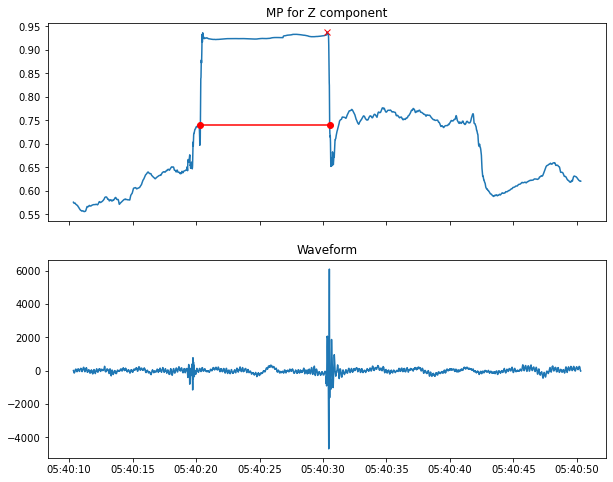

Peak height = 0.914222
Prominence = 0.345291
Width = 1310.979929
Width height = 0.741576


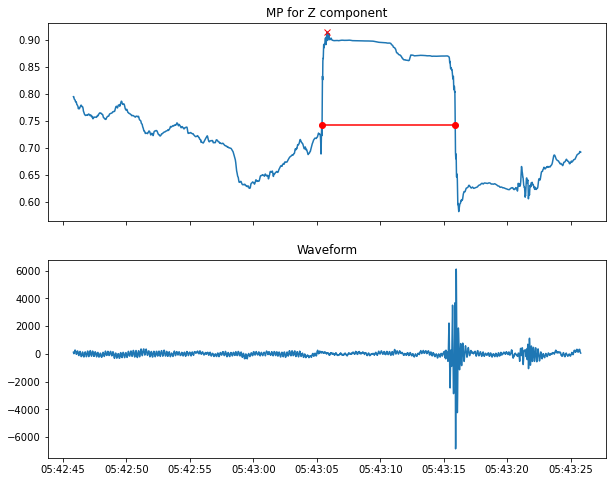

Peak height = 0.955594
Prominence = 0.444954
Width = 1280.179140
Width height = 0.733117


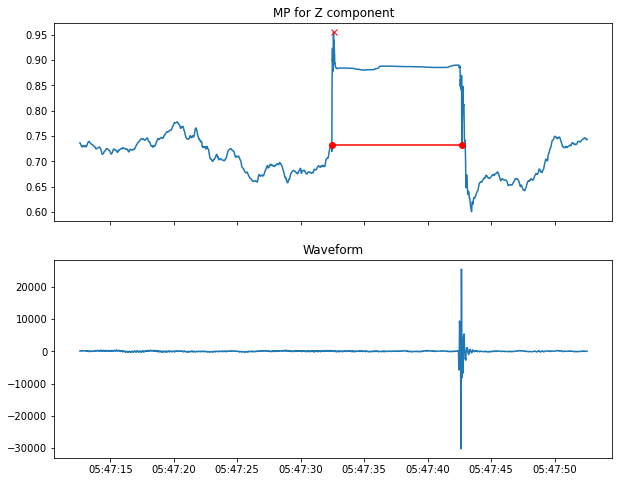

Peak height = 0.908194
Prominence = 0.340674
Width = 1264.283707
Width height = 0.737857


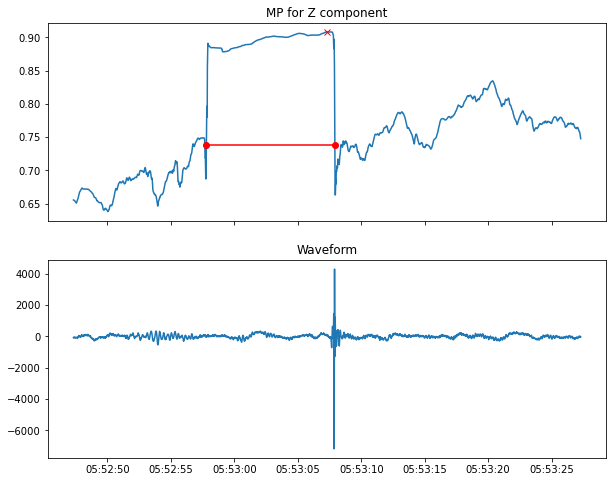

Peak height = 0.875969
Prominence = 0.319644
Width = 1303.211952
Width height = 0.716147


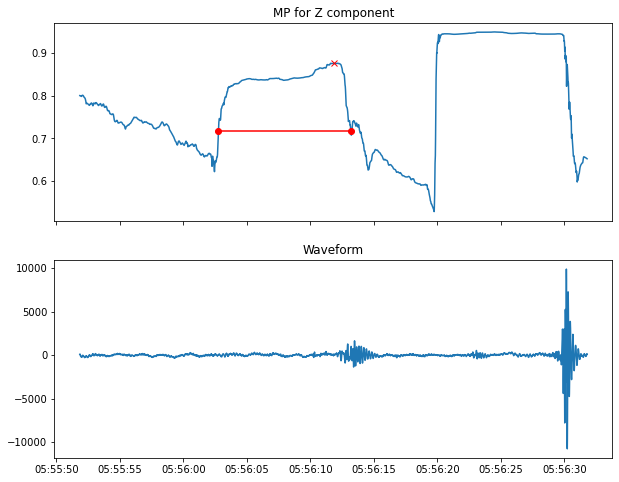

Peak height = 0.949505
Prominence = 0.402926
Width = 1327.110463
Width height = 0.748042


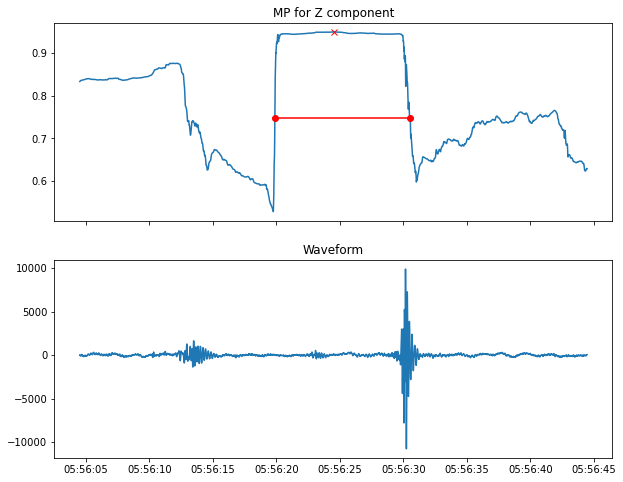

Peak height = 0.915995
Prominence = 0.369326
Width = 1341.506496
Width height = 0.731333


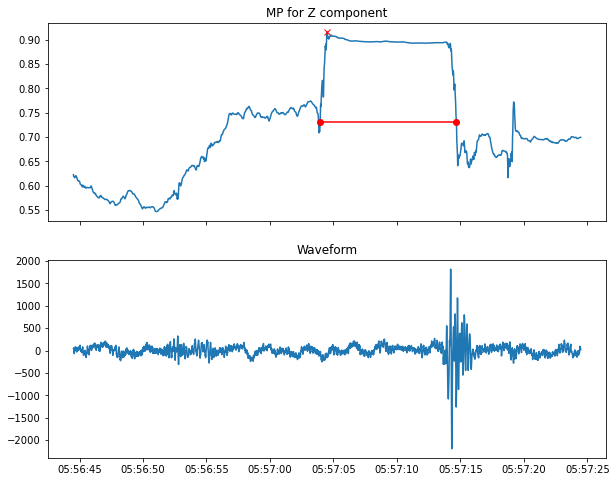

Peak height = 0.900353
Prominence = 0.319486
Width = 1248.978545
Width height = 0.740610


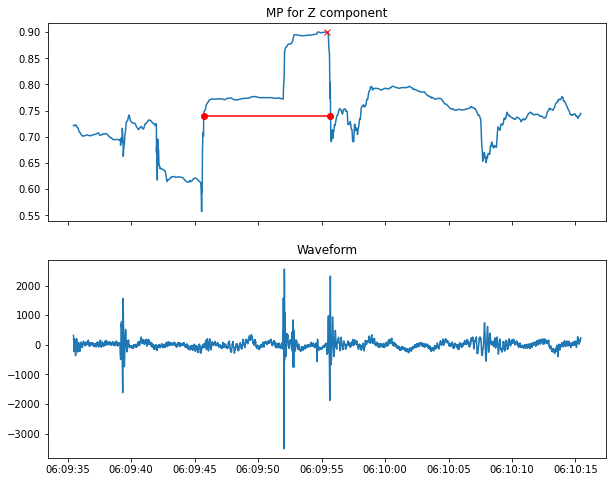

Peak height = 0.905757
Prominence = 0.348786
Width = 1245.384223
Width height = 0.731364


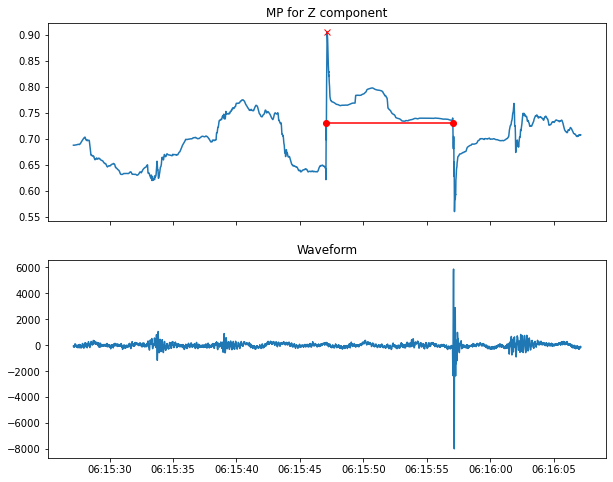

Peak height = 0.933265
Prominence = 0.343514
Width = 1288.665422
Width height = 0.761508


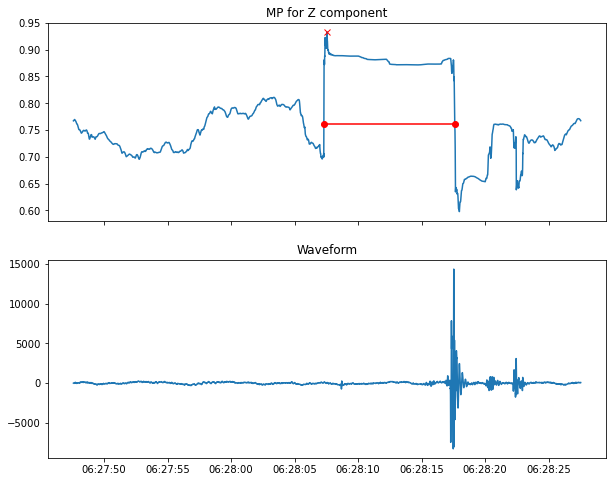

Peak height = 0.951242
Prominence = 0.423436
Width = 1301.201406
Width height = 0.739524


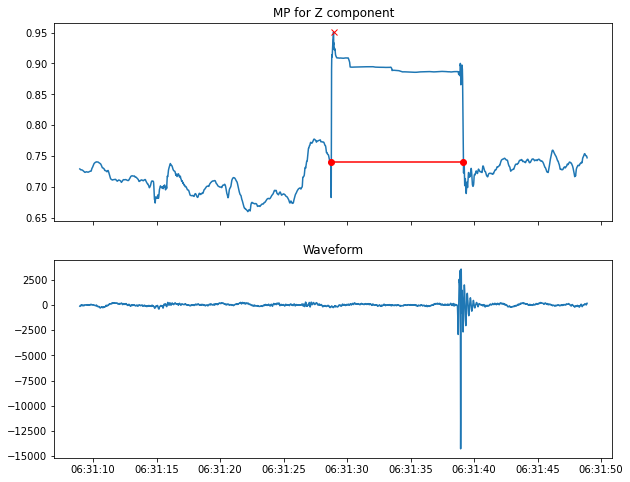

Peak height = 0.911978
Prominence = 0.344233
Width = 1317.062463
Width height = 0.739861


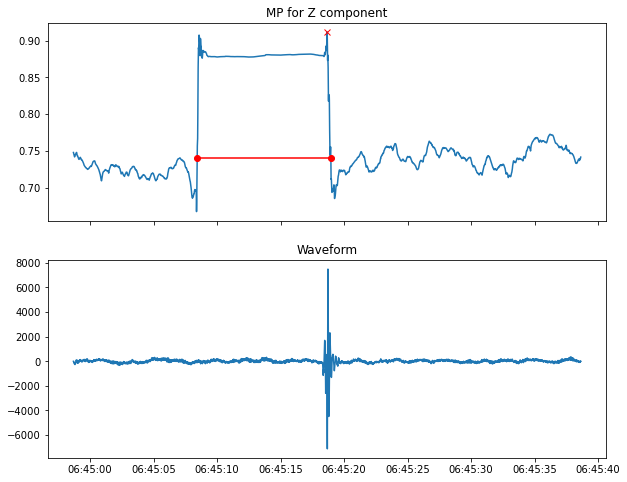

Peak height = 0.942907
Prominence = 0.386532
Width = 1279.696920
Width height = 0.749641


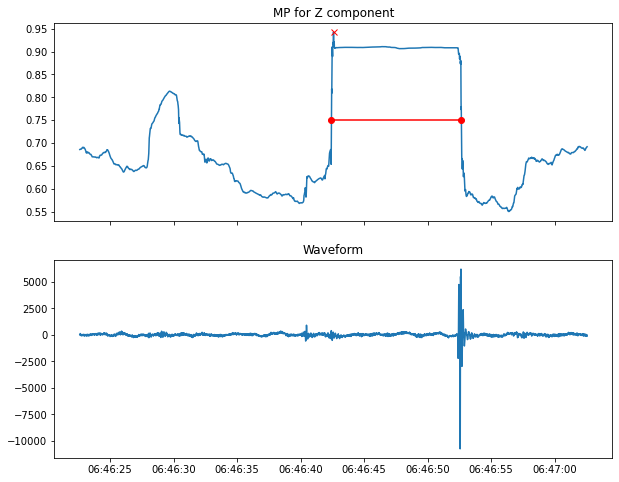

Peak height = 0.946426
Prominence = 0.426581
Width = 1292.184254
Width height = 0.733135


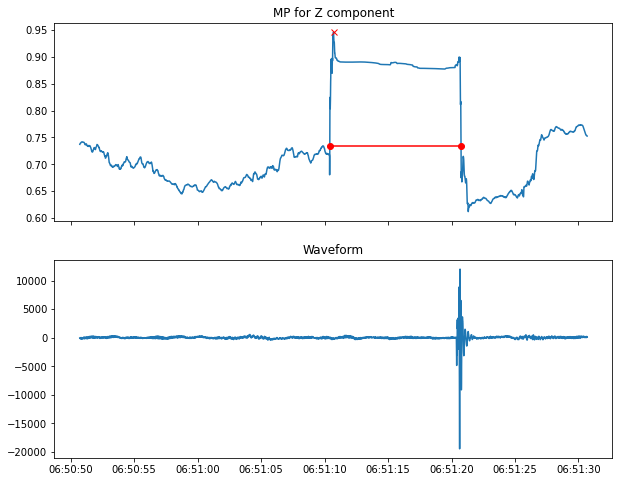

Peak height = 0.948465
Prominence = 0.383236
Width = 1312.302420
Width height = 0.756847


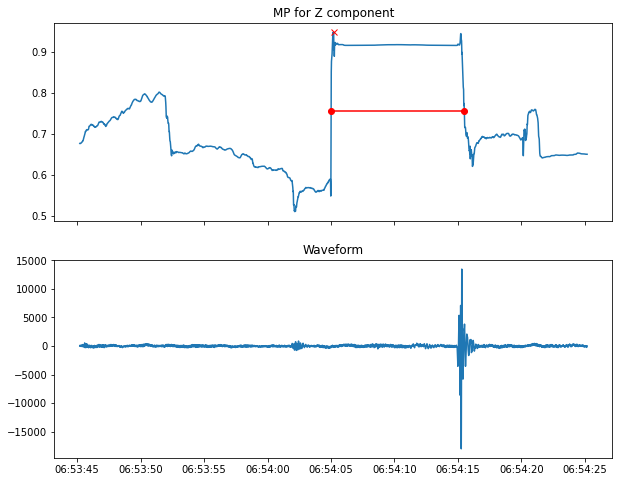

Peak height = 0.964115
Prominence = 0.457770
Width = 1273.160020
Width height = 0.735230


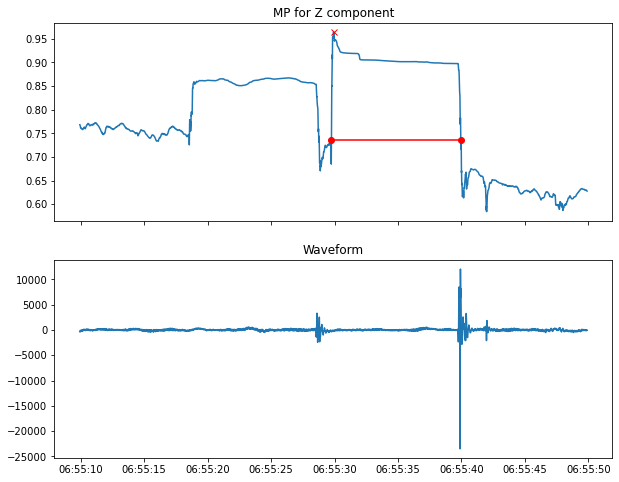

Peak height = 0.921266
Prominence = 0.370530
Width = 1371.215076
Width height = 0.736001


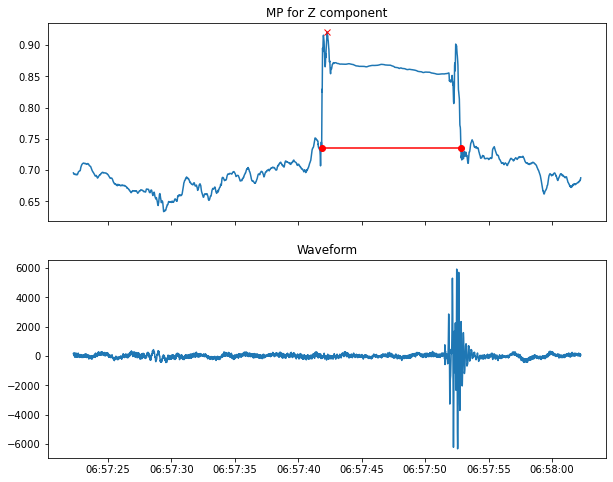

Peak height = 0.931154
Prominence = 0.395664
Width = 1370.138821
Width height = 0.733322


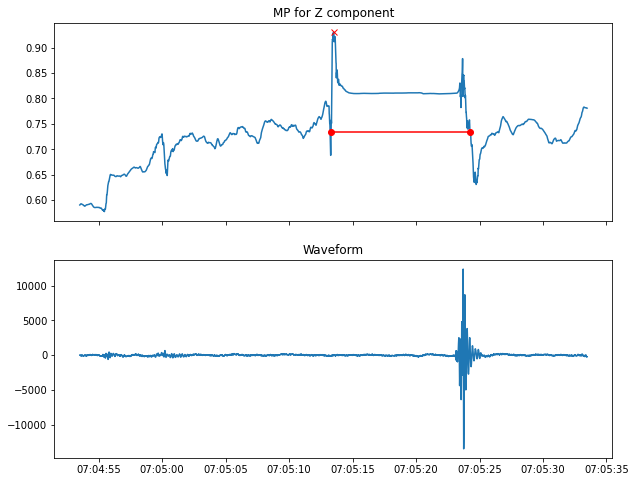

Peak height = 0.897995
Prominence = 0.367452
Width = 1391.043986
Width height = 0.714269


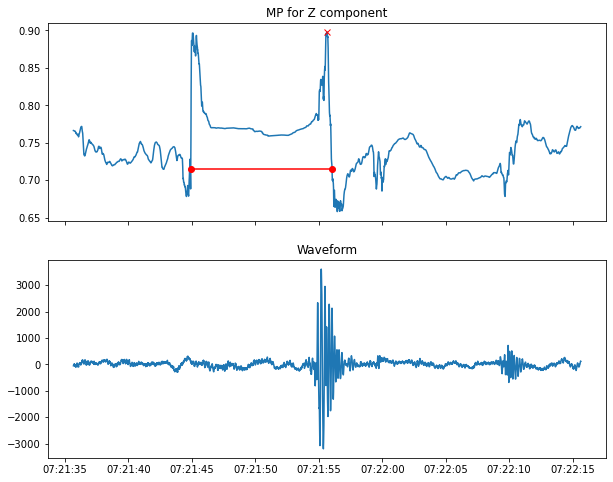

Peak height = 0.951578
Prominence = 0.455877
Width = 1351.480640
Width height = 0.723640


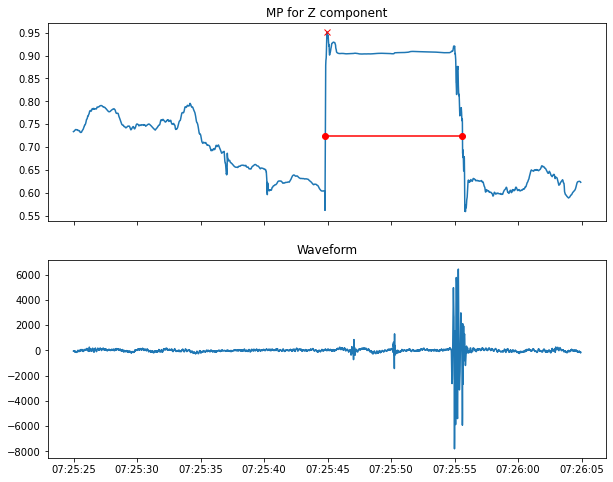

Peak height = 0.927525
Prominence = 0.368657
Width = 1284.273566
Width height = 0.743197


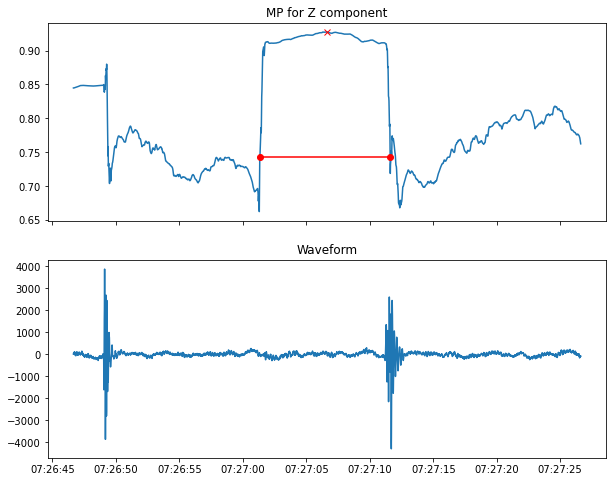

Peak height = 0.860035
Prominence = 0.324932
Width = 1270.899010
Width height = 0.697569


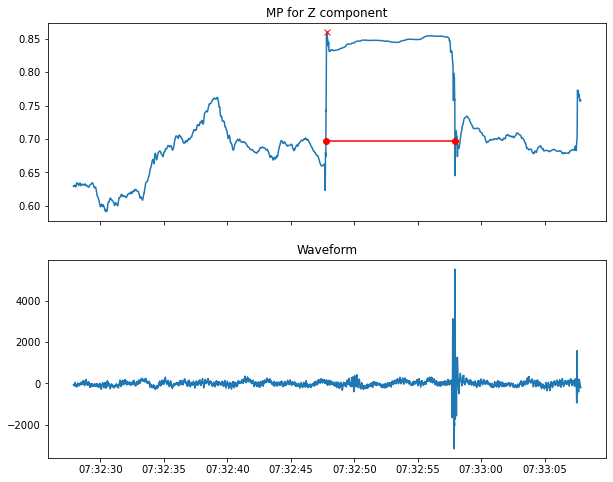

Peak height = 0.882297
Prominence = 0.357942
Width = 1347.539728
Width height = 0.703326


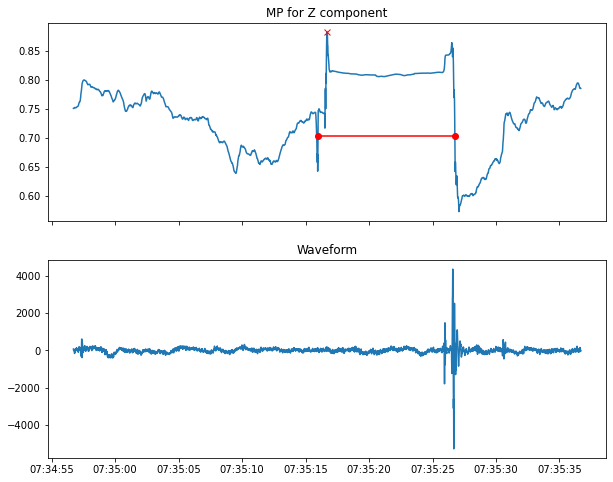

Peak height = 0.882843
Prominence = 0.380104
Width = 1323.807964
Width height = 0.692792


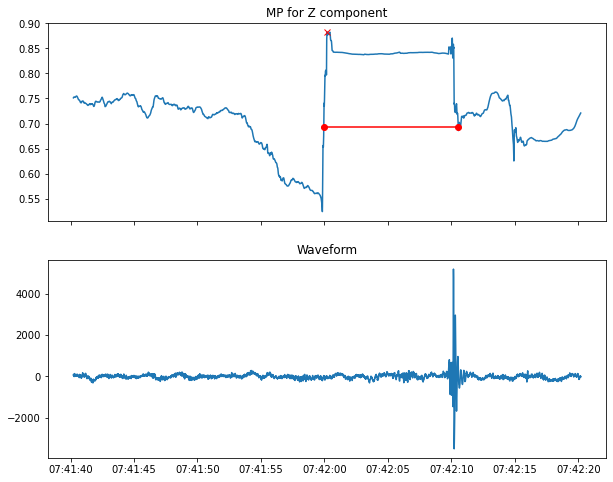

Peak height = 0.866965
Prominence = 0.309022
Width = 1392.236757
Width height = 0.712453


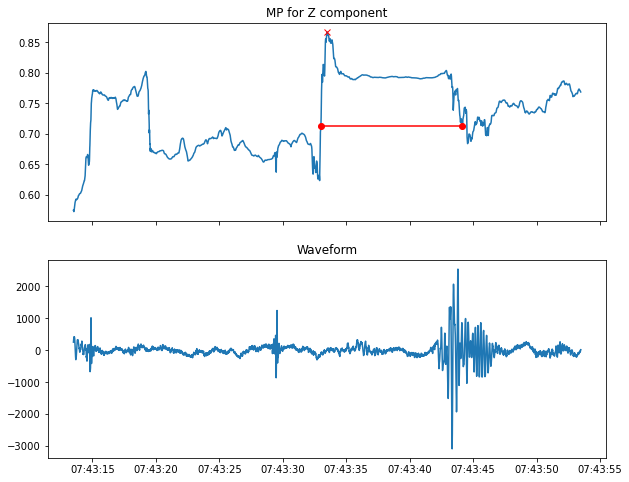

Peak height = 0.919035
Prominence = 0.374576
Width = 1280.882366
Width height = 0.731746


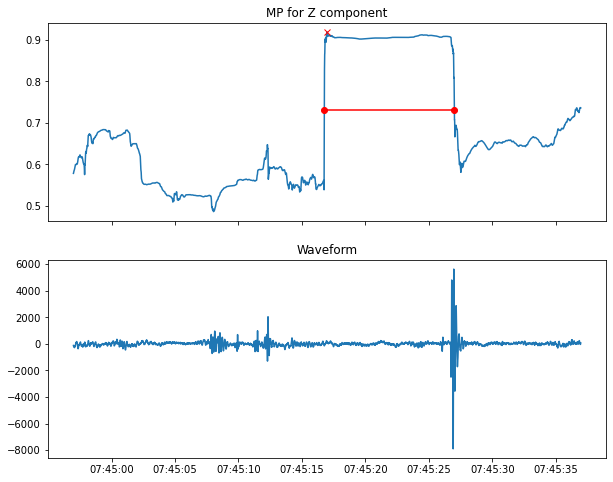

Peak height = 0.923413
Prominence = 0.407423
Width = 1367.316002
Width height = 0.719701


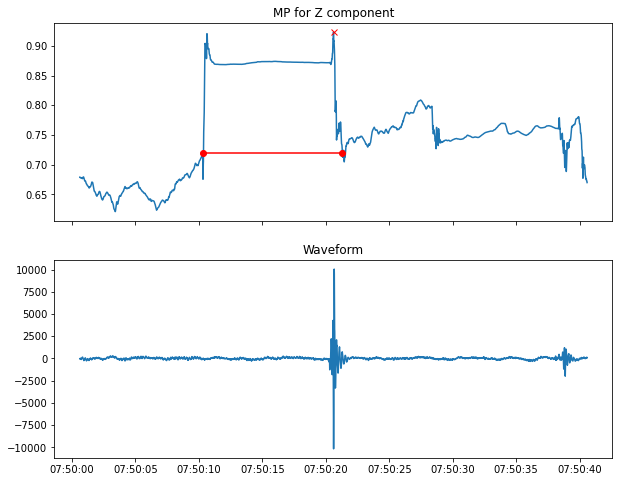

Peak height = 0.926609
Prominence = 0.379573
Width = 1286.040338
Width height = 0.736822


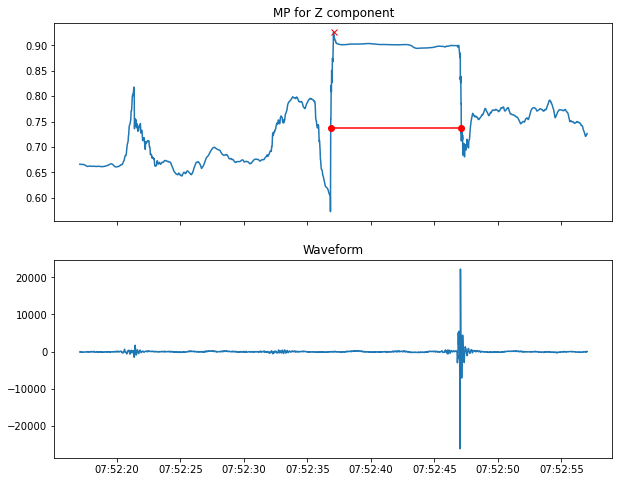

Peak height = 0.903596
Prominence = 0.301206
Width = 1255.912986
Width height = 0.752994


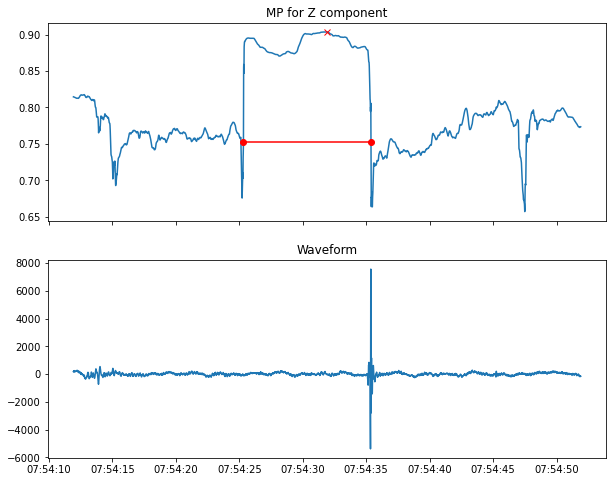

Peak height = 0.919928
Prominence = 0.336206
Width = 1322.449540
Width height = 0.751825


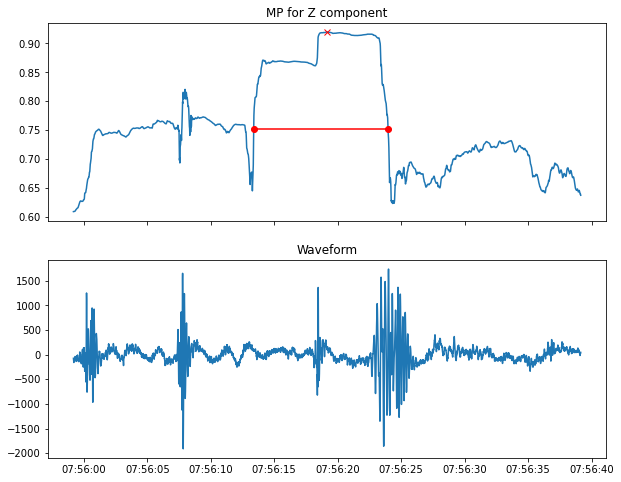

Peak height = 0.955917
Prominence = 0.449438
Width = 1409.112997
Width height = 0.731198


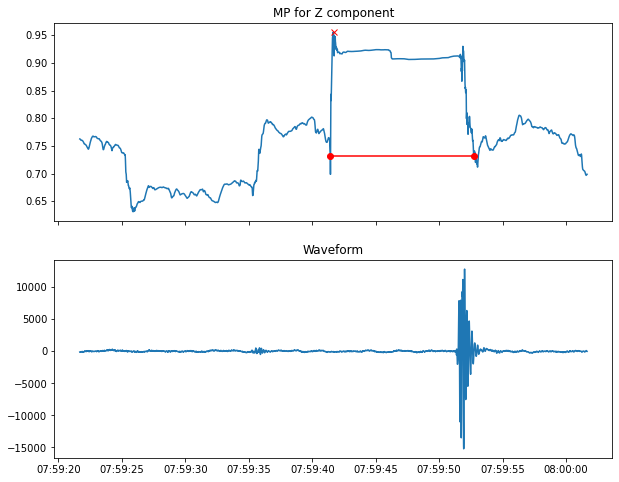

Peak height = 0.937609
Prominence = 0.387802
Width = 1290.779991
Width height = 0.743708


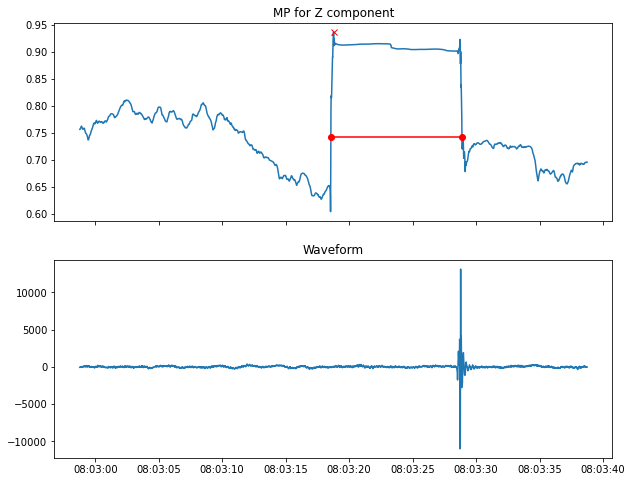

Peak height = 0.906504
Prominence = 0.333116
Width = 1315.367889
Width height = 0.739946


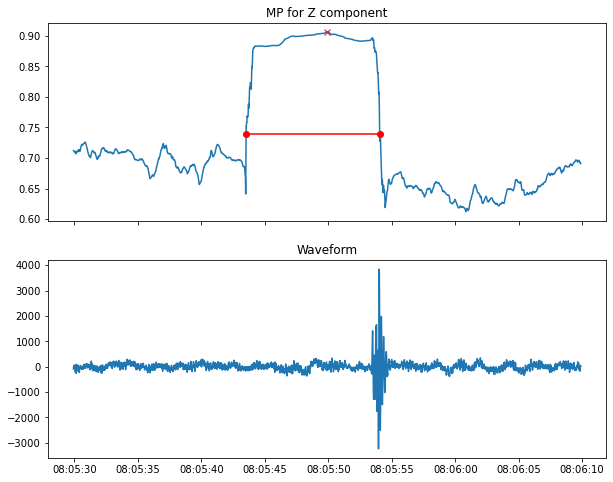

Peak height = 0.885511
Prominence = 0.339776
Width = 1287.987440
Width height = 0.715623


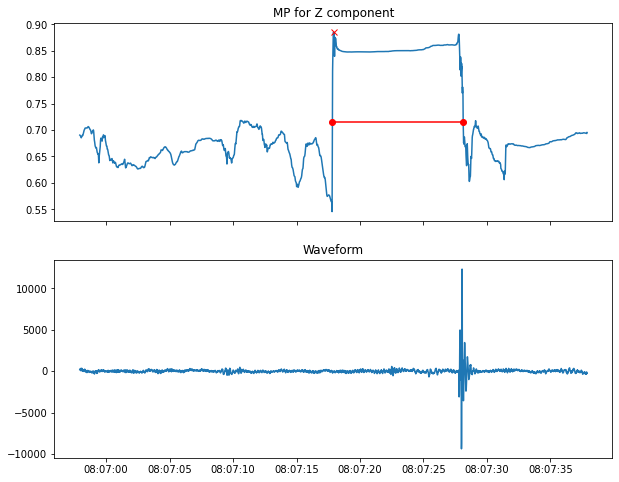

Peak height = 0.937296
Prominence = 0.392385
Width = 1300.088757
Width height = 0.741104


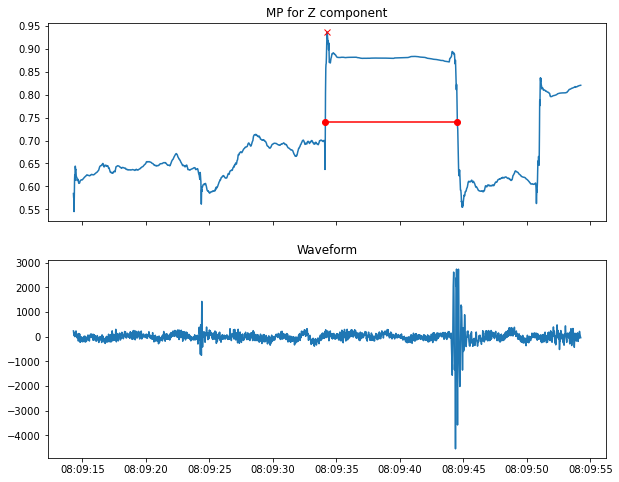

Peak height = 0.875481
Prominence = 0.321057
Width = 1269.189252
Width height = 0.714953


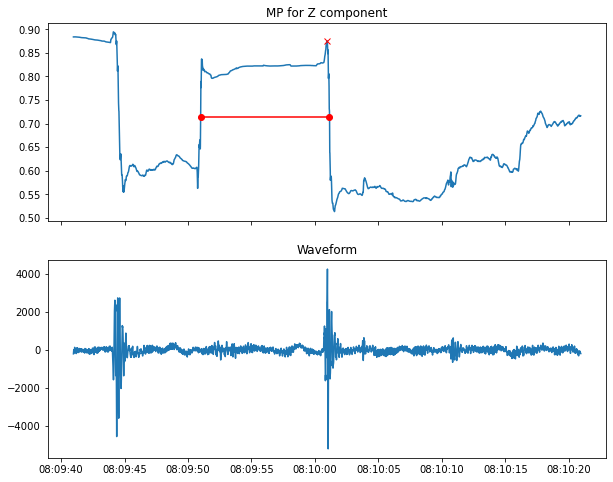

Peak height = 0.906358
Prominence = 0.342794
Width = 1295.575009
Width height = 0.734961


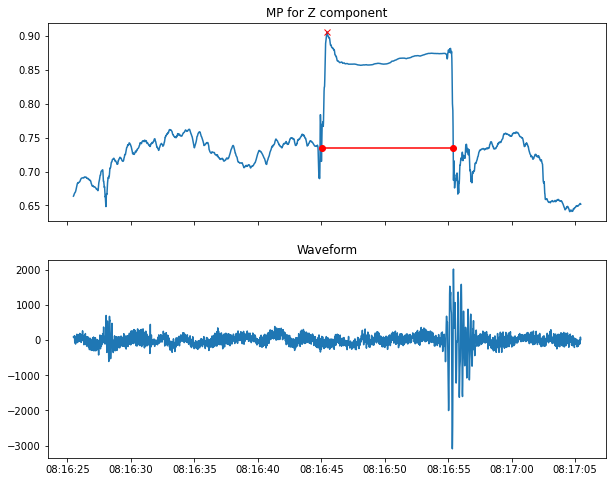

Peak height = 0.987143
Prominence = 0.500716
Width = 1398.057162
Width height = 0.736785


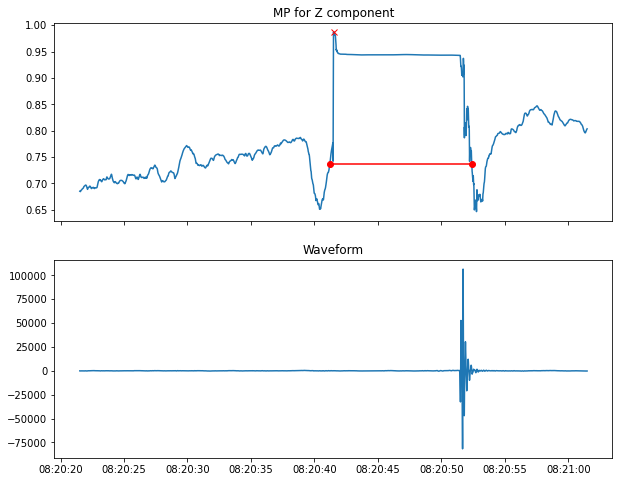

Peak height = 0.972595
Prominence = 0.439954
Width = 1347.820165
Width height = 0.752618


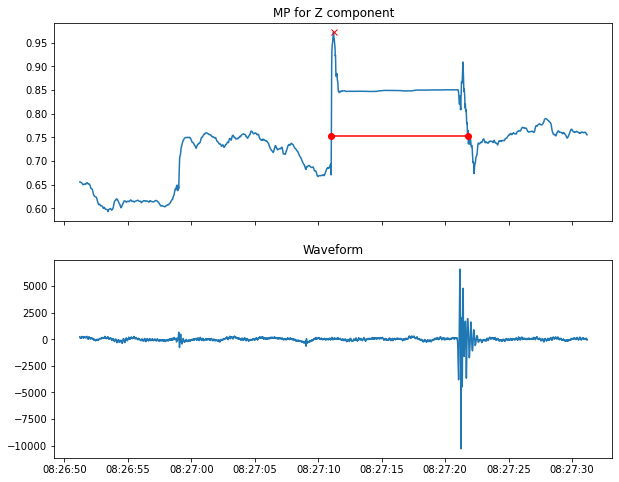

Peak height = 0.891987
Prominence = 0.317135
Width = 1286.837826
Width height = 0.733419


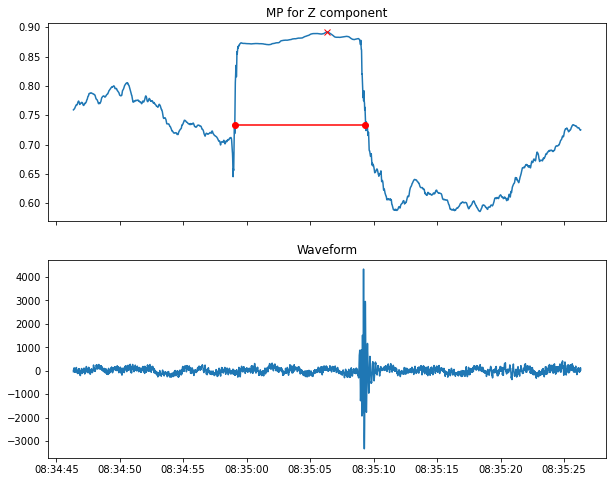

Peak height = 0.939678
Prominence = 0.372966
Width = 1270.427165
Width height = 0.753195


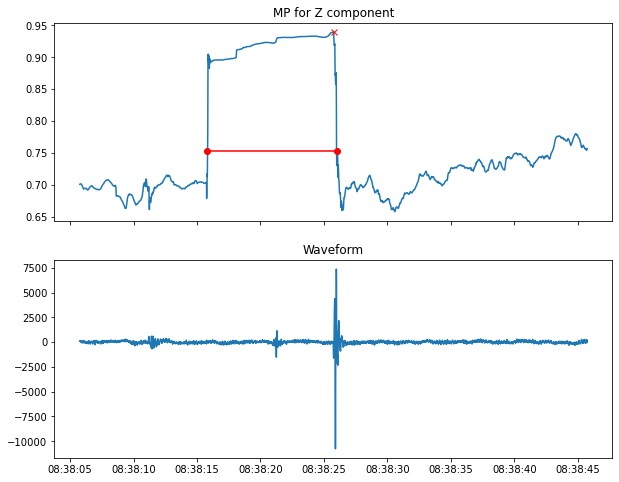

Peak height = 0.972701
Prominence = 0.442905
Width = 1318.338049
Width height = 0.751248


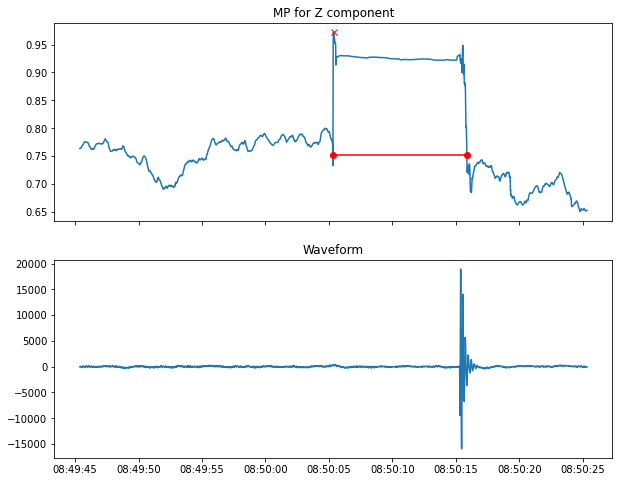

Peak height = 0.941567
Prominence = 0.352965
Width = 1282.345350
Width height = 0.765085


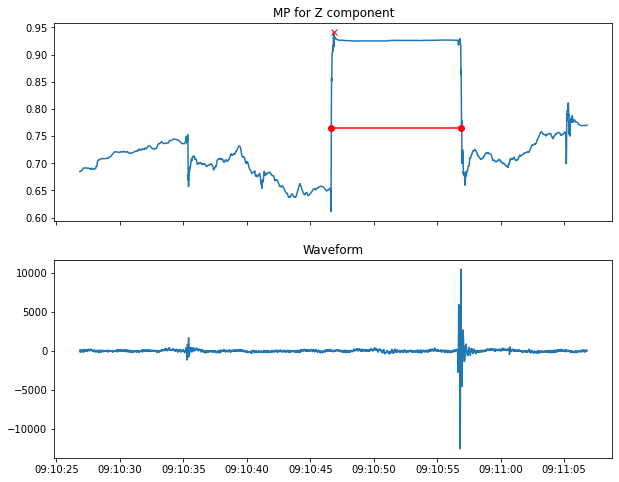

Peak height = 0.921914
Prominence = 0.310377
Width = 1273.000890
Width height = 0.766725


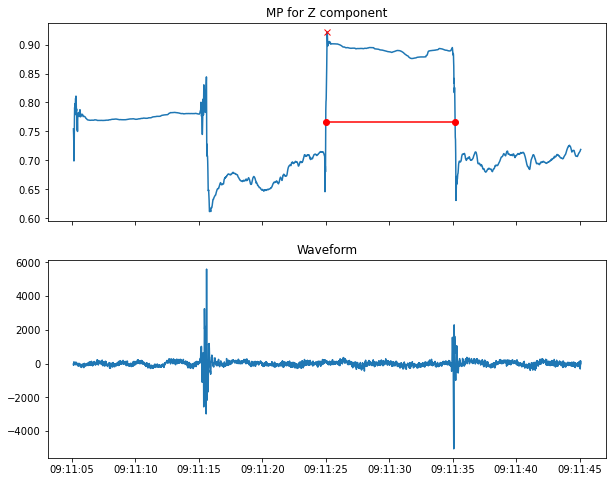

Peak height = 0.950240
Prominence = 0.395643
Width = 1346.222141
Width height = 0.752419


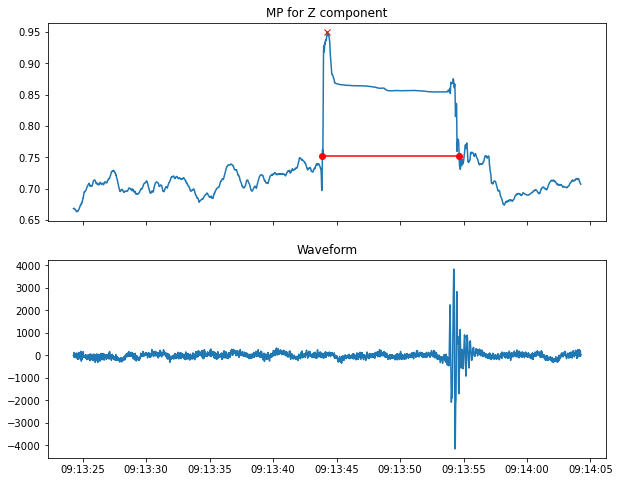

Peak height = 0.942770
Prominence = 0.324167
Width = 1307.561108
Width height = 0.780686


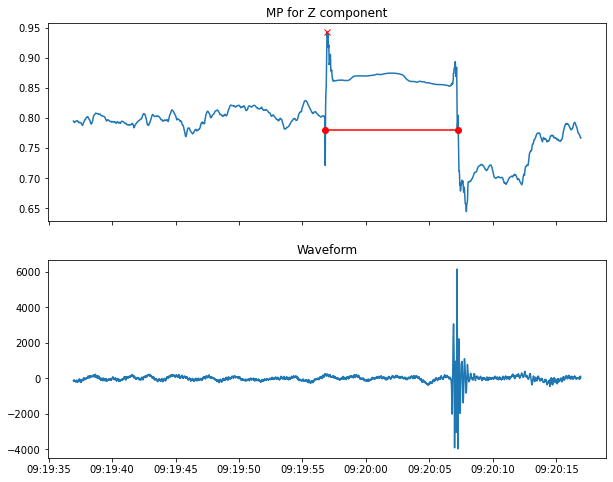

Peak height = 0.927137
Prominence = 0.347669
Width = 1331.215537
Width height = 0.753302


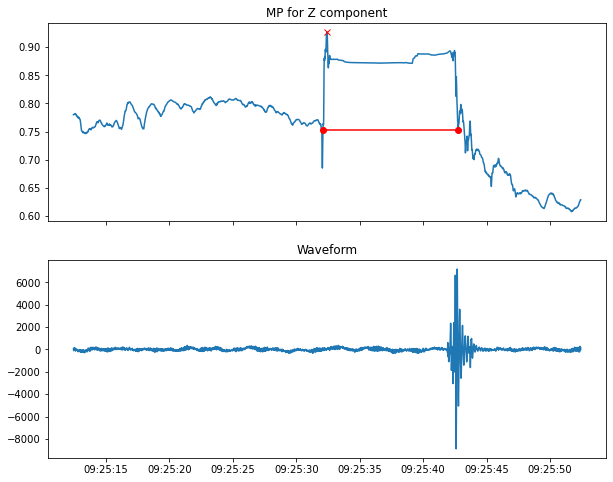

Peak height = 0.923844
Prominence = 0.316129
Width = 1354.741746
Width height = 0.765779


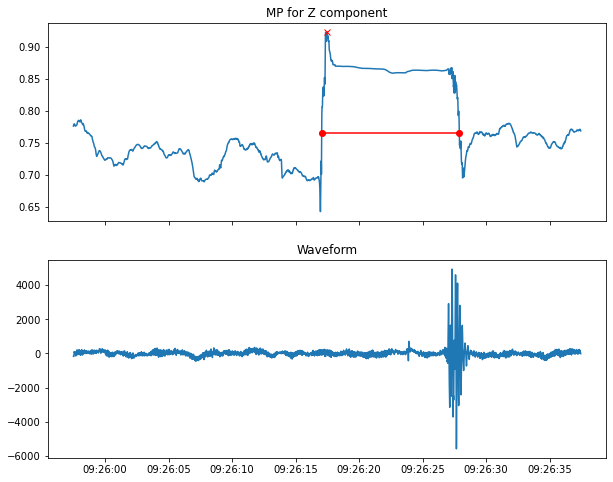

Peak height = 0.968892
Prominence = 0.445429
Width = 1326.903413
Width height = 0.746177


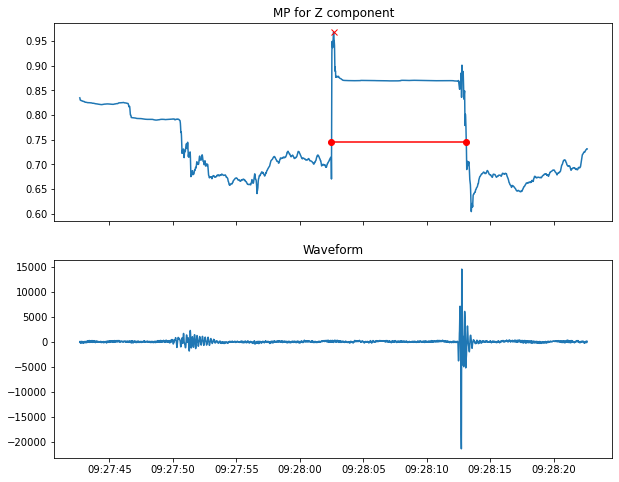

Peak height = 0.964115
Prominence = 0.405790
Width = 1305.881570
Width height = 0.761220


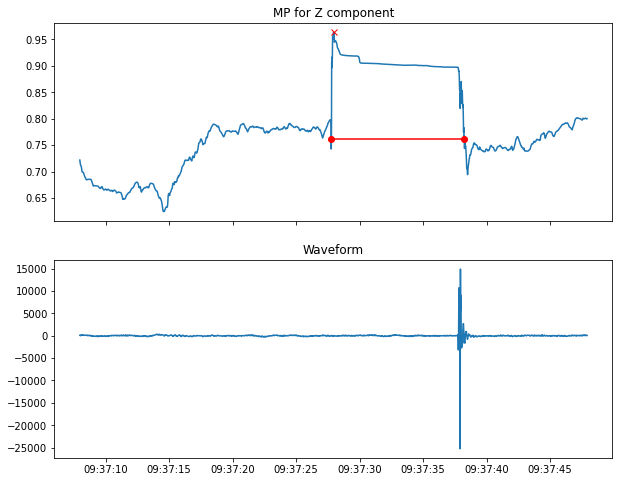

Peak height = 0.943684
Prominence = 0.390714
Width = 1444.343650
Width height = 0.748327


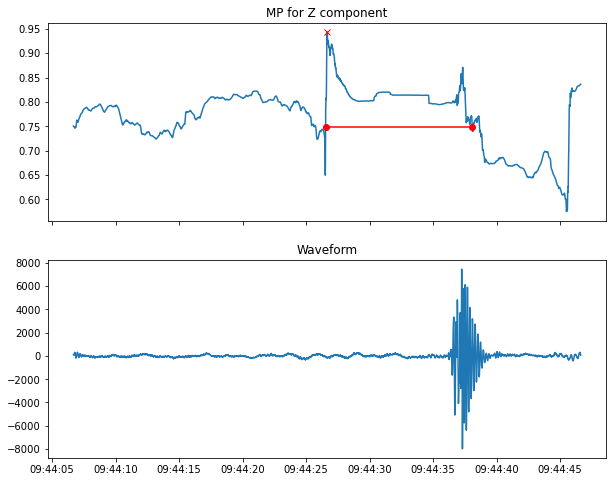

Peak height = 0.966384
Prominence = 0.439986
Width = 1306.919462
Width height = 0.746391


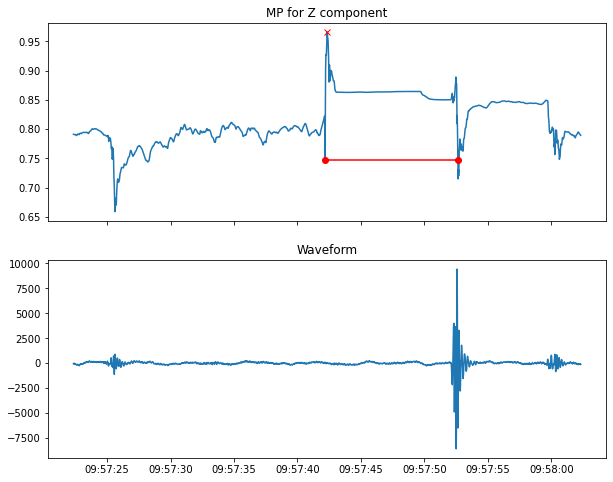

Peak height = 0.965765
Prominence = 0.336295
Width = 1301.007225
Width height = 0.797617


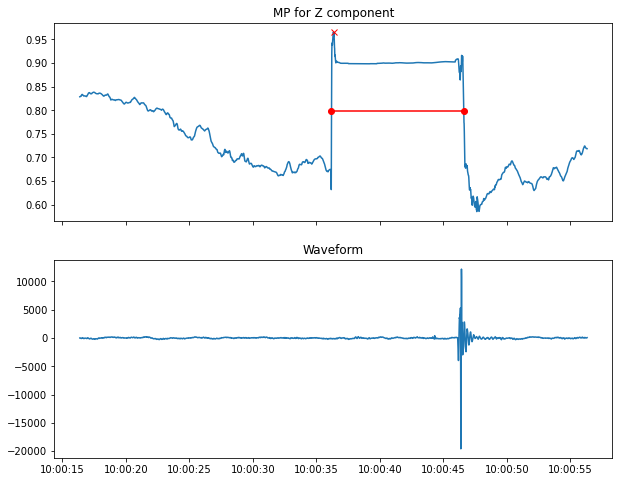

Peak height = 0.865908
Prominence = 0.305487
Width = 959.786403
Width height = 0.713164


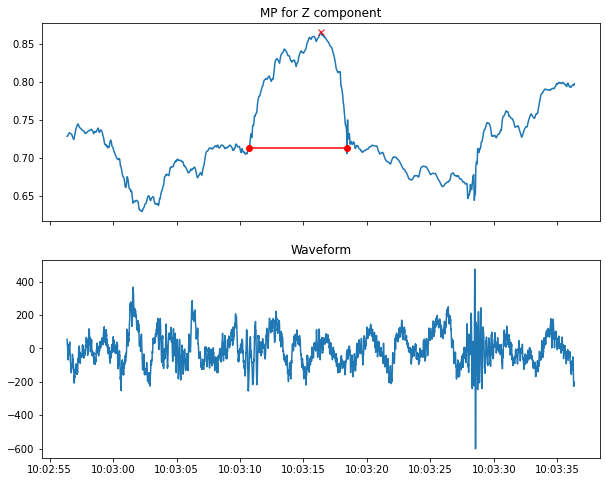

Peak height = 0.959380
Prominence = 0.407777
Width = 1366.297649
Width height = 0.755491


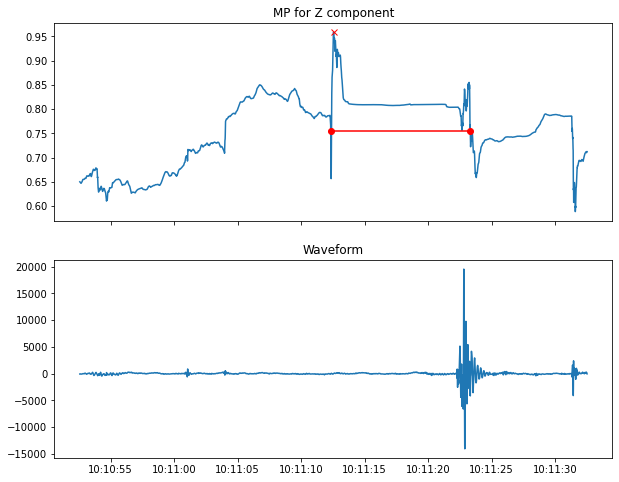

Peak height = 0.964692
Prominence = 0.420390
Width = 1308.179901
Width height = 0.754496


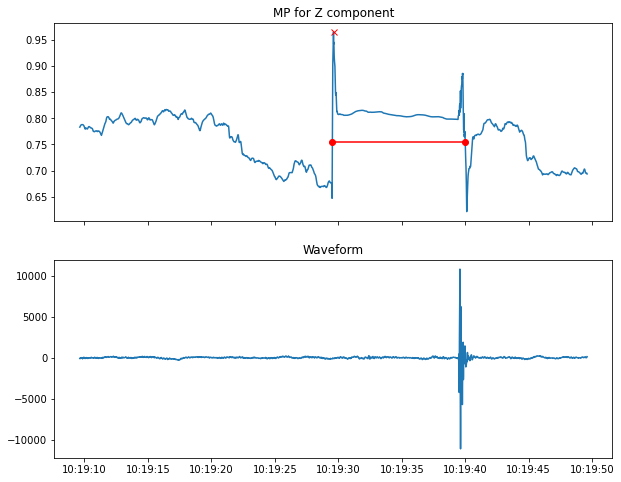

Peak height = 0.897006
Prominence = 0.330159
Width = 1264.616207
Width height = 0.731926


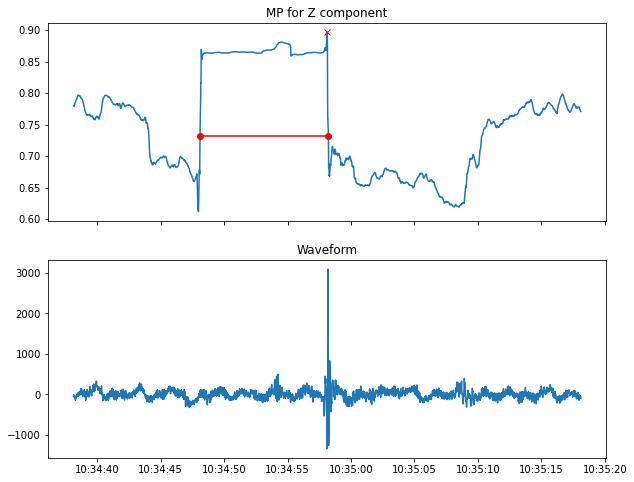

Peak height = 0.923592
Prominence = 0.365189
Width = 1274.407932
Width height = 0.740998


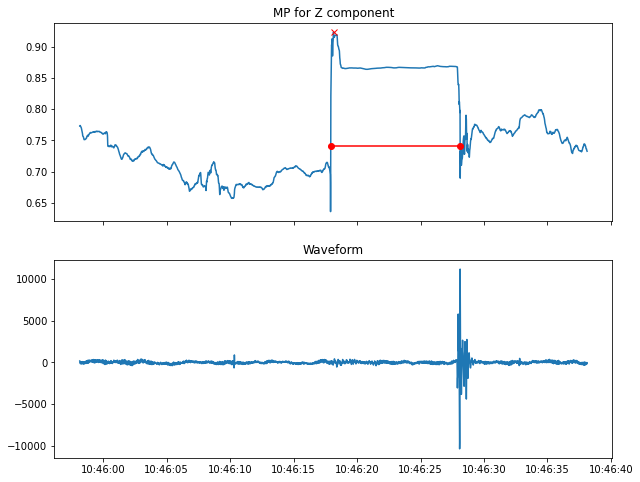

Peak height = 0.926438
Prominence = 0.338216
Width = 1268.676214
Width height = 0.757330


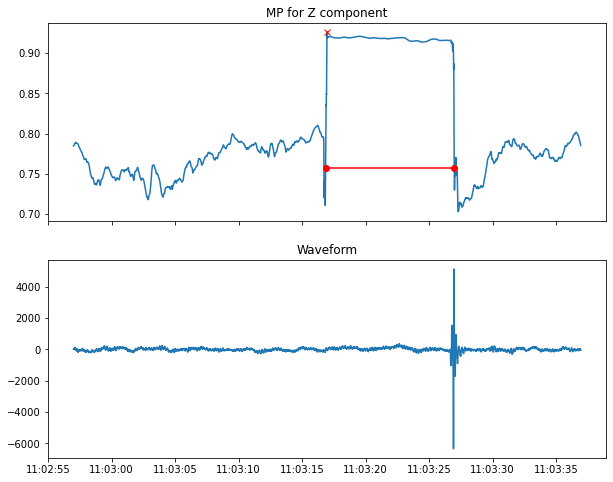

Peak height = 0.963558
Prominence = 0.412304
Width = 1355.401175
Width height = 0.757406


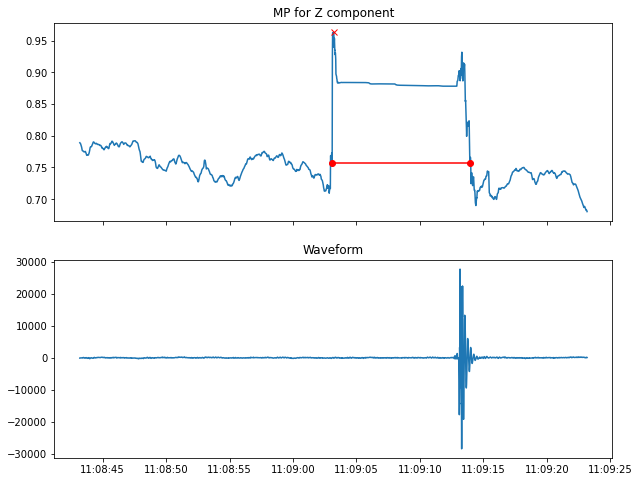

Peak height = 0.920661
Prominence = 0.313322
Width = 1341.934085
Width height = 0.763999


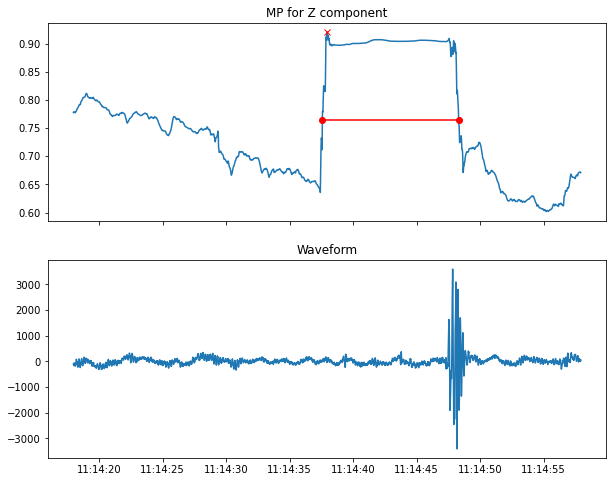

Peak height = 0.952820
Prominence = 0.386977
Width = 1373.136134
Width height = 0.759332


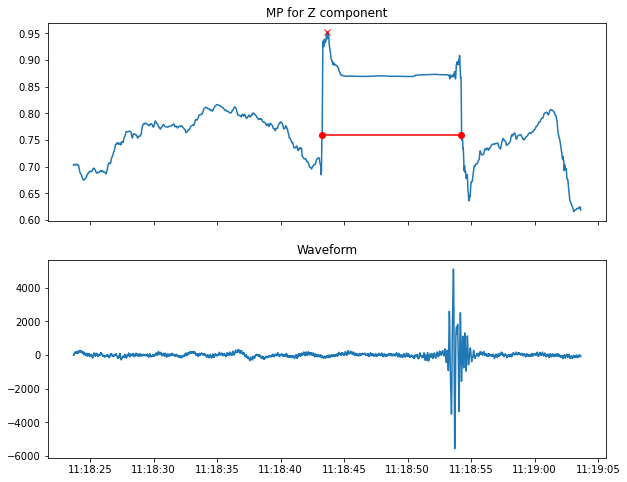

Peak height = 0.853164
Prominence = 0.307535
Width = 1250.432224
Width height = 0.699397


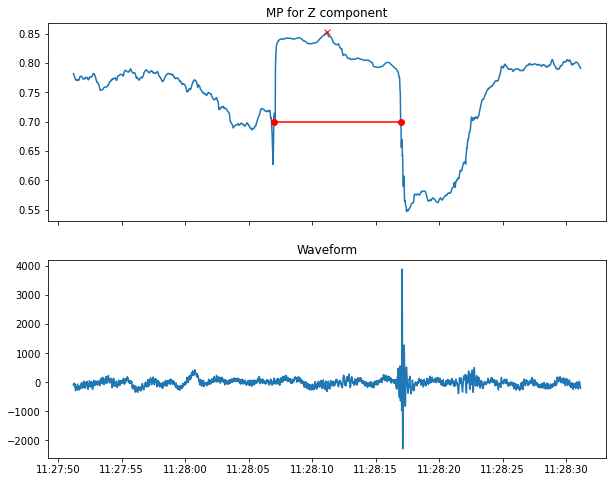

Peak height = 0.911225
Prominence = 0.380137
Width = 1289.168983
Width height = 0.721156


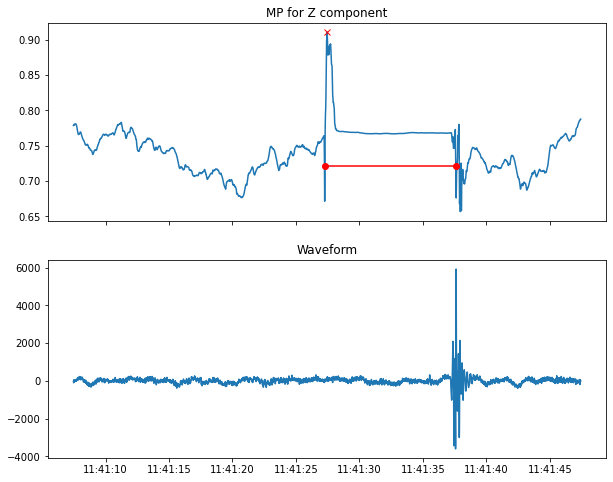

Peak height = 0.898085
Prominence = 0.415673
Width = 1453.783140
Width height = 0.690249


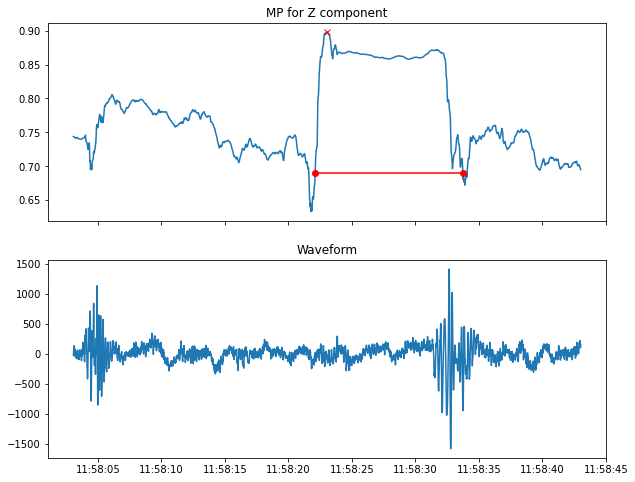

Peak height = 0.981836
Prominence = 0.554090
Width = 1339.030589
Width height = 0.704791


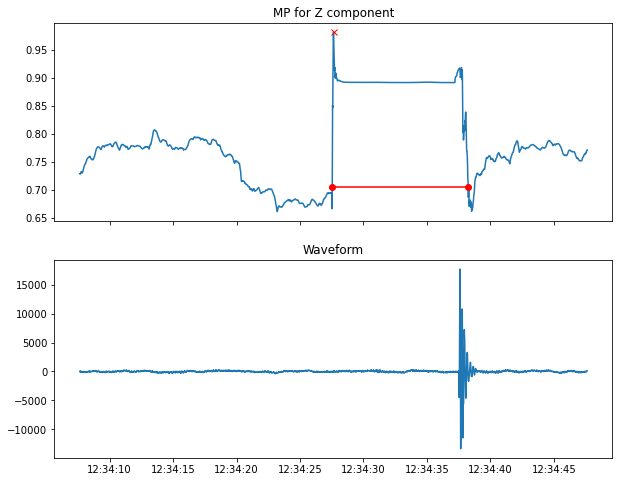

Peak height = 0.889276
Prominence = 0.303545
Width = 1346.609630
Width height = 0.737504


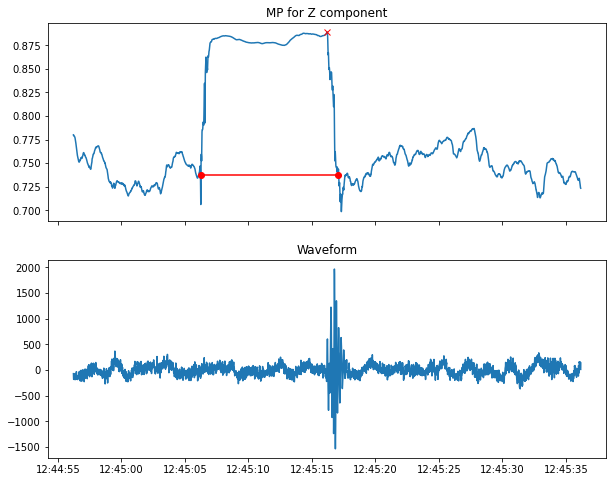

Peak height = 0.943232
Prominence = 0.361756
Width = 1308.599066
Width height = 0.762354


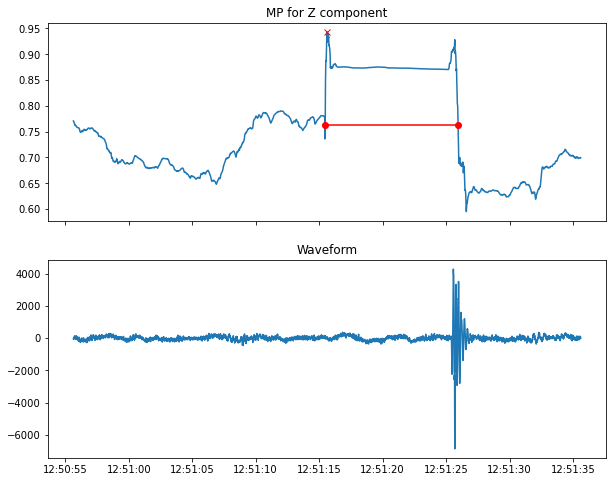

Peak height = 0.905599
Prominence = 0.351639
Width = 1319.778966
Width height = 0.729779


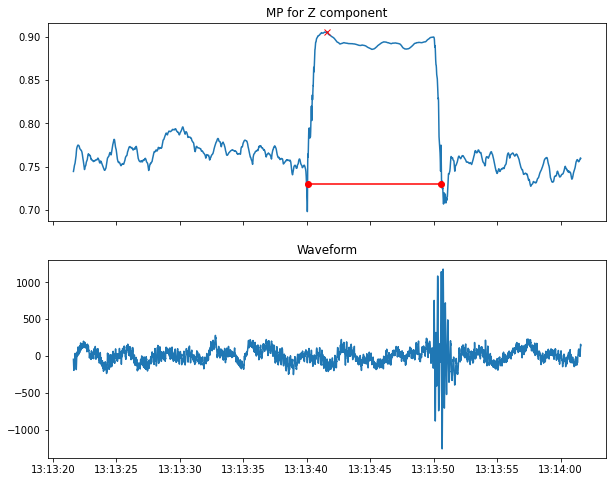

Peak height = 0.980882
Prominence = 0.485345
Width = 1318.032334
Width height = 0.738210


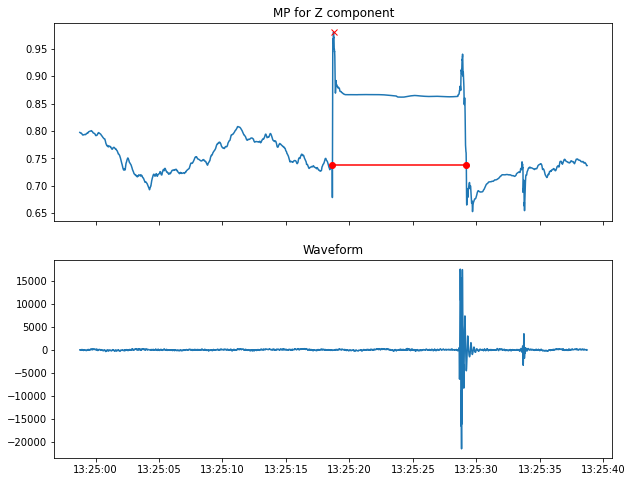

Peak height = 0.852765
Prominence = 0.343449
Width = 1345.448403
Width height = 0.681041


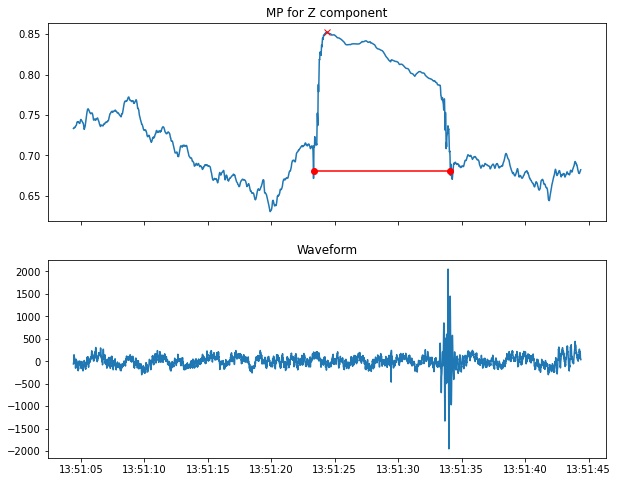

Peak height = 0.752289
Prominence = 0.325706
Width = 1128.777055
Width height = 0.589437


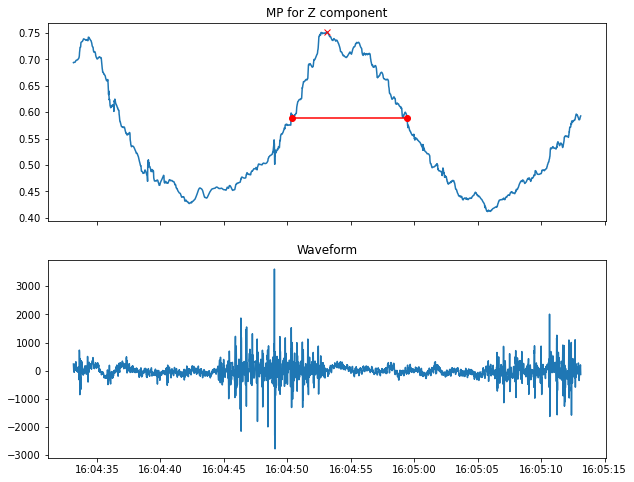

Peak height = 0.701061
Prominence = 0.391570
Width = 1318.060847
Width height = 0.505276


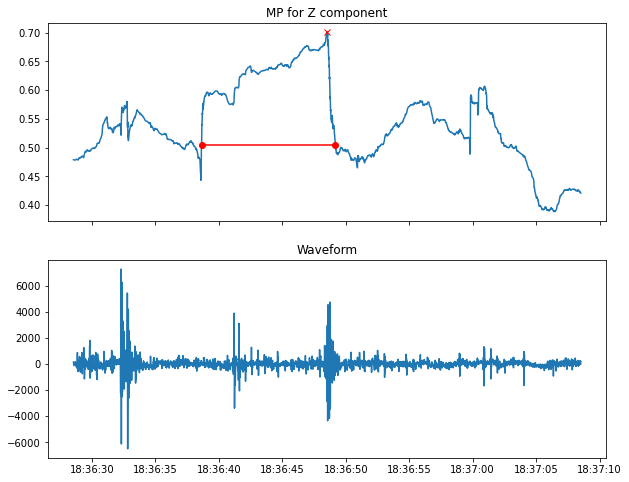

Peak height = 0.741751
Prominence = 0.400214
Width = 1276.411149
Width height = 0.541644


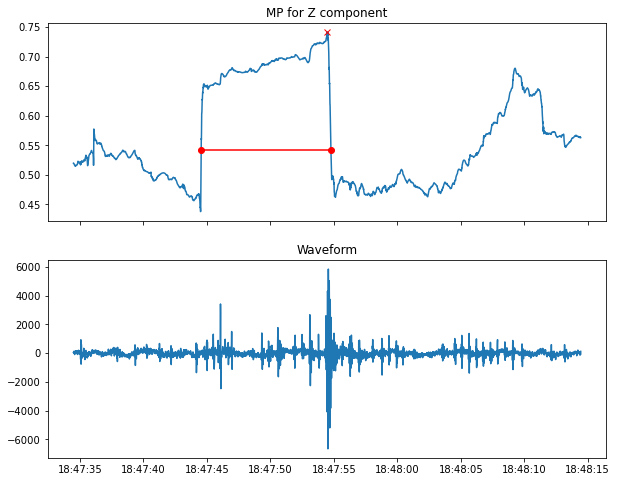

Peak height = 0.750745
Prominence = 0.445858
Width = 1266.983690
Width height = 0.527816


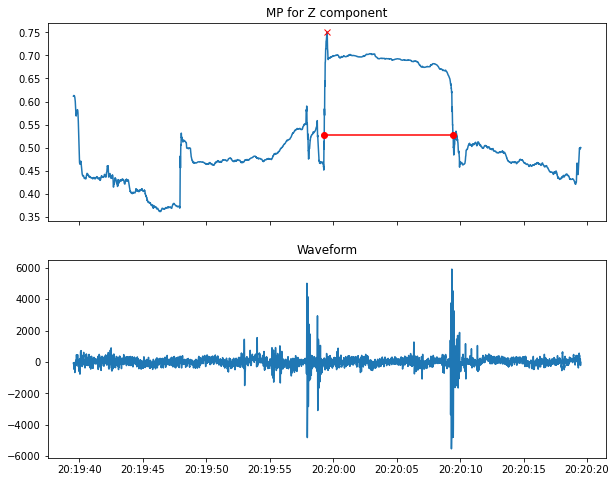

Peak height = 0.734147
Prominence = 0.328144
Width = 1281.812294
Width height = 0.570075


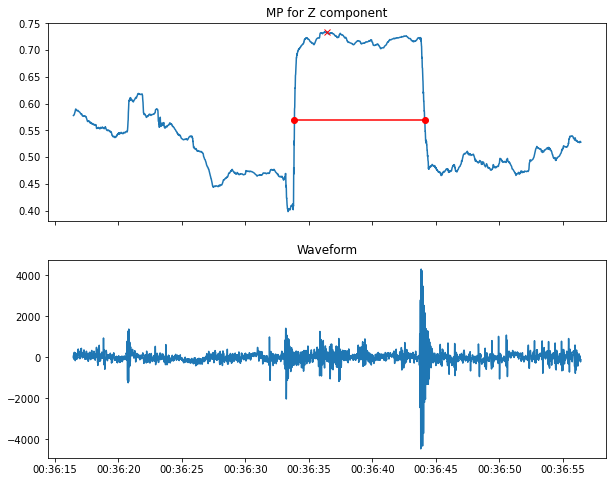

Peak height = 0.776875
Prominence = 0.368948
Width = 1280.398218
Width height = 0.592401


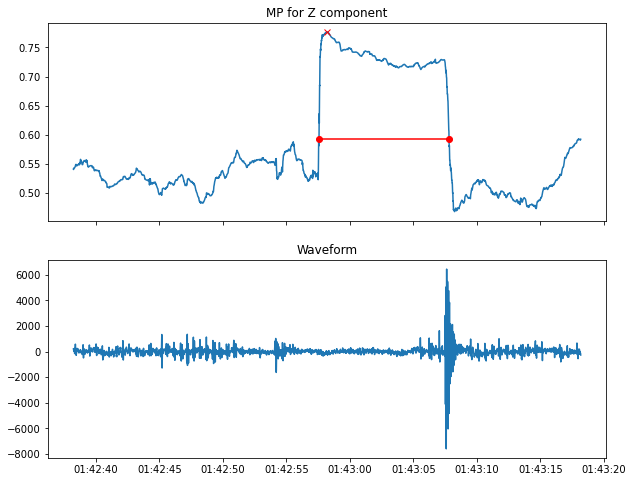

Peak height = 0.904724
Prominence = 0.325586
Width = 1274.341542
Width height = 0.741931


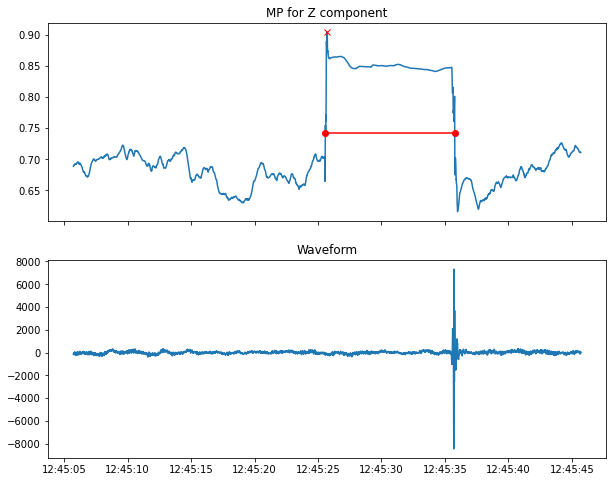

Peak height = 0.932932
Prominence = 0.436853
Width = 1271.215677
Width height = 0.714506


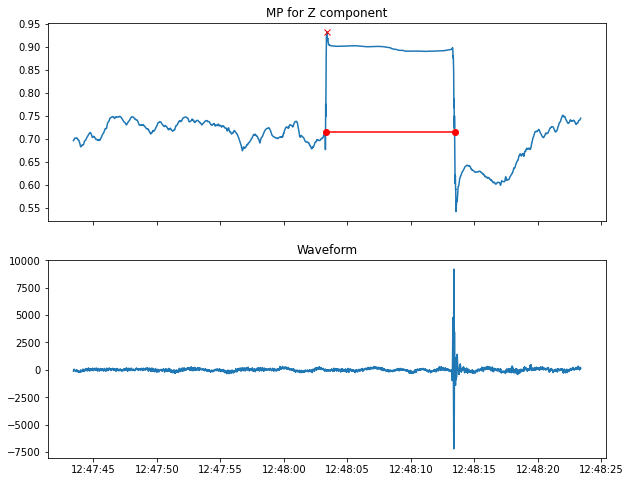

Peak height = 0.941754
Prominence = 0.420312
Width = 1277.539776
Width height = 0.731598


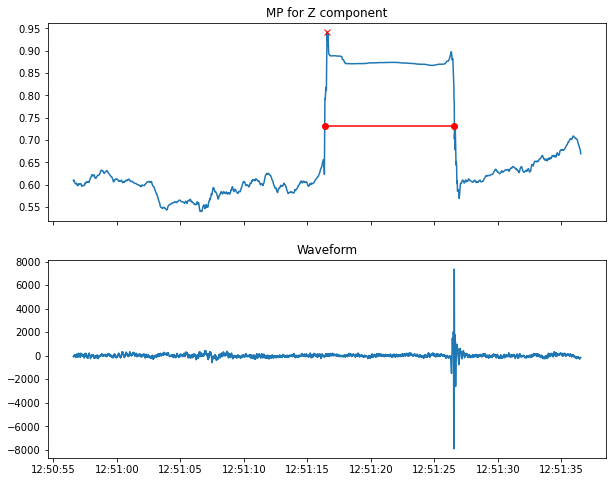

Peak height = 0.937495
Prominence = 0.394003
Width = 1384.197084
Width height = 0.740493


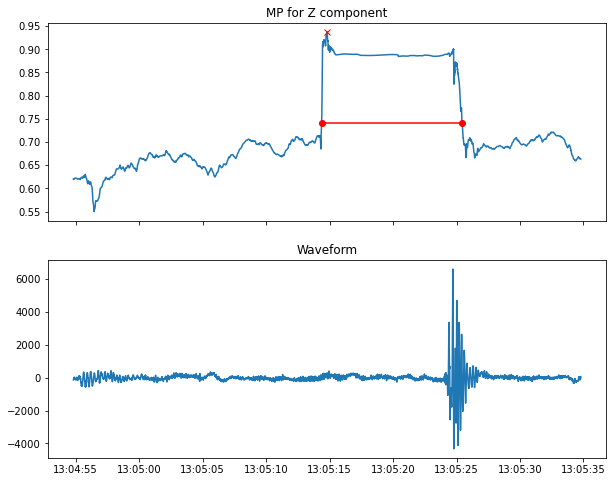

Peak height = 0.956238
Prominence = 0.447903
Width = 1308.744671
Width height = 0.732287


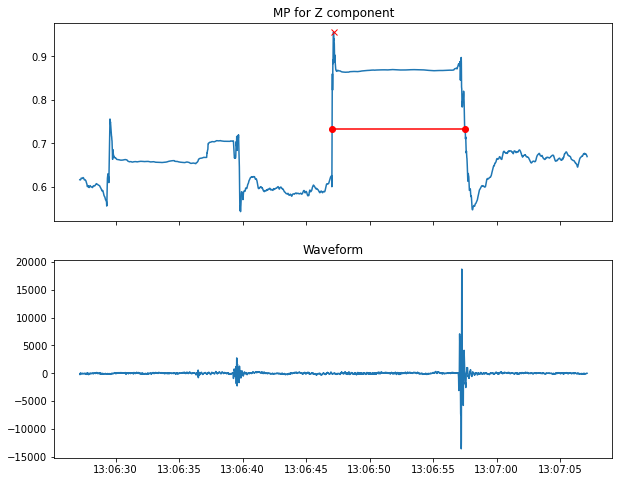

Peak height = 0.848326
Prominence = 0.300774
Width = 295.547543
Width height = 0.697939


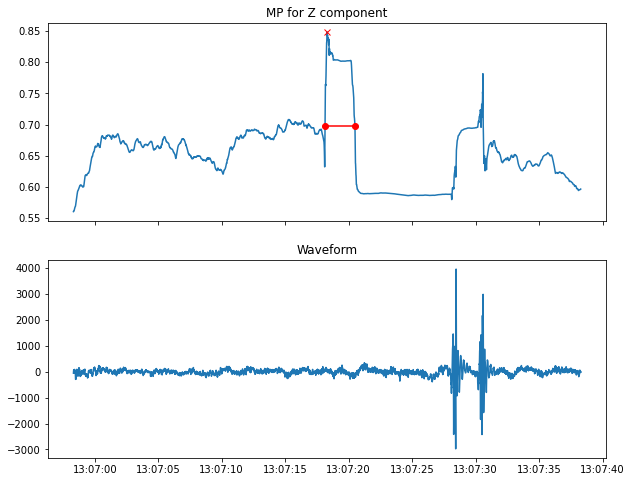

Peak height = 0.952907
Prominence = 0.421095
Width = 1315.582656
Width height = 0.742360


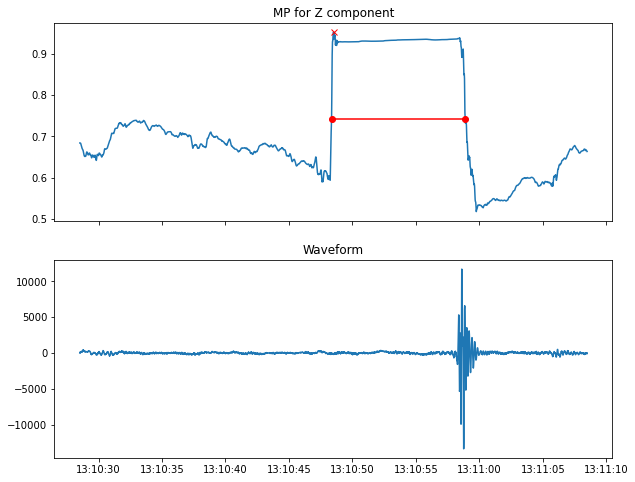

Peak height = 0.962493
Prominence = 0.485511
Width = 1413.390293
Width height = 0.719737


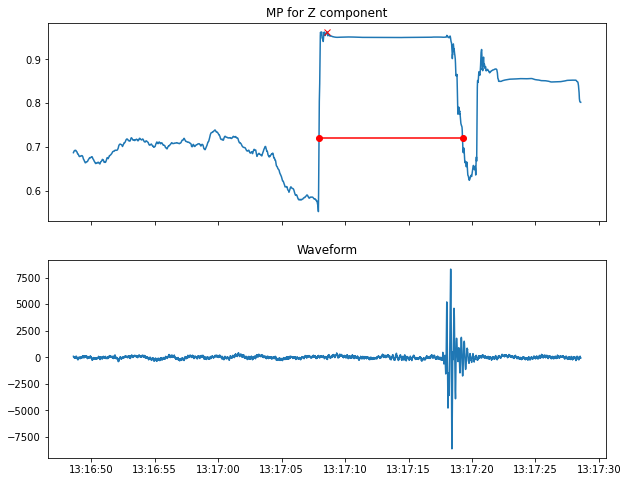

Peak height = 0.906865
Prominence = 0.351646
Width = 1314.340532
Width height = 0.731043


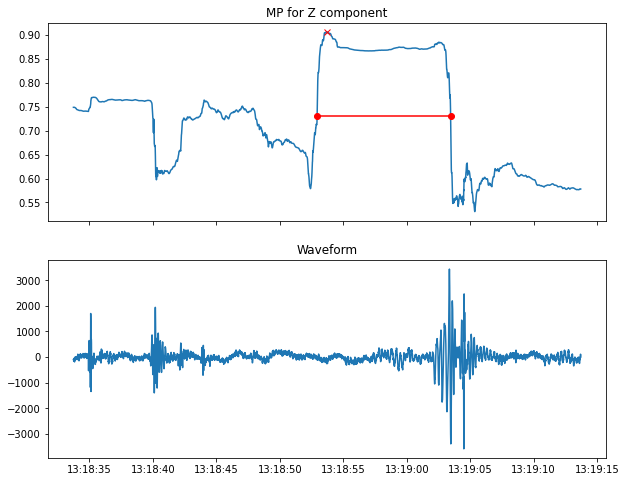

Peak height = 0.915104
Prominence = 0.388073
Width = 1280.897847
Width height = 0.721068


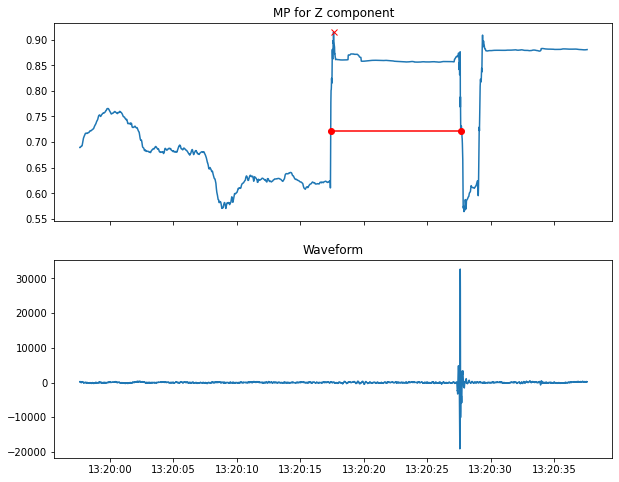

Peak height = 0.908840
Prominence = 0.344632
Width = 1301.304216
Width height = 0.736524


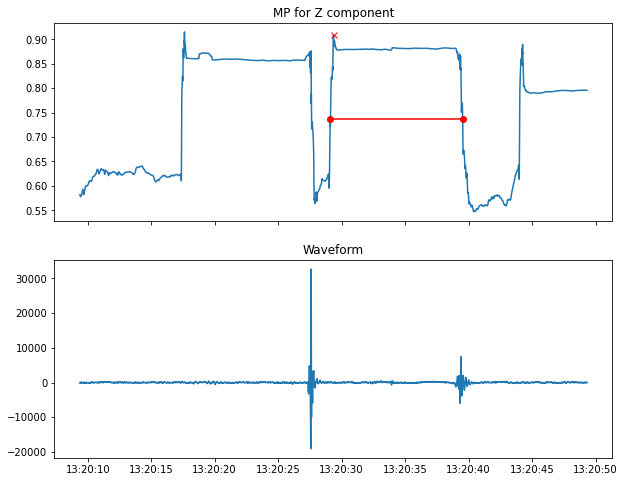

Peak height = 0.889687
Prominence = 0.342218
Width = 1296.951246
Width height = 0.718578


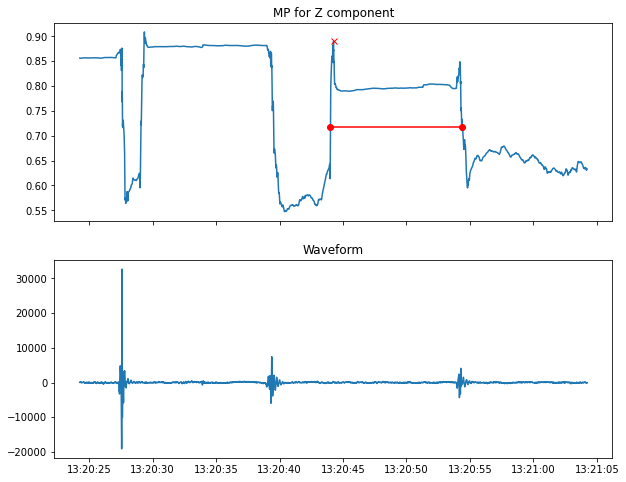

Peak height = 0.844190
Prominence = 0.341645
Width = 1275.743882
Width height = 0.673367


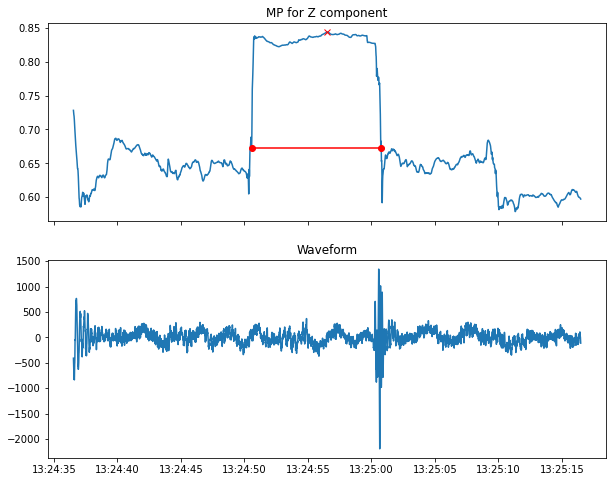

Peak height = 0.872999
Prominence = 0.329243
Width = 508.272107
Width height = 0.708378


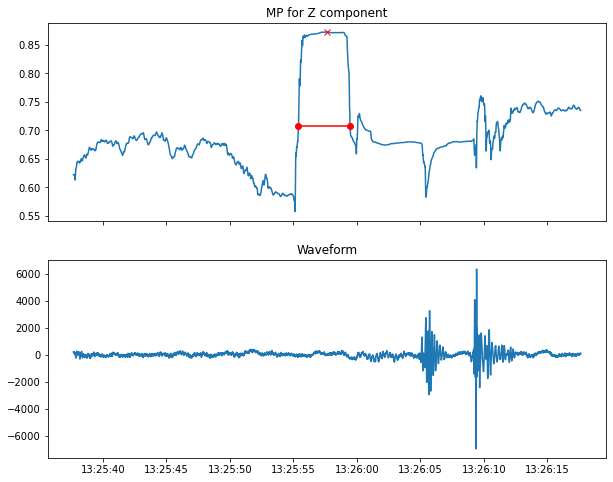

Peak height = 0.942531
Prominence = 0.463092
Width = 1364.383889
Width height = 0.710985


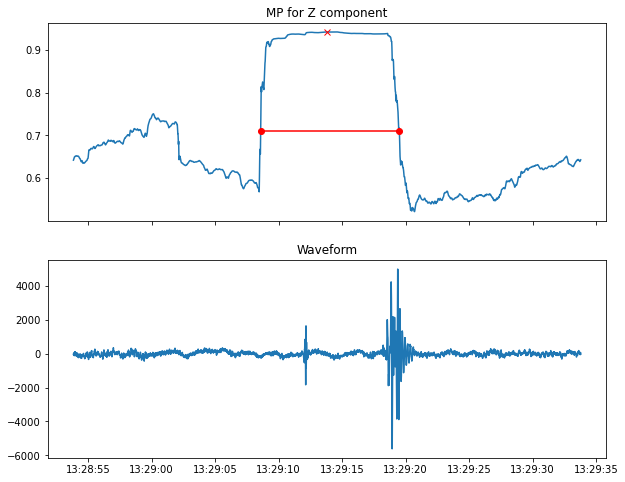

Peak height = 0.899811
Prominence = 0.378417
Width = 1311.654565
Width height = 0.710602


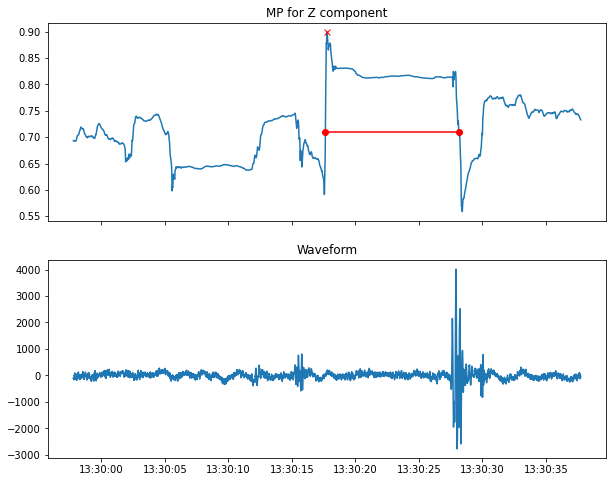

Peak height = 0.949499
Prominence = 0.382638
Width = 1298.116526
Width height = 0.758180


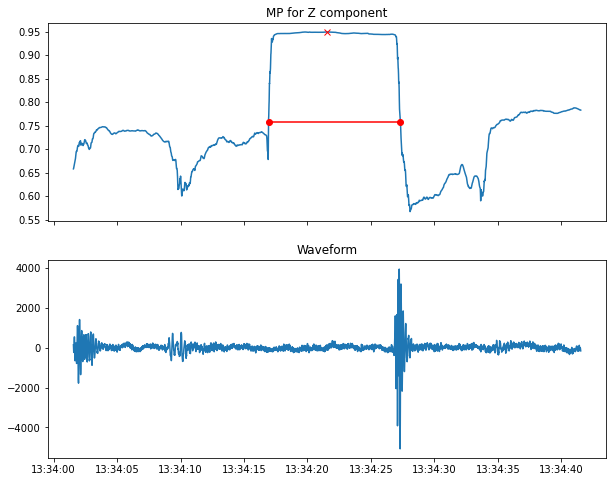

Peak height = 0.971129
Prominence = 0.510325
Width = 1403.035843
Width height = 0.715967


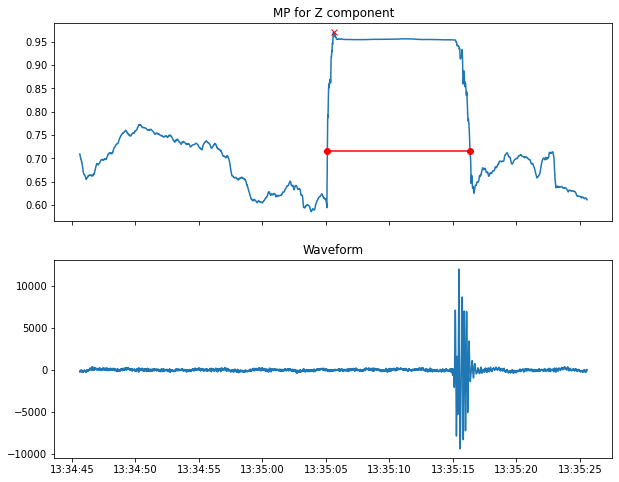

Peak height = 0.893757
Prominence = 0.326717
Width = 1374.416392
Width height = 0.730398


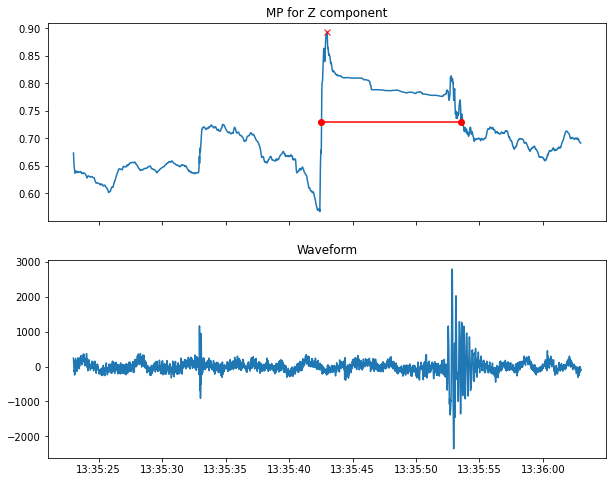

Peak height = 0.838853
Prominence = 0.307081
Width = 1294.933309
Width height = 0.685312


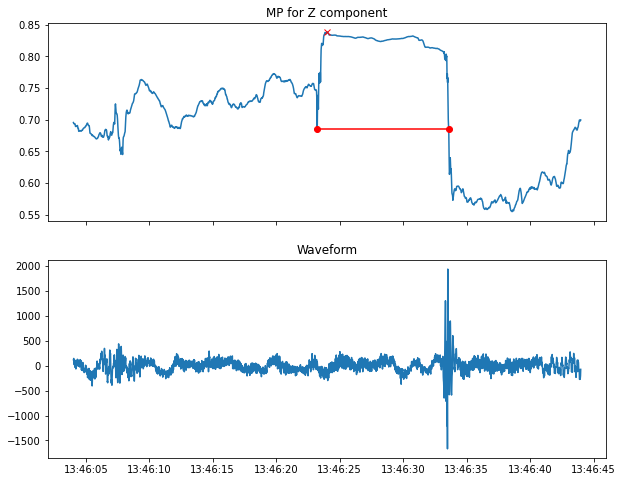

Peak height = 0.921159
Prominence = 0.390792
Width = 1378.676589
Width height = 0.725763


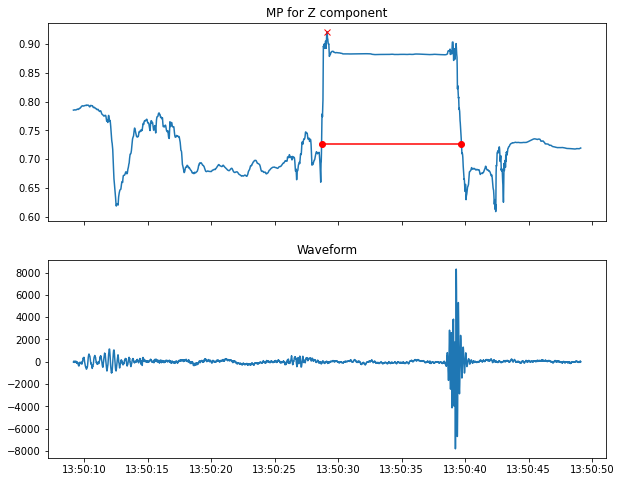

Peak height = 0.875821
Prominence = 0.330358
Width = 1247.917443
Width height = 0.710642


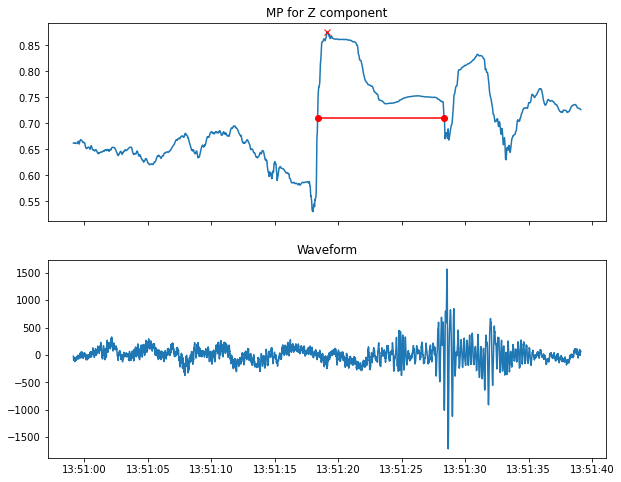

Peak height = 0.952696
Prominence = 0.351249
Width = 1456.801935
Width height = 0.777072


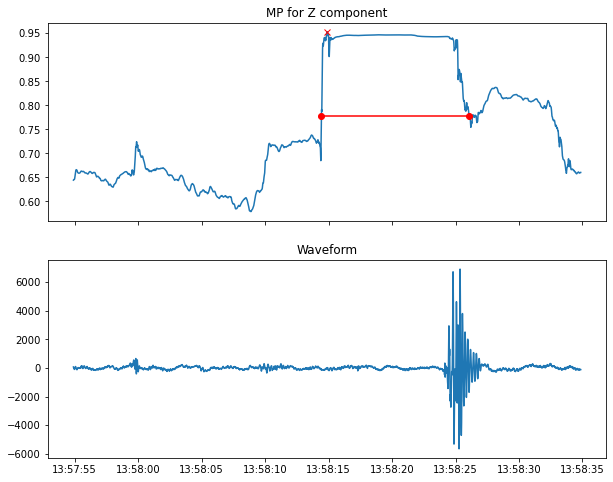

Peak height = 0.938746
Prominence = 0.314544
Width = 1279.829291
Width height = 0.781474


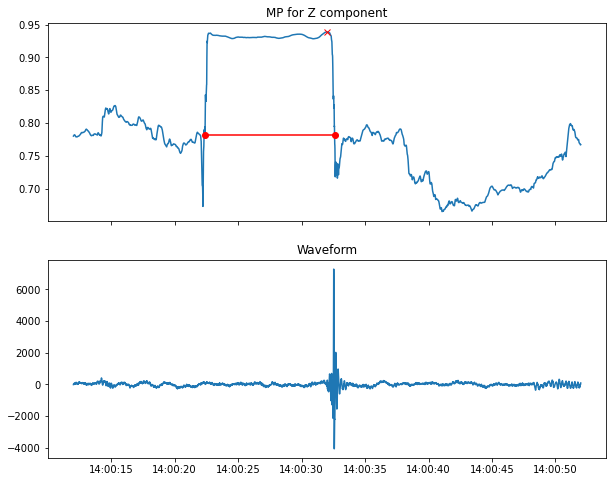

Peak height = 0.893286
Prominence = 0.318345
Width = 1329.081424
Width height = 0.734114


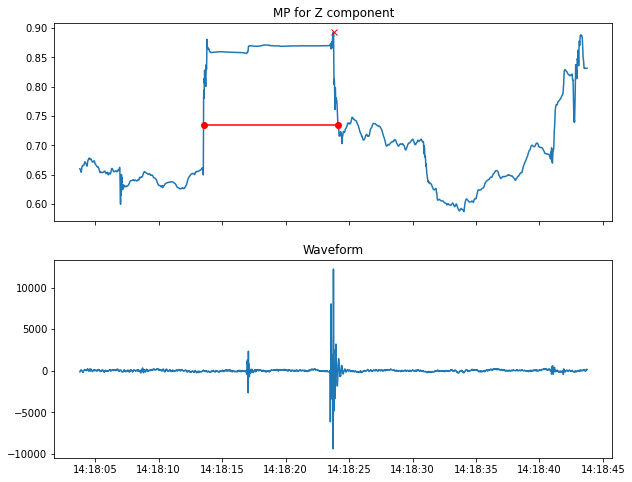

Peak height = 0.888278
Prominence = 0.300904
Width = 370.893601
Width height = 0.737826


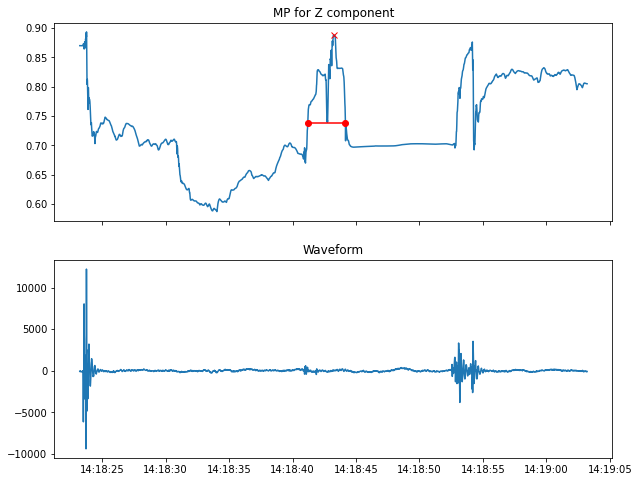

Peak height = 0.703663
Prominence = 0.307661
Width = 1248.534773
Width height = 0.549832


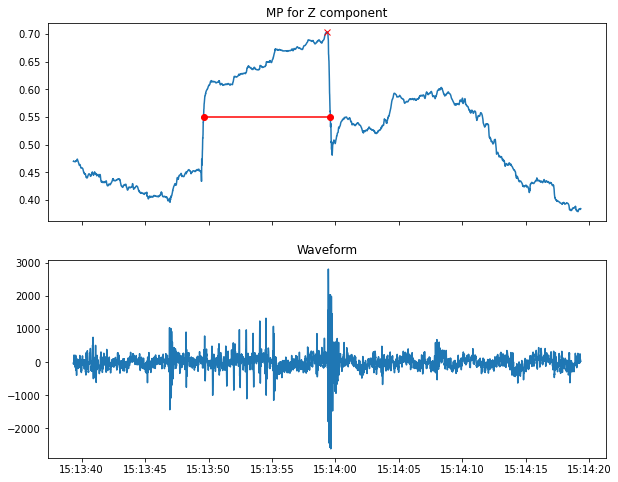

Peak height = 0.700834
Prominence = 0.321627
Width = 1095.761414
Width height = 0.540021


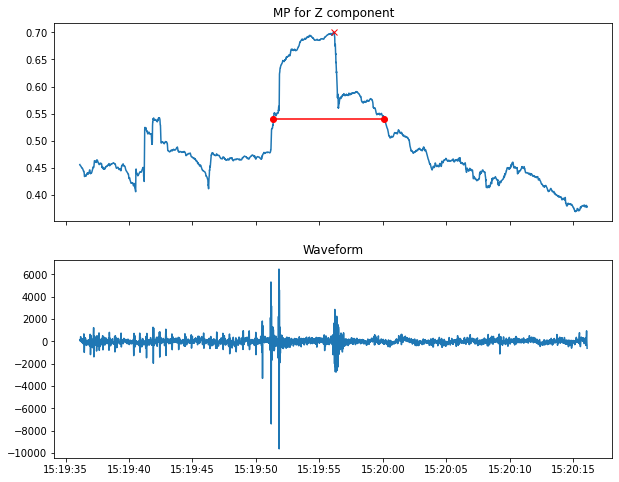

Peak height = 0.717352
Prominence = 0.317871
Width = 1257.648982
Width height = 0.558417


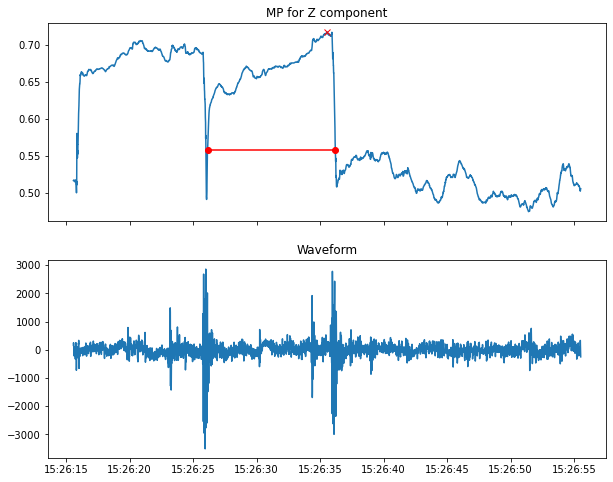

Peak height = 0.748182
Prominence = 0.310518
Width = 356.100473
Width height = 0.592923


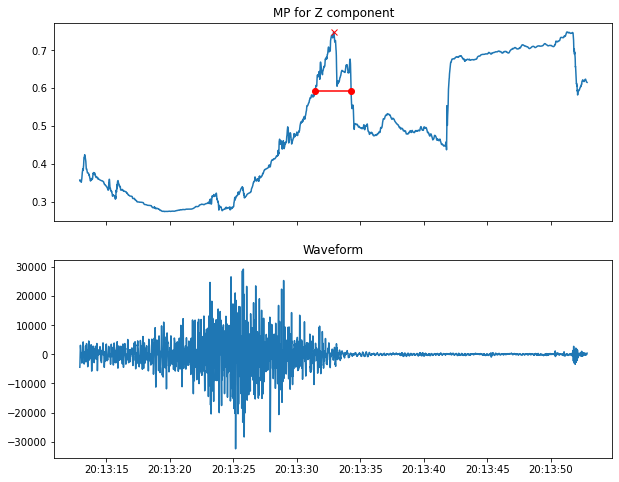

Peak height = 0.750078
Prominence = 0.336425
Width = 1285.772487
Width height = 0.581866


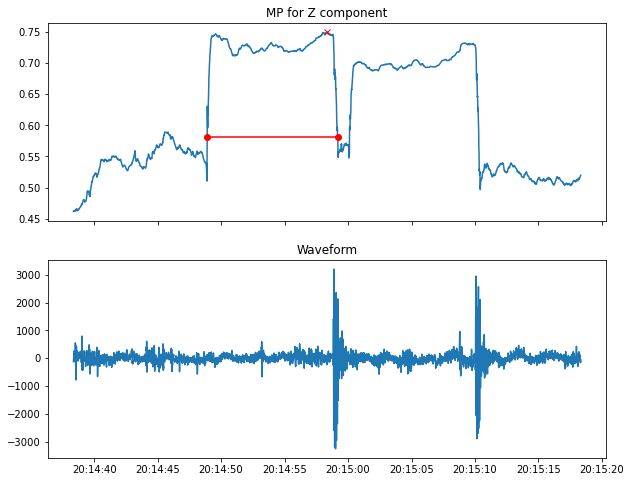

In [111]:
for idx in range(0,len(peaks)):
    print("Peak height = %f" % properties["peak_heights"][idx])
    print("Prominence = %f" % properties["prominences"][idx])
    print("Width = %f" % properties["widths"][idx])
    print("Width height = %f" % properties["width_heights"][idx])
    ips = peaks[idx] - sublen_samp*2
    ipe = peaks[idx] + sublen_samp*2
    fig, axs = plt.subplots(2,1,figsize=(10,8), sharex=True)
    axs.plot_date(t[ips:ipe], mprof[ips:ipe], marker=None, linestyle="-")
    axs.plot_date(t[peaks[idx]], mpstack[peaks[idx]],"x", color="red")
#     print([t[int(properties["left_ips"][idx])], t[int(properties["right_ips"][idx])]])
#     print([properties["width_heights"][idx],properties["width_heights"][idx]])
    axs[0].plot_date([t[int(properties["left_ips"][idx])], t[int(properties["right_ips"][idx])]],
                     [properties["width_heights"][idx],properties["width_heights"][idx]] , linestyle="-", color="red")
    axs[0].set_title("MP for Z component")

    plt.show()
    time.sleep(2)
    plt.close()

Peak height = 0.973005
Prominence = 0.473802
Width = 1374.195199
Width height = 0.736104
2020/03/09 09:08:30


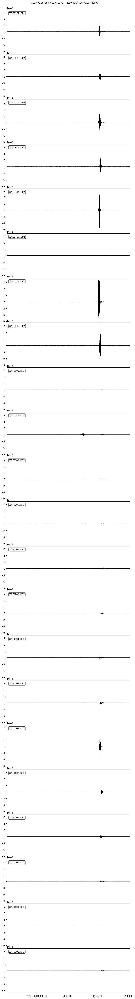

Peak height = 0.946563
Prominence = 0.321399
Width = 1307.858616
Width height = 0.785863
2020/03/09 09:43:06


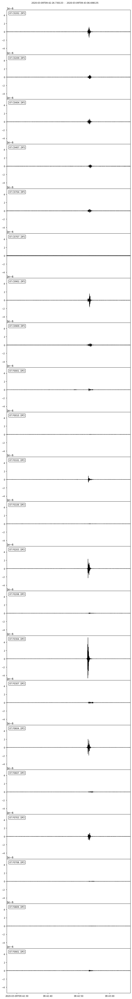

Peak height = 0.969652
Prominence = 0.346527
Width = 1279.838794
Width height = 0.796388
2020/03/09 09:50:41


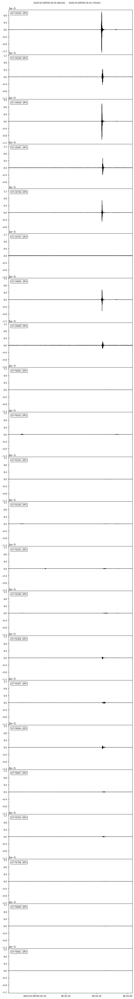

Peak height = 0.929256
Prominence = 0.311081
Width = 100.432822
Width height = 0.773716
2020/03/09 09:53:35


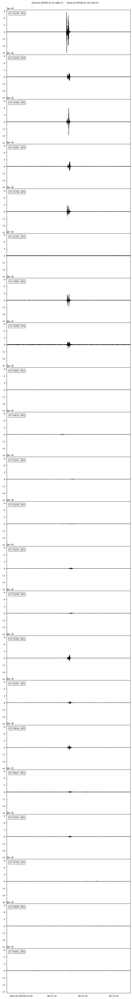

Peak height = 0.944781
Prominence = 0.346566
Width = 75.509703
Width height = 0.771497
2020/03/09 09:56:12


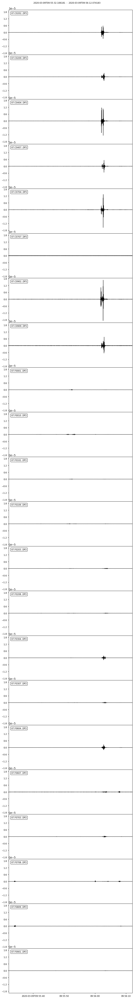

Peak height = 0.942529
Prominence = 0.388942
Width = 1375.524419
Width height = 0.748058
2020/03/09 09:59:17


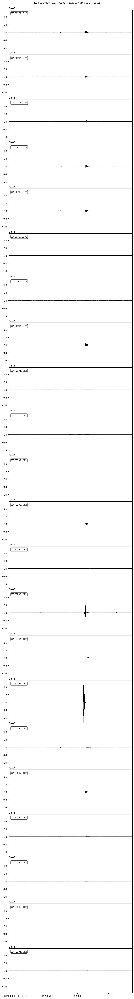

Peak height = 0.885283
Prominence = 0.331686
Width = 1288.321443
Width height = 0.719440
2020/03/09 10:04:32


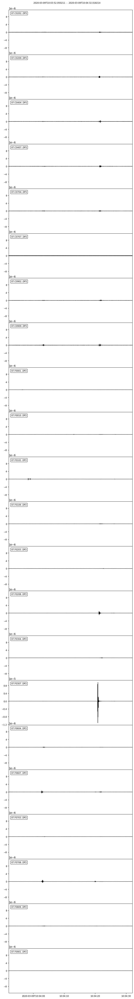

Peak height = 0.951327
Prominence = 0.338415
Width = 195.931097
Width height = 0.782120
2020/03/09 10:35:21


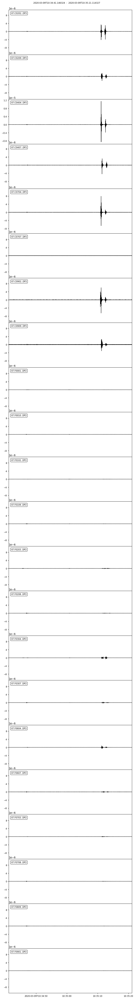

Peak height = 0.954889
Prominence = 0.374505
Width = 1406.386565
Width height = 0.767636
2020/03/09 10:38:13


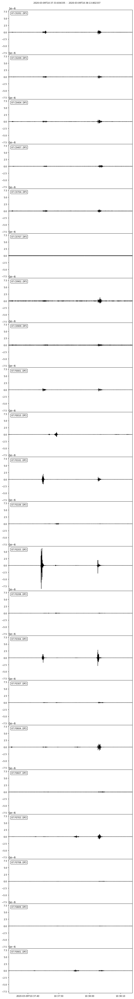

Peak height = 0.896456
Prominence = 0.305905
Width = 1354.029537
Width height = 0.743503
2020/03/09 10:40:42


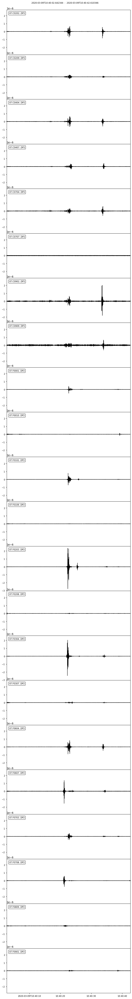

Peak height = 0.955464
Prominence = 0.389747
Width = 1305.635319
Width height = 0.760590
2020/03/09 10:42:42


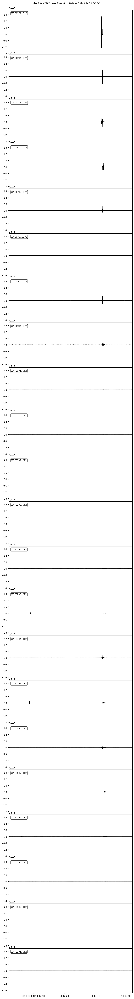

Peak height = 0.948489
Prominence = 0.308563
Width = 1291.285791
Width height = 0.794207
2020/03/09 10:43:06


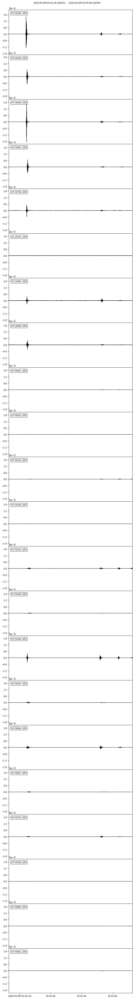

Peak height = 0.923580
Prominence = 0.321326
Width = 1335.427740
Width height = 0.762917
2020/03/09 10:44:34


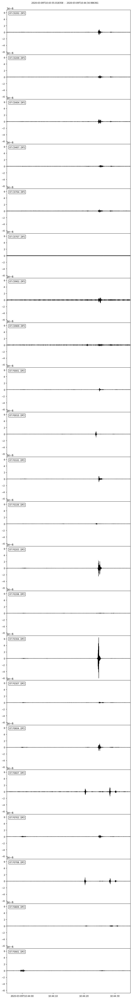

Peak height = 0.964759
Prominence = 0.412373
Width = 1304.917684
Width height = 0.758572
2020/03/09 10:46:43


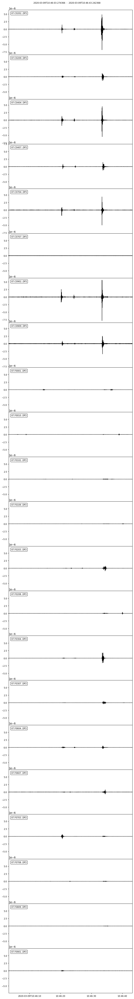

Peak height = 0.916455
Prominence = 0.311708
Width = 1359.036623
Width height = 0.760601
2020/03/09 10:47:31


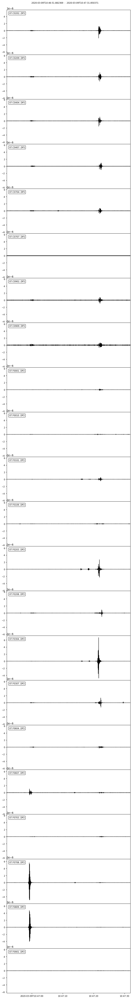

Peak height = 0.897294
Prominence = 0.320583
Width = 1300.662058
Width height = 0.737003
2020/03/09 10:51:50


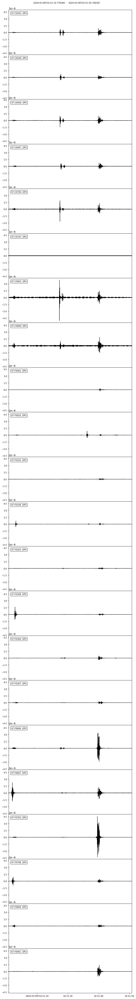

Peak height = 0.924513
Prominence = 0.354967
Width = 1264.681011
Width height = 0.747029
2020/03/09 10:59:56


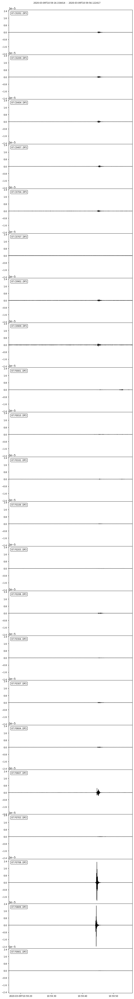

Peak height = 0.786676
Prominence = 0.302510
Width = 1312.954246
Width height = 0.635421
2020/03/09 15:37:48


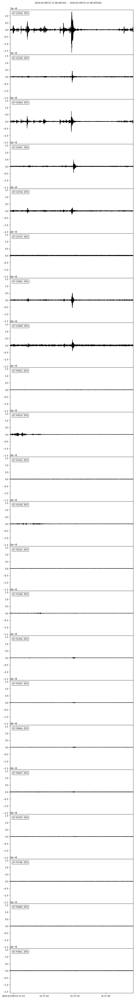

Peak height = 0.798025
Prominence = 0.447570
Width = 1279.655717
Width height = 0.574239
2020/03/09 15:38:55


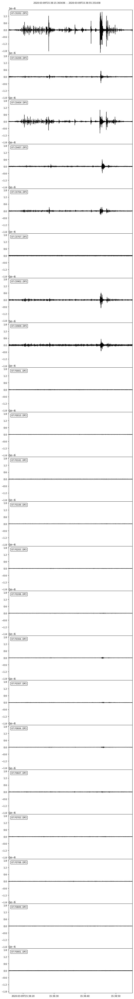

Peak height = 0.745167
Prominence = 0.390858
Width = 1312.657008
Width height = 0.549738
2020/03/09 19:33:28


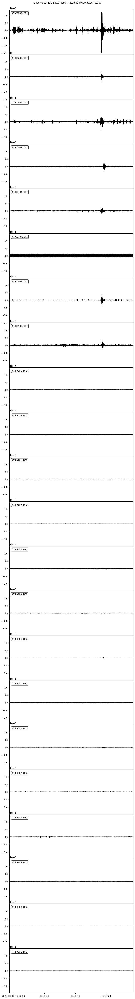

Peak height = 0.847366
Prominence = 0.309917
Width = 1190.857969
Width height = 0.692407
2020/03/09 21:33:42


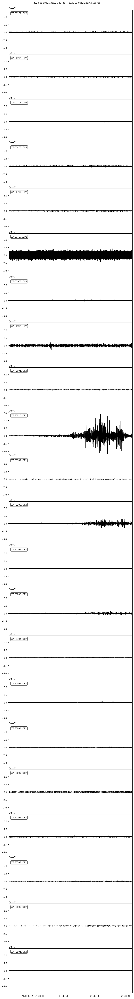

Peak height = 0.806248
Prominence = 0.360595
Width = 635.270062
Width height = 0.625951
2020/03/10 00:10:11


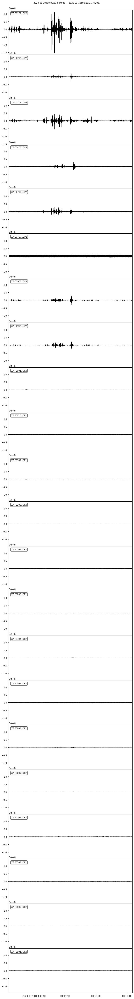

Peak height = 0.847279
Prominence = 0.376745
Width = 1367.258564
Width height = 0.658907
2020/03/10 01:10:44


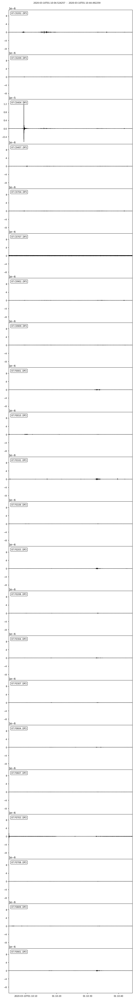

Peak height = 0.902872
Prominence = 0.473482
Width = 1347.353870
Width height = 0.666130
2020/03/10 01:15:15


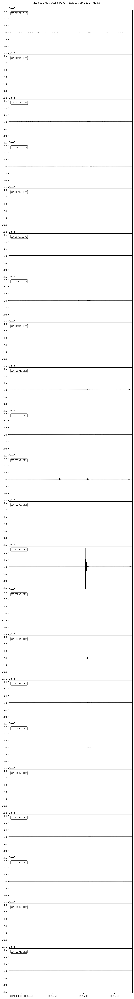

Peak height = 0.795242
Prominence = 0.377001
Width = 1295.019620
Width height = 0.606742
2020/03/10 01:25:08


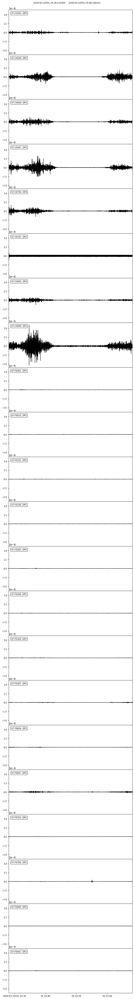

Peak height = 0.788469
Prominence = 0.363456
Width = 1287.697118
Width height = 0.606741
2020/03/10 01:42:33


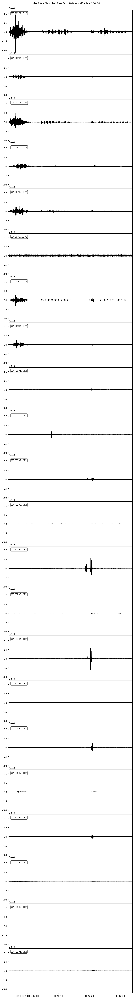

Peak height = 0.971737
Prominence = 0.424227
Width = 1337.606608
Width height = 0.759623
2020/03/10 02:00:56


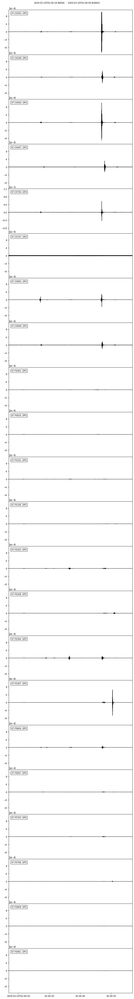

Peak height = 0.909577
Prominence = 0.301009
Width = 1333.947948
Width height = 0.759073
2020/03/10 02:35:41


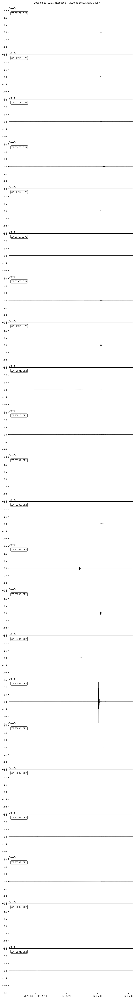

Peak height = 0.871417
Prominence = 0.304856
Width = 1292.881802
Width height = 0.718989
2020/03/10 03:06:24


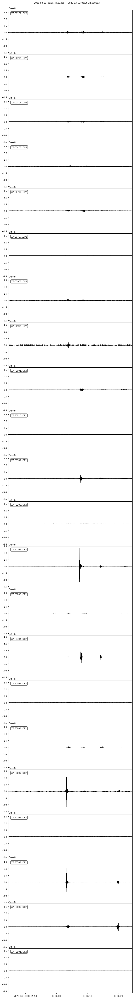

Peak height = 0.942736
Prominence = 0.377668
Width = 1275.167512
Width height = 0.753902
2020/03/10 03:10:23


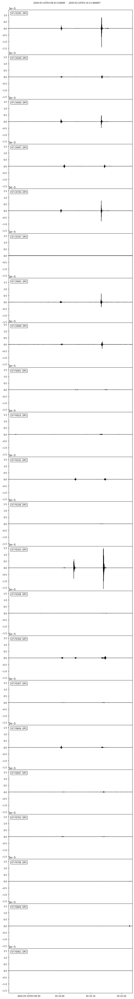

Peak height = 0.928593
Prominence = 0.347052
Width = 1343.968888
Width height = 0.755067
2020/03/10 03:12:54


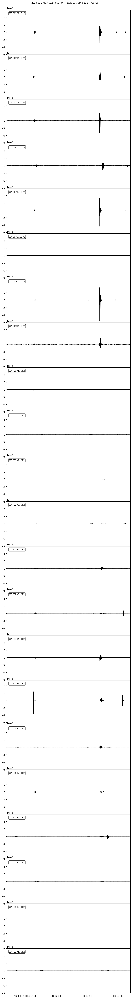

Peak height = 0.932367
Prominence = 0.386507
Width = 1261.871368
Width height = 0.739114
2020/03/10 03:14:34


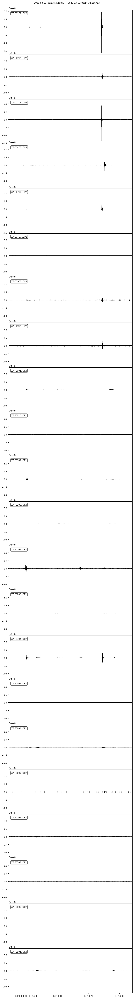

Peak height = 0.924513
Prominence = 0.401433
Width = 1259.497893
Width height = 0.723796
2020/03/10 03:16:18


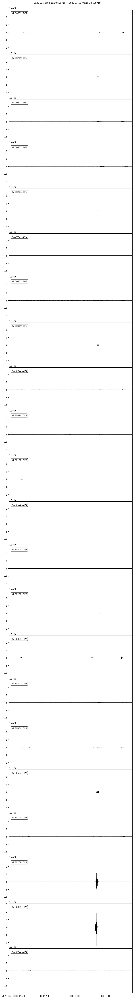

Peak height = 0.971033
Prominence = 0.477649
Width = 1381.385659
Width height = 0.732208
2020/03/10 03:18:30


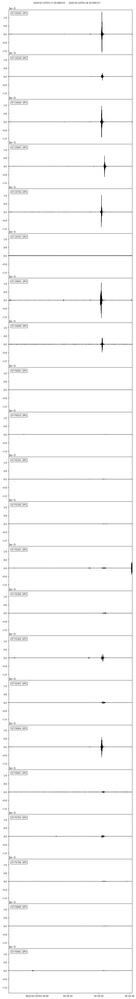

Peak height = 0.884986
Prominence = 0.361650
Width = 1262.171012
Width height = 0.704161
2020/03/10 03:21:08


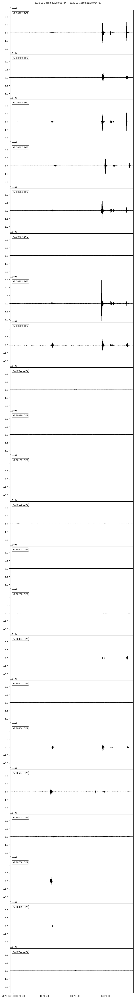

Peak height = 0.938270
Prominence = 0.423419
Width = 1312.501659
Width height = 0.726561
2020/03/10 03:23:26


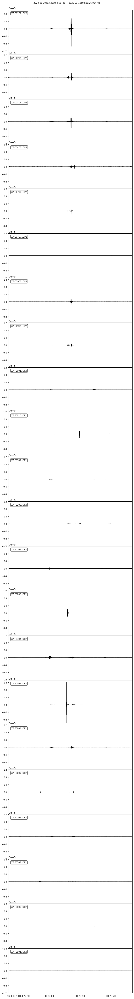

Peak height = 0.864681
Prominence = 0.312728
Width = 1374.796909
Width height = 0.708318
2020/03/10 03:32:45


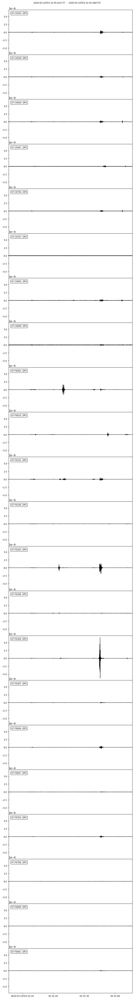

Peak height = 0.943530
Prominence = 0.391860
Width = 159.795947
Width height = 0.747600
2020/03/10 03:35:07


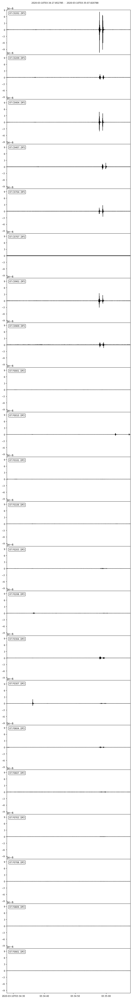

Peak height = 0.900317
Prominence = 0.325992
Width = 1317.635208
Width height = 0.737321
2020/03/10 03:37:04


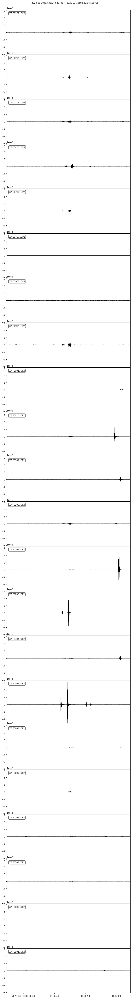

Peak height = 0.956004
Prominence = 0.415763
Width = 1461.505309
Width height = 0.748122
2020/03/10 03:39:10


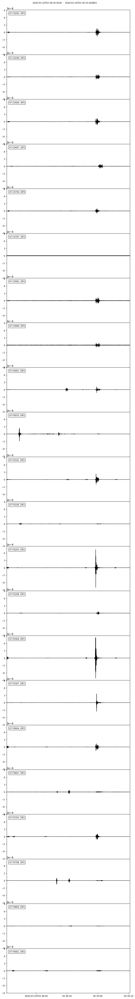

Peak height = 0.926911
Prominence = 0.363474
Width = 1401.859945
Width height = 0.745174
2020/03/10 03:40:59


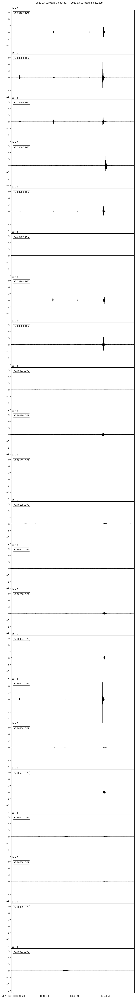

Peak height = 0.954652
Prominence = 0.387732
Width = 1287.640741
Width height = 0.760786
2020/03/10 03:47:57


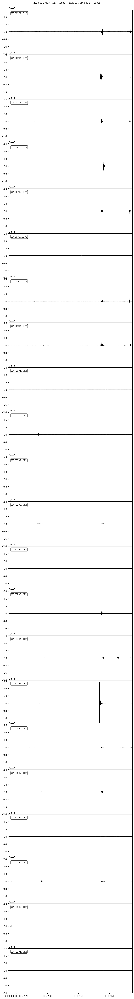

Peak height = 0.963406
Prominence = 0.447752
Width = 1382.346398
Width height = 0.739530
2020/03/10 03:49:17


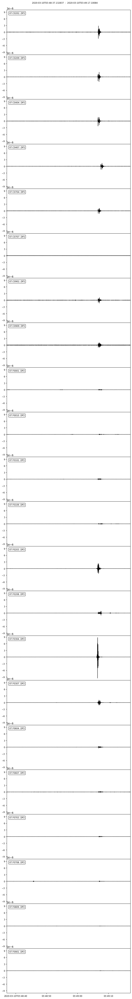

Peak height = 0.958600
Prominence = 0.444244
Width = 1424.506956
Width height = 0.736478
2020/03/10 03:53:21


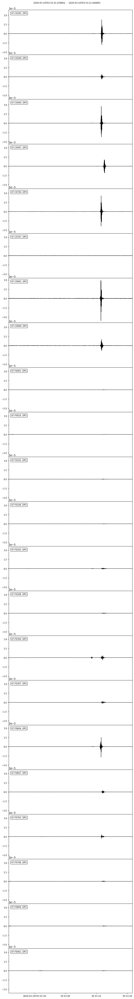

Peak height = 0.907056
Prominence = 0.385569
Width = 1303.068761
Width height = 0.714272
2020/03/10 03:55:37


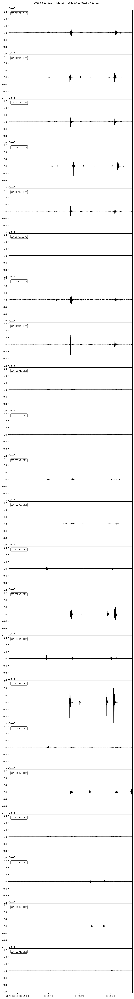

Peak height = 0.889935
Prominence = 0.347048
Width = 1306.623127
Width height = 0.716411
2020/03/10 03:55:50


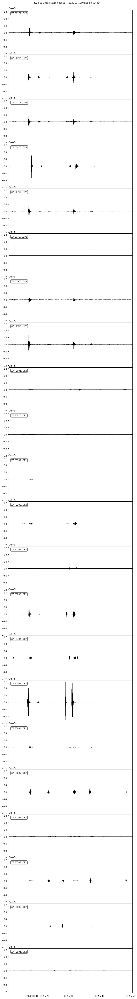

Peak height = 0.855348
Prominence = 0.311737
Width = 1295.803261
Width height = 0.699479
2020/03/10 03:56:22


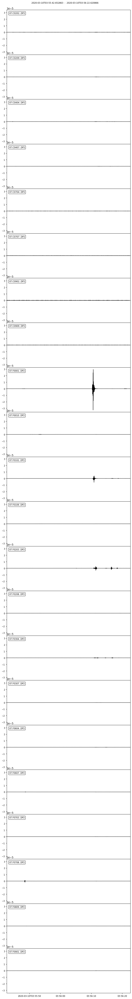

Peak height = 0.863566
Prominence = 0.320412
Width = 1427.686607
Width height = 0.703360
2020/03/10 03:56:50


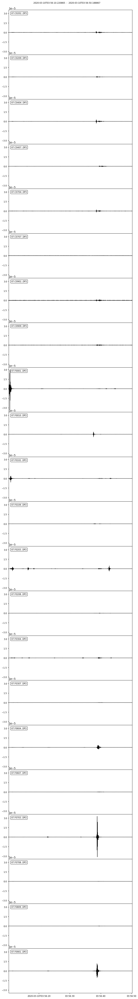

Peak height = 0.911375
Prominence = 0.392604
Width = 1360.772798
Width height = 0.715073
2020/03/10 03:58:54


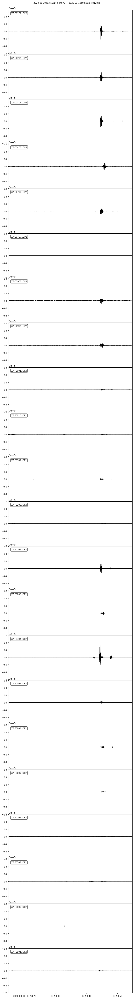

Peak height = 0.910895
Prominence = 0.420514
Width = 1376.196611
Width height = 0.700638
2020/03/10 04:00:28


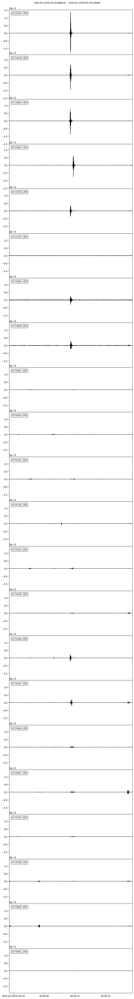

Peak height = 0.899472
Prominence = 0.404937
Width = 1419.793085
Width height = 0.697003
2020/03/10 04:03:35


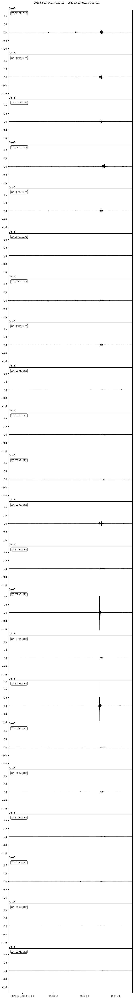

Peak height = 0.838246
Prominence = 0.352271
Width = 1273.992225
Width height = 0.662111
2020/03/10 04:04:52


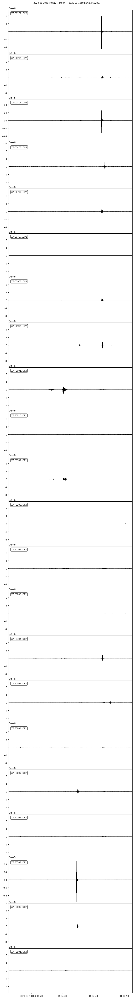

Peak height = 0.874942
Prominence = 0.343434
Width = 930.473424
Width height = 0.703225
2020/03/10 04:05:53


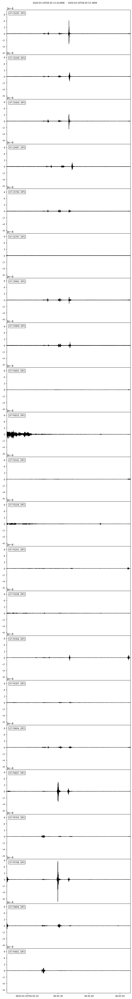

Peak height = 0.920953
Prominence = 0.351514
Width = 1268.665564
Width height = 0.745196
2020/03/10 04:06:18


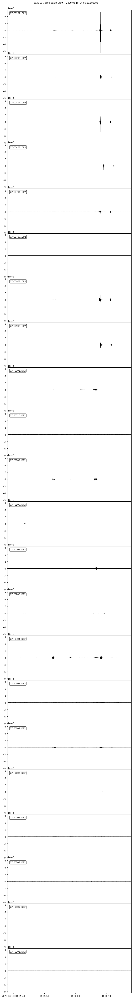

Peak height = 0.941651
Prominence = 0.424201
Width = 1289.614622
Width height = 0.729550
2020/03/10 04:10:26


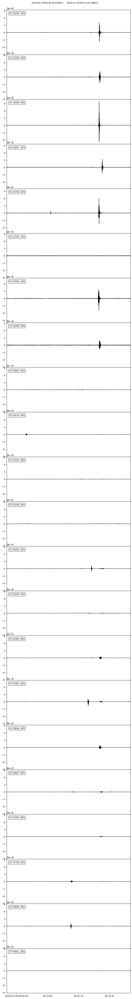

Peak height = 0.870949
Prominence = 0.325270
Width = 1416.591928
Width height = 0.708314
2020/03/10 04:13:51


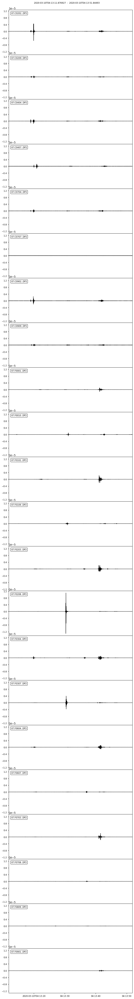

Peak height = 0.862807
Prominence = 0.322421
Width = 1253.311756
Width height = 0.701596
2020/03/10 04:15:17


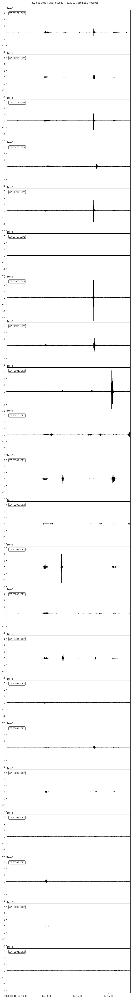

Peak height = 0.923846
Prominence = 0.382354
Width = 1272.599576
Width height = 0.732669
2020/03/10 04:20:28


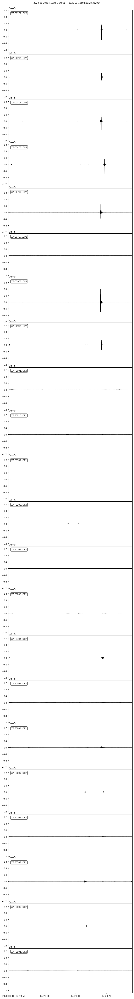

Peak height = 0.943167
Prominence = 0.405918
Width = 1264.701671
Width height = 0.740208
2020/03/10 04:23:14


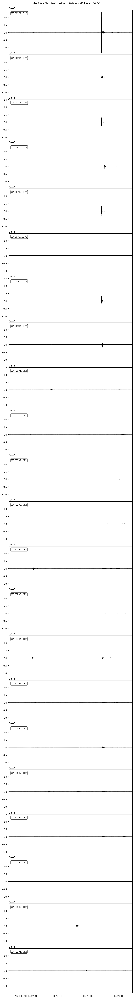

Peak height = 0.907848
Prominence = 0.327014
Width = 1276.491197
Width height = 0.744341
2020/03/10 04:27:22


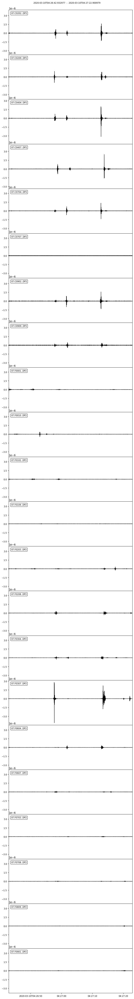

Peak height = 0.955306
Prominence = 0.449385
Width = 1286.294983
Width height = 0.730614
2020/03/10 04:32:42


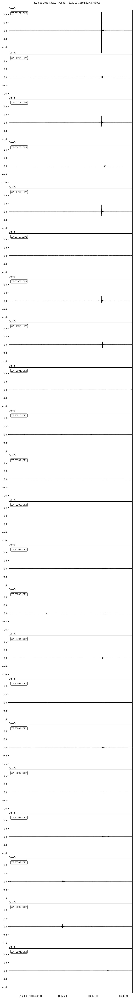

Peak height = 0.933800
Prominence = 0.339519
Width = 1270.296346
Width height = 0.764041
2020/03/10 04:36:25


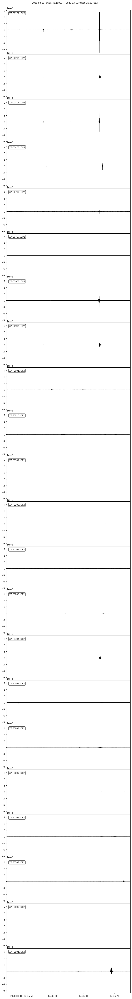

Peak height = 0.940340
Prominence = 0.409712
Width = 1284.141785
Width height = 0.735484
2020/03/10 04:36:53


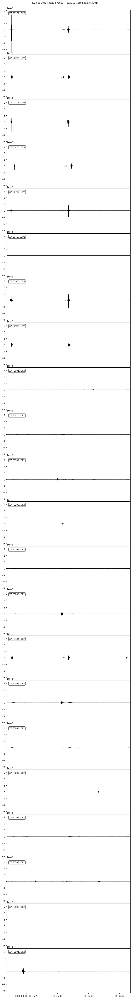

Peak height = 0.913125
Prominence = 0.394127
Width = 1434.919646
Width height = 0.716061
2020/03/10 04:38:59


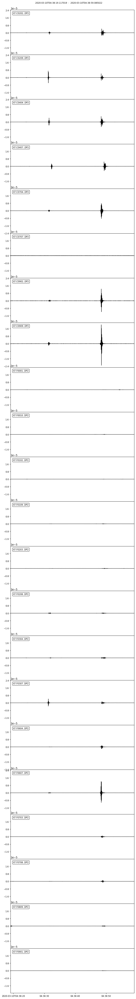

Peak height = 0.880813
Prominence = 0.359187
Width = 1375.622314
Width height = 0.701219
2020/03/10 04:42:37


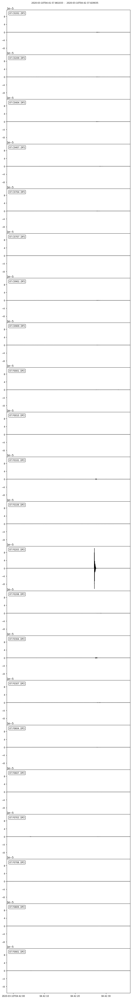

Peak height = 0.914792
Prominence = 0.314794
Width = 1431.284827
Width height = 0.757395
2020/03/10 04:44:20


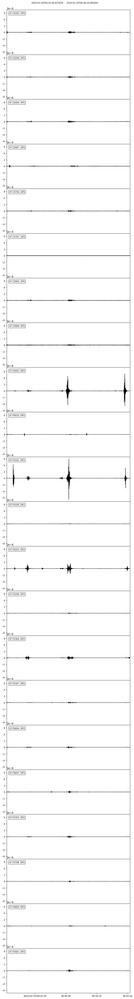

Peak height = 0.940010
Prominence = 0.411087
Width = 1288.357075
Width height = 0.734467
2020/03/10 04:46:02


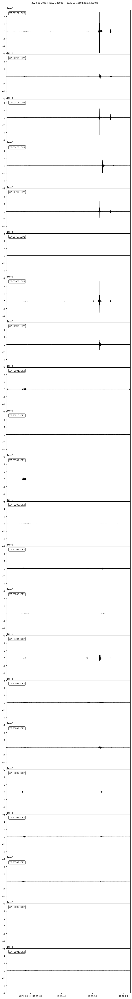

Peak height = 0.966023
Prominence = 0.457300
Width = 1362.480032
Width height = 0.737373
2020/03/10 04:48:00


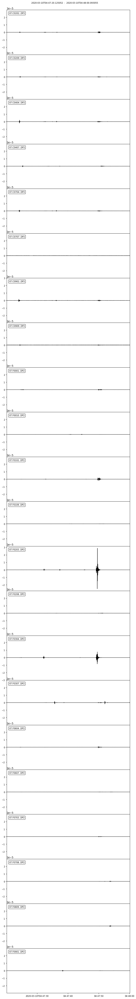

Peak height = 0.880781
Prominence = 0.340928
Width = 1476.782888
Width height = 0.710317
2020/03/10 04:54:28


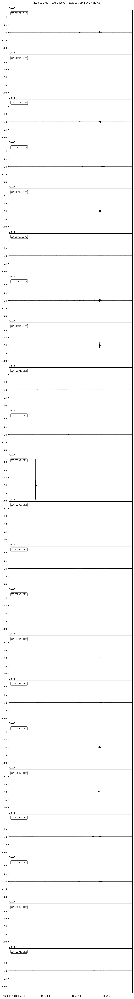

Peak height = 0.929180
Prominence = 0.331570
Width = 1307.818612
Width height = 0.763395
2020/03/10 04:56:42


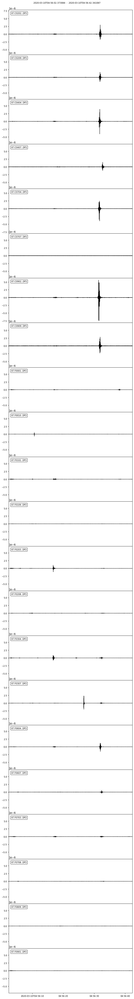

Peak height = 0.937487
Prominence = 0.407410
Width = 1277.344959
Width height = 0.733782
2020/03/10 04:58:00


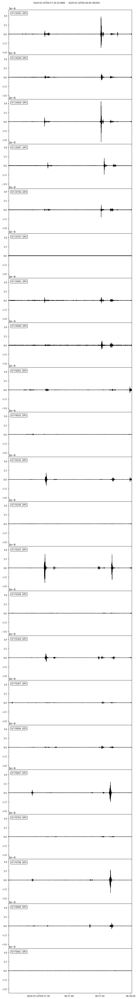

Peak height = 0.904528
Prominence = 0.342491
Width = 1289.861915
Width height = 0.733283
2020/03/10 04:59:09


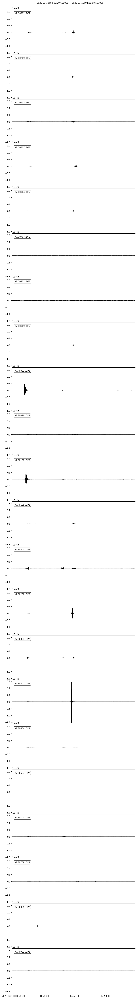

Peak height = 0.991197
Prominence = 0.664413
Width = 1475.362268
Width height = 0.658990
2020/03/10 05:01:44


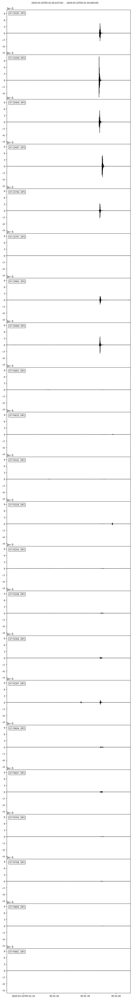

Peak height = 0.934431
Prominence = 0.354272
Width = 1309.809531
Width height = 0.757295
2020/03/10 05:03:03


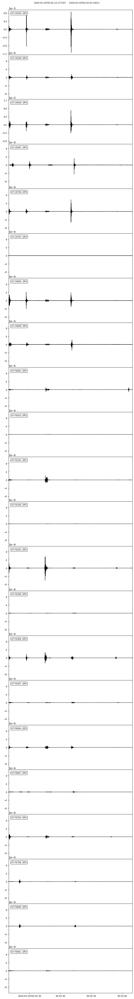

Peak height = 0.909811
Prominence = 0.392929
Width = 1281.155291
Width height = 0.713346
2020/03/10 05:08:21


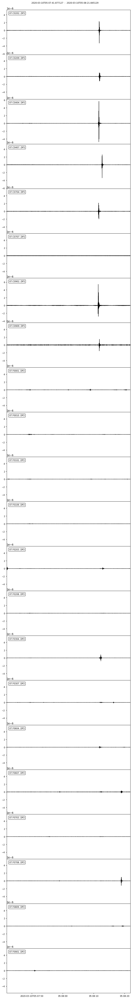

Peak height = 0.864031
Prominence = 0.303256
Width = 1311.816204
Width height = 0.712403
2020/03/10 05:11:19


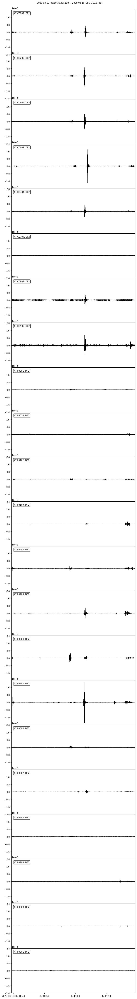

Peak height = 0.943289
Prominence = 0.403853
Width = 1327.927574
Width height = 0.741363
2020/03/10 05:14:33


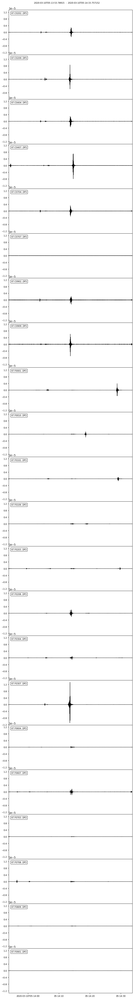

Peak height = 0.951222
Prominence = 0.435591
Width = 1301.558918
Width height = 0.733426
2020/03/10 05:18:17


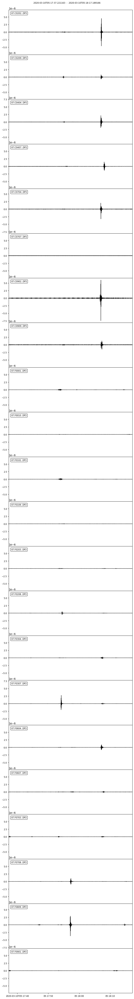

Peak height = 0.900779
Prominence = 0.382972
Width = 1271.757221
Width height = 0.709293
2020/03/10 05:22:52


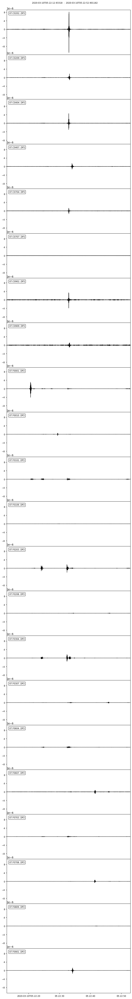

Peak height = 0.930542
Prominence = 0.408597
Width = 1368.397633
Width height = 0.726244
2020/03/10 05:29:58


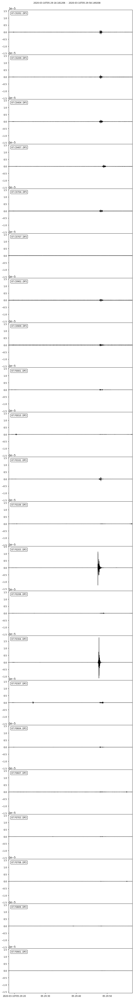

Peak height = 0.924012
Prominence = 0.319493
Width = 75.280187
Width height = 0.764266
2020/03/10 05:30:46


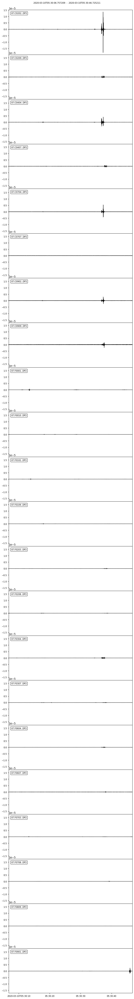

Peak height = 0.895002
Prominence = 0.338895
Width = 1000.587944
Width height = 0.725554
2020/03/10 05:37:01


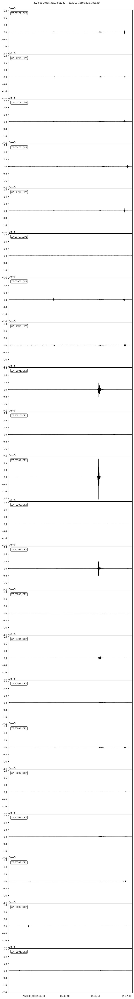

Peak height = 0.938492
Prominence = 0.394334
Width = 1272.981942
Width height = 0.741325
2020/03/10 05:40:50


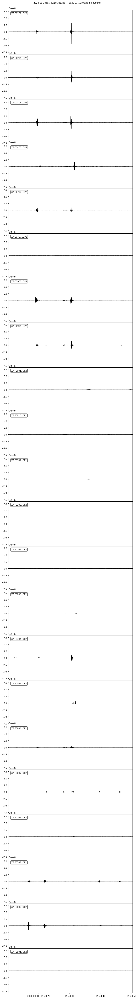

Peak height = 0.914222
Prominence = 0.345291
Width = 1310.979929
Width height = 0.741576
2020/03/10 05:43:25


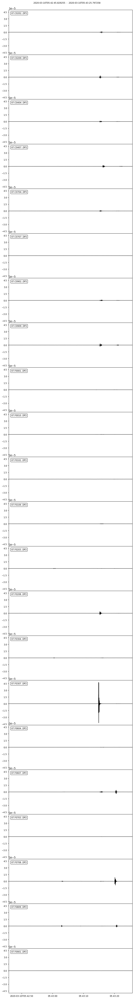

Peak height = 0.955594
Prominence = 0.444954
Width = 1280.179140
Width height = 0.733117
2020/03/10 05:47:52


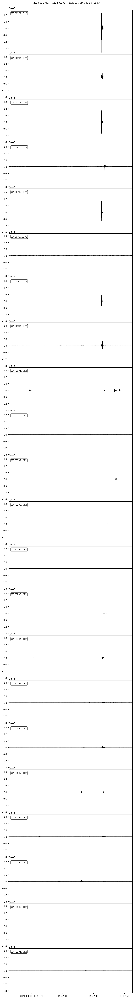

Peak height = 0.908194
Prominence = 0.340674
Width = 1264.283707
Width height = 0.737857
2020/03/10 05:53:27


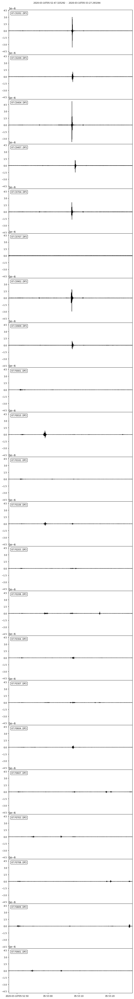

Peak height = 0.875969
Prominence = 0.319644
Width = 1303.211952
Width height = 0.716147
2020/03/10 05:56:31


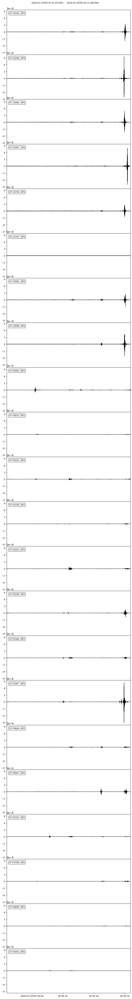

Peak height = 0.949505
Prominence = 0.402926
Width = 1327.110463
Width height = 0.748042
2020/03/10 05:56:44


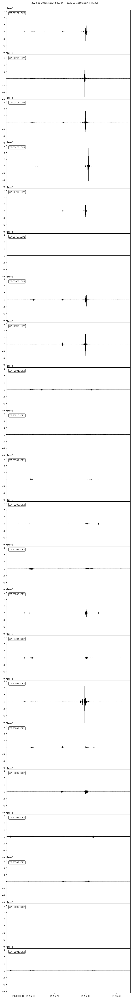

Peak height = 0.915995
Prominence = 0.369326
Width = 1341.506496
Width height = 0.731333
2020/03/10 05:57:24


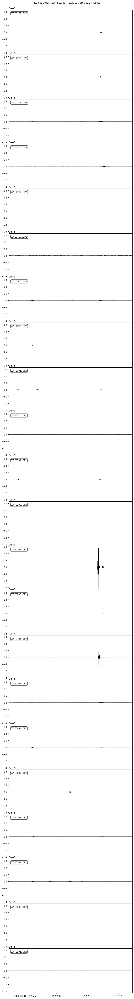

Peak height = 0.900353
Prominence = 0.319486
Width = 1248.978545
Width height = 0.740610
2020/03/10 06:10:15


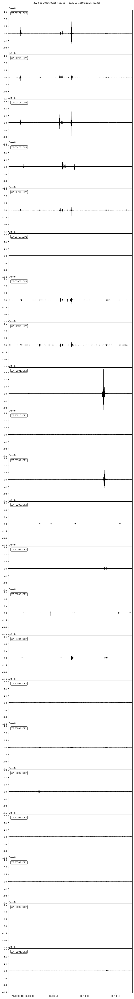

Peak height = 0.905757
Prominence = 0.348786
Width = 1245.384223
Width height = 0.731364
2020/03/10 06:16:07


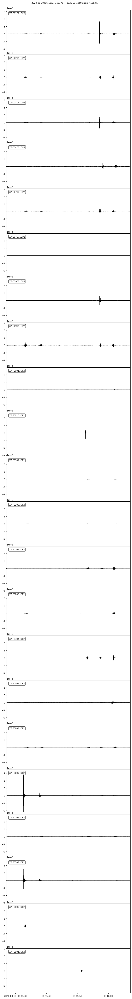

Peak height = 0.933265
Prominence = 0.343514
Width = 1288.665422
Width height = 0.761508
2020/03/10 06:28:27


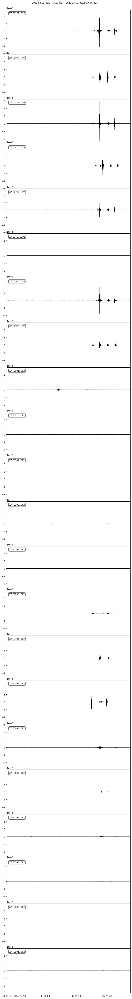

Peak height = 0.951242
Prominence = 0.423436
Width = 1301.201406
Width height = 0.739524
2020/03/10 06:31:48


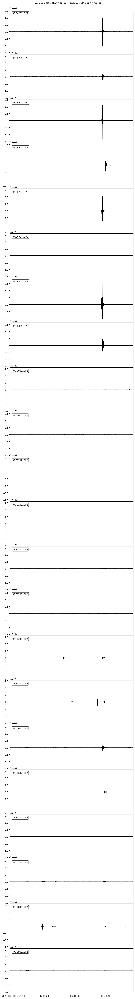

Peak height = 0.911978
Prominence = 0.344233
Width = 1317.062463
Width height = 0.739861
2020/03/10 06:45:38


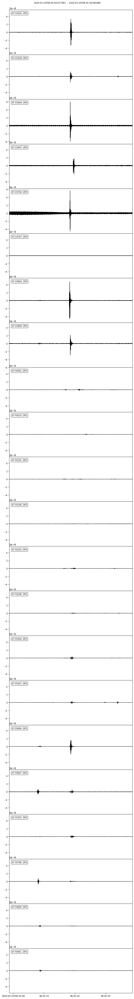

Peak height = 0.942907
Prominence = 0.386532
Width = 1279.696920
Width height = 0.749641
2020/03/10 06:47:02


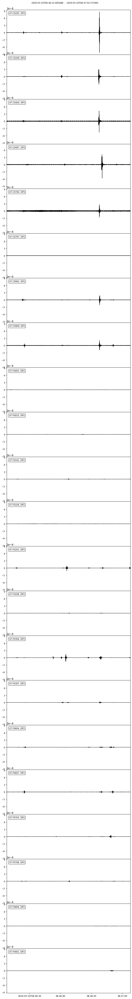

Peak height = 0.946426
Prominence = 0.426581
Width = 1292.184254
Width height = 0.733135
2020/03/10 06:51:30


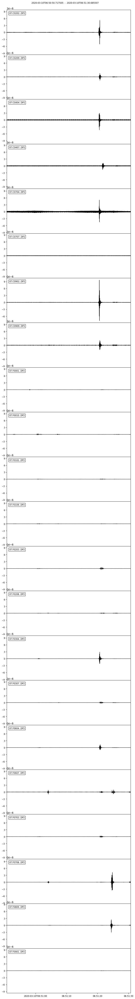

Peak height = 0.948465
Prominence = 0.383236
Width = 1312.302420
Width height = 0.756847
2020/03/10 06:54:25


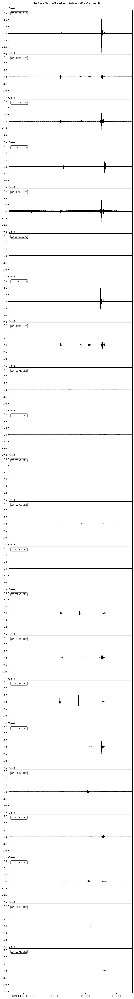

Peak height = 0.964115
Prominence = 0.457770
Width = 1273.160020
Width height = 0.735230
2020/03/10 06:55:49


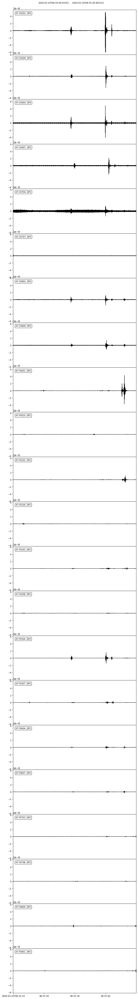

Peak height = 0.921266
Prominence = 0.370530
Width = 1371.215076
Width height = 0.736001
2020/03/10 06:58:02


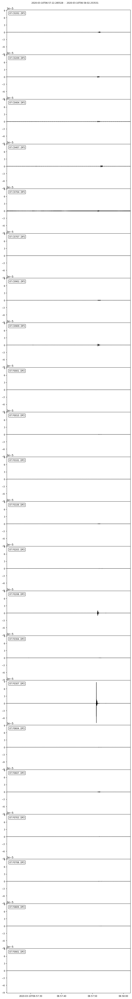

Peak height = 0.931154
Prominence = 0.395664
Width = 1370.138821
Width height = 0.733322
2020/03/10 07:05:33


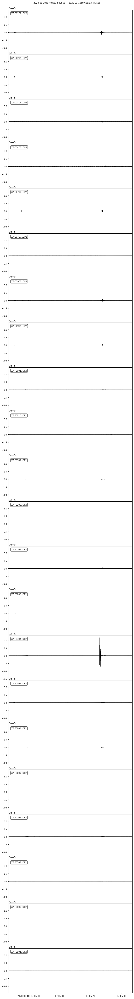

Peak height = 0.897995
Prominence = 0.367452
Width = 1391.043986
Width height = 0.714269
2020/03/10 07:22:15


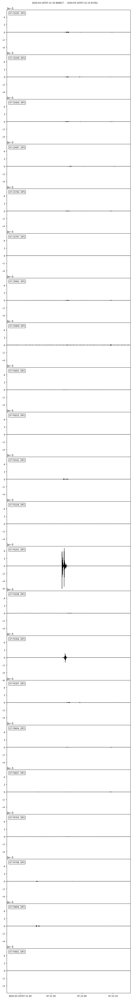

Peak height = 0.951578
Prominence = 0.455877
Width = 1351.480640
Width height = 0.723640
2020/03/10 07:26:04


KeyboardInterrupt: 

In [136]:
t0 = UTCDateTime(2020,3,9,0,0,0)
wf_dir = "/home/gilbert_lab/cami_frs/hawk_data/sac_data_corrected/Jan-Feb2020_sac_daily_250Hz/"
for idx in range(0,len(peaks)):
    print("Peak height = %f" % properties["peak_heights"][idx])
    print("Prominence = %f" % properties["prominences"][idx])
    print("Width = %f" % properties["widths"][idx])
    print("Width height = %f" % properties["width_heights"][idx])
    ips = peaks[idx] - sublen_samp*2
    ipe = peaks[idx] + sublen_samp*2
    ts = t0 + ips/fs 
    te = t0 + ipe/fs 
    print(te.strftime("%Y/%m/%d %H:%M:%S"))
    st = read(os.path.join(wf_dir,"*","*DP2*%s*" % ts.strftime("%Y%m%d")), starttime=ts, endtime=te)
    st.filter("bandpass", freqmin=10, freqmax=60)
    st.plot()